# New York City AirBnB Price Prediction

## Reading in the data *

In [ ]:
# Will import libraries along the way
import pandas as pd

In [ ]:
airdata = pd.read_csv("AB_NYC_2019.csv")

Let's have a look at the data.*

In [ ]:
airdata.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


Summary statistics of the data.*

In [ ]:
airdata.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,48895,NaN,NaN,NaN,1.90171e+07,1.09831e+07,2539,9.47194e+06,1.96773e+07,2.91522e+07,3.64872e+07
name,48879,47905,Hillside Hotel,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_id,48895,NaN,NaN,NaN,6.762e+07,7.8611e+07,2438,7.82203e+06,3.07938e+07,1.07434e+08,2.74321e+08
host_name,48874,11452,Michael,417,NaN,NaN,NaN,NaN,NaN,NaN,NaN
neighbourhood_group,48895,5,Manhattan,21661,NaN,NaN,NaN,NaN,NaN,NaN,NaN
neighbourhood,48895,221,Williamsburg,3920,NaN,NaN,NaN,NaN,NaN,NaN,NaN
latitude,48895,NaN,NaN,NaN,40.7289,0.0545301,40.4998,40.6901,40.7231,40.7631,40.9131
longitude,48895,NaN,NaN,NaN,-73.9522,0.0461567,-74.2444,-73.9831,-73.9557,-73.9363,-73.713
room_type,48895,3,Entire home/apt,25409,NaN,NaN,NaN,NaN,NaN,NaN,NaN
price,48895,NaN,NaN,NaN,152.721,240.154,0,69,106,175,10000


The id, name, host_id and host_name are unique identifiers which we will remove after some EDA since host_id repeats and it might come in to use for engineering some feature\s. Apart from that there are 7 numerical variables, 3 categorical variables and a temporal variable. The target variable 'price' is numerical as well.

The total number of rows in the data is 48,895. The columns that have null values are name, host_id, host_name, last_review and reviews_per_month.

In [ ]:
airdata.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

We can see, that the host_id repeats, so this means a host can have multiple listings.

In [ ]:
airdata.groupby('host_id').size()

host_id
2438         1
2571         1
2787         6
2845         2
2868         1
            ..
274273284    1
274298453    1
274307600    1
274311461    1
274321313    1
Length: 37457, dtype: int64

In [ ]:
airdata[airdata['host_id'].isin([2845])]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
22728,18393354,Midtown Sanctuary,2845,Jennifer,Manhattan,Midtown,40.75358,-73.99190,Shared room,99,1,1,2018-07-18,0.08,2,365


We could have created a feature which stated how many listings a host have, but apparently, this feature already exists as 'calculated_host_listings_count'. So we can now remove the identifier columns safely. We will keep name, because we might be able to generate a feature from it.

In [ ]:
airdata = airdata.drop(['id', 'host_id', 'host_name'], axis= 1)
airdata.columns

Index(['name', 'neighbourhood_group', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'price', 'minimum_nights', 'number_of_reviews',
       'last_review', 'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

We will also be dropping the 'latitude' and 'longitude' for now. This will come to use later on.

In [ ]:
airdata = airdata.drop(['latitude', 'longitude'], axis= 1)
airdata.columns

Index(['name', 'neighbourhood_group', 'neighbourhood', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

We will drop the rows which have NULL values in the column 'name' since the count of rows is small.

In [ ]:
airdata = airdata[~airdata['name'].isnull()]

We will also drop those rows which have price of exactly or smaller than 0 since that is an invalid price.

In [ ]:
airdata = airdata[airdata['price'] > 0]

## Exploratory Data Analysis

Let's visualize the data.*

In [ ]:
import seaborn as sns

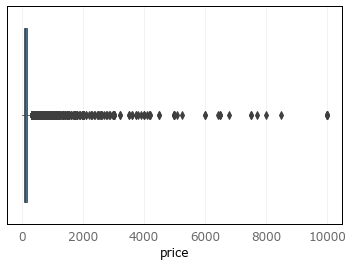

In [ ]:
sns.boxplot(x= airdata['price'], showfliers= True)

In [ ]:
airdata['price'].max()

10000

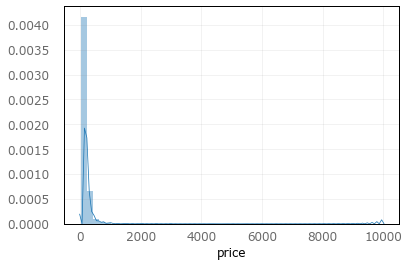

In [ ]:
sns.distplot(airdata['price'])

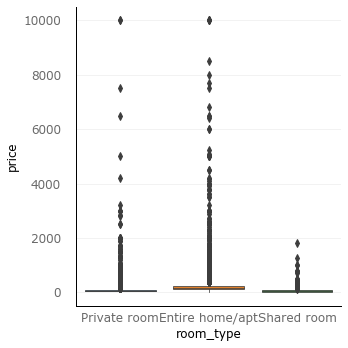

In [ ]:
sns.catplot(x= 'room_type', y= 'price', kind= 'box', data= airdata, showfliers= True)

As we can see, the price variable is quite heavily positively skewed.

The number of shared room listings are quite less than the other two types of room.
The prices for each room types are as shown above. We can see how the price range varies along the scale, but with the majority listing prices being in the lower region.

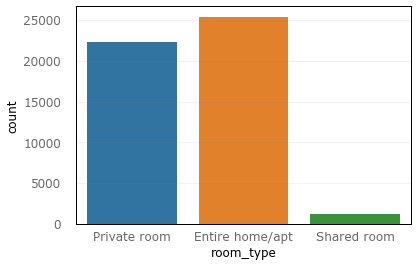

In [ ]:
sns.countplot(airdata['room_type'])

Let's see how many observations exactly are out of the actual distribution by applying the Interquartile Range Outlier rule.

In [ ]:
IQR = airdata['price'].quantile(0.75) - airdata['price'].quantile(0.25)
upperLimit = airdata['price'].quantile(0.75) + (1.5 * IQR)
upperLimit

334.0

In [ ]:
len(airdata[airdata['price'] > upperLimit])

2971

Using the IQR rule, around 6% of the rows are being identified as outliers.

If we were to remove these outliers, let's see what difference would it make to our distributions.*

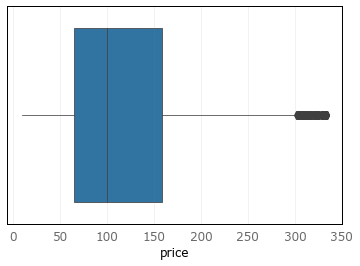

In [ ]:
sns.boxplot(airdata[airdata['price'] <= upperLimit]['price'], showfliers= True)

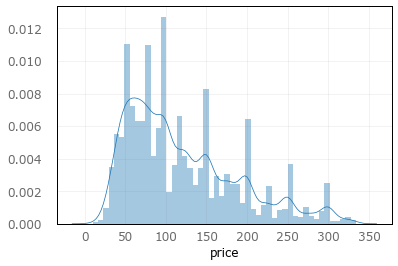

In [ ]:
sns.distplot(airdata[airdata['price'] <= upperLimit]['price'])

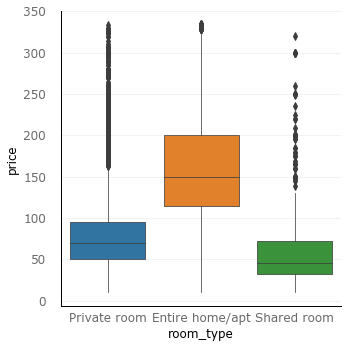

In [ ]:
sns.catplot(x= 'room_type', y= 'price', kind= 'box', data= airdata[airdata['price'] <= upperLimit])

The distribution seems very well defined now than before, yet still slightly positively skewed. And since the percentage of outliers is small, we will go ahead and remove these from the data.

In [ ]:
print('Number of rows with outliers: ', len(airdata))
airdata = airdata[airdata['price'] <= upperLimit].copy()
print('Number of rows without outliers: ', len(airdata))

Number of rows with outliers:  48868
Number of rows without outliers:  45897


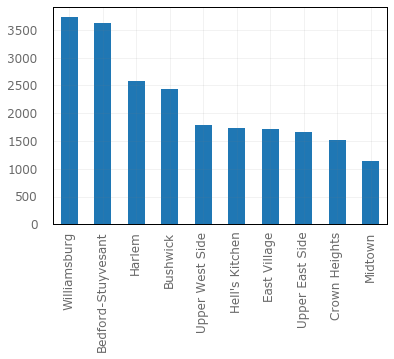

In [ ]:
airdata['neighbourhood'].value_counts().head(10).plot(kind= 'bar')

The top 10 neighbourhoods listings seems to be evenly distributed. Also as seen below, the 'neighbourhood' is a high cardinality column. We will use categorical embeddings to normalize this later on.

In [ ]:
len(airdata['neighbourhood'].unique())

219

Since neighbourhood_group is just a broader category of neighbourhood, we will go ahead and drop it.

In [ ]:
airdata['neighbourhood_group'].unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [ ]:
airdata = airdata.drop('neighbourhood_group', axis= 1)

Now let's examine 'minimum_nights' and 'number_of_reviews'.

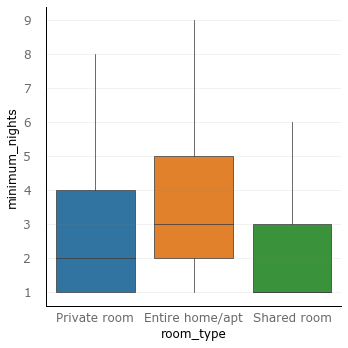

In [ ]:
sns.catplot(x= 'room_type', y= 'minimum_nights', kind= 'box', data= airdata)

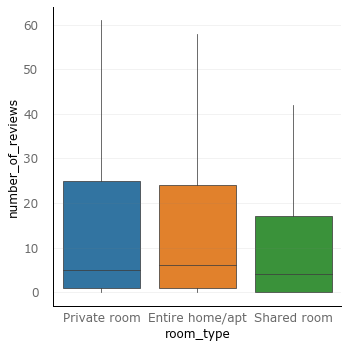

In [ ]:
sns.catplot(x= 'room_type', y= 'number_of_reviews', kind= 'box', data= airdata)

The distribution here seems to be quite skewed as well for both of the variables, we will scale these variables later on.

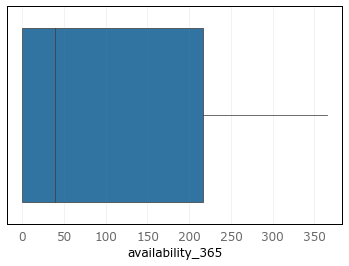

In [ ]:
sns.boxplot(airdata['availability_365'])

## Data Preprocessing

We will now work on extracting and\or transforming features from the data.

We will try to extract some information out of the listing name variable. But before that we need to clean it first.*

In [ ]:
airdata['name'].head(10)

0                  Clean & quiet apt home by the park
1                               Skylit Midtown Castle
2                 THE VILLAGE OF HARLEM....NEW YORK !
3                     Cozy Entire Floor of Brownstone
4    Entire Apt: Spacious Studio/Loft by central park
5           Large Cozy 1 BR Apartment In Midtown East
6                                     BlissArtsSpace!
7                    Large Furnished Room Near B'way 
8                  Cozy Clean Guest Room - Family Apt
9                  Cute & Cozy Lower East Side 1 bdrm
Name: name, dtype: object

In [ ]:
airdata['name'] = airdata['name'].str.lower() # Convert to lowercase
airdata['name'] = airdata['name'].str.replace("[^0-9a-zA-Z]+", " ") # Remove special characters
airdata['name'] = airdata['name'].str.replace("\s{2,}", " ").str.strip() # Remove extra, leading and trailing spaces

In [ ]:
airdata['name'].head(10)

0                   clean quiet apt home by the park
1                              skylit midtown castle
2                     the village of harlem new york
3                    cozy entire floor of brownstone
4    entire apt spacious studio loft by central park
5          large cozy 1 br apartment in midtown east
6                                     blissartsspace
7                    large furnished room near b way
8                   cozy clean guest room family apt
9                   cute cozy lower east side 1 bdrm
Name: name, dtype: object

The idea is to extract adjectives from the text, since having adjectives i.e. the words that describes the place, in the listing name can increase traction and consequently can affect the price.*

In [ ]:
import spacy

nlp = spacy.load('en_core_web_lg')

def get_adjectives(text):
    result = []
    pos_tag = ['ADJ']
    doc = nlp(text)
    for token in doc:
        if(token.pos_ in pos_tag):
            result.append(token.text)
    return result

The above function tokenizes the text data and extract adjectives from it. We are going to apply this over the listing name variable in the dataframe

In [ ]:
airdata['adjectives_used'] = airdata['name'].apply(get_adjectives)

In [ ]:
airdata[['name', 'adjectives_used']].sample(10)

,name,adjectives_used
9348,clinton hill apartment,[]
14282,nyc legal 2br parking metro 4min jfk 15min,"[legal, 2br]"
29688,sexy grand central modern chic brand new park ave,"[sexy, grand, central, modern, new]"
7760,beautiful one bedroom apartment near central park,"[beautiful, central]"
3377,charming bedroom on the upper west,[charming]
8212,trendy newly renovated 1 bd apt,[]
4588,w burg brooklyn sunny spacious private,[private]
43121,cozy shared room in the middle of manhattan,[]
4087,incredible 2 br w kitchen island,[incredible]
29131,bedroom in lovely and welcoming home,[lovely]


Since we do not need the actual words, we are just going to count and store the number of adjectives for each row.

In [ ]:
airdata['adjectives_used'] = airdata['adjectives_used'].str.len()

Since, the listing name is just a short text, and so, to avoid the bias towards listings having frequent adjectives, we will binarize the 'adjectives_used' column.

In [ ]:
airdata.loc[airdata['adjectives_used'] > 0, 'adjectives_used'] = 1

In [ ]:
airdata[['name', 'adjectives_used']].sample(10)

,name,adjectives_used
2270,verna s brownstone no stove no gatherings,0
32891,intimate studio in fidi by sonder,1
4282,charming bedroom in renovated apart,1
37543,comfortable artistic brooklyn apartment,1
16345,beautiful garden level apartment in brooklyn,1
22306,warm cozy green house,1
45046,large ues studio central park close 1 bk to q sub,1
46227,3,0
1695,studio in chelsea,0
31172,sunny brooklyn home away from home,0


In [ ]:
airdata = airdata.drop('name', axis= 1) # Since its no longer needed

As seen before, there were NULL values in the last_review and review_per_month columns. And we can not remove these rows, since they are significant in number.

In [ ]:
airdata[airdata['last_review'].isnull()][['last_review', 'reviews_per_month']].head()

,last_review,reviews_per_month
2,NaN,NaN
19,NaN,NaN
26,NaN,NaN
36,NaN,NaN
38,NaN,NaN


This means, the listings that never got any review have these NULL values. We can easily convert reviews_per_month NULL values to 0, but this won't work for the last_review, since it is a date column. For this we need to generate a feature using this column.*

In [ ]:
airdata.loc[airdata['reviews_per_month'].isnull(), 'reviews_per_month'] = 0

We will create a 'Recency' feature from the last_review date column, which will be a score from 1-10, representing the recency of reviews posted for each listing, ranking from least to most recent, respectively. A value of 0 will represent that it was not reviewed at all.

In [ ]:
airdata['last_review'] = pd.to_datetime(airdata['last_review'], format= '%Y-%m-%d')

In [ ]:
airdata['last_review'] = (airdata['last_review'].max() - airdata['last_review']).dt.days

In [ ]:
airdata['last_review'].head()

0    262.0
1     48.0
2      NaN
3      3.0
4    231.0
Name: last_review, dtype: float64

In [ ]:
airdata['review_recency'] = pd.qcut(airdata['last_review'], q= 10, labels= range(10,0,-1)).astype(float)

In [ ]:
airdata[['last_review', 'review_recency']].sample(10)

,last_review,review_recency
40515,36.0,6.0
36177,274.0,4.0
4294,15.0,8.0
31953,388.0,3.0
11938,NaN,NaN
16239,1112.0,1.0
37571,8.0,9.0
21253,18.0,8.0
15041,NaN,NaN
44562,28.0,7.0


So, the bigger the difference is from the maximum date of the review, the lesser the score denoting the least recency of the review. Now we can replace the NULL values with 0, and drop the last_review column.

In [ ]:
airdata.loc[airdata['review_recency'].isnull(), 'review_recency'] = 0
airdata = airdata.drop(['last_review'], axis= 1)

## Correlation Testing

### Numeric Variables

We will use Pearson correlation testing for numeric variables to examine any strong correlation of variables with the target variable.*

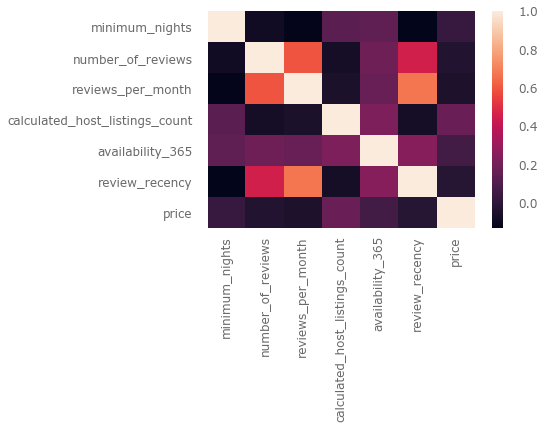

In [ ]:
sns.heatmap(airdata[['minimum_nights', 'number_of_reviews', 'reviews_per_month',
                    'calculated_host_listings_count', 'availability_365', 'review_recency', 'price']].corr())

There are no numerical variables which seem highly correlated to the target variable 'price'.

### Categorical Variables

We will use ANOVA One-way test for the categorical variables to find out any significant features correlated with the target variable.*

In [ ]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

mod = ols('price ~ neighbourhood', data=airdata).fit()

aov_table = sm.stats.anova_lm(mod, typ=2)
print(aov_table)

                     sum_sq       df          F  PR(>F)
neighbourhood  5.360597e+07    218.0  70.453042     0.0
Residual       1.594278e+08  45678.0        NaN     NaN


With the p-value so low, we can conclude that there is a significant difference in the means of different categories of the neighbourhood variable.

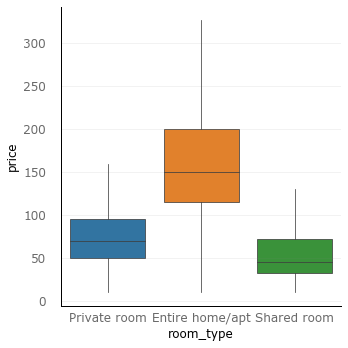

In [ ]:
sns.catplot(x= 'room_type', y= 'price', kind= 'box', data= airdata)

In [ ]:
mod = ols('price ~ room_type', data=airdata).fit()

aov_table = sm.stats.anova_lm(mod, typ=2)
print(aov_table)

                 sum_sq       df             F  PR(>F)
room_type  8.225088e+07      2.0  14431.635956     0.0
Residual   1.307829e+08  45894.0           NaN     NaN


With the p-value so low, we can conclude that there is a significant difference in the means of different categories of the room_type variable.

## Train-Test Split & Data Scaling

We will log-transform the target variable to scale it.

In [ ]:
import numpy as np

airdata['price'] = np.log(airdata['price'])

Since room_type does not have many category values, we will one_hot encode the variable.

In [ ]:
airdata['room_type'].unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

In [ ]:
airdata = pd.concat([airdata, pd.get_dummies(airdata['room_type'], prefix= 'room_type')], axis= 1)

In [ ]:
airdata = airdata.drop('room_type', axis= 1)

Output the data transformed uptil now. This is to avoid wastage of time to run the above code again.

In [ ]:
#airdata.to_excel('bnb_transformed_data.xlsx', index= False)
#airdata = pd.read_excel('bnb_transformed_data.xlsx')

Now to split the data in to training and testing set with 80-20 ratio.*

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(airdata.drop('price', axis= 1),
                                                    airdata['price'], test_size=0.2, random_state=123)

Further split X_train and y_train (train data) in to train and validation set for hyper-parameter tuning process (90-10 ratio).

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=123)

Now to scale and normalize the features. We will use Min-max normalization on 'availability_365' and 'review_recency' because they have certain ranges predefined and Z-Score normalization on all of the other numerical variables.*

In [ ]:
from sklearn.preprocessing import StandardScaler

# Columns to be scaled
listCols_Scale = ['minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count']

sc = StandardScaler()

# Fit-transform the train data
X_train[listCols_Scale] = sc.fit_transform(X_train[listCols_Scale])

# Scale test and val data using mean and sd learned from train data
X_test[listCols_Scale] = sc.transform(X_test[listCols_Scale])
X_val[listCols_Scale] = sc.transform(X_val[listCols_Scale])

Something to note, that we have used the fit_transform function on the train data to get the mean and standard deviation and then transform only function on validation and test set to scale using the mean and sd learned from train data. We will do the same for Min-Max Normalization.

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Columns to be scaled
listCols_Norms = ['availability_365', 'review_recency']

mn = MinMaxScaler()

# Fit-transform the train data
X_train[listCols_Norms] = mn.fit_transform(X_train[listCols_Norms])

# Scale test and val data using min-max learned from train data
X_test[listCols_Norms] = mn.transform(X_test[listCols_Norms])
X_val[listCols_Norms] = mn.transform(X_val[listCols_Norms])

We are also going to encode the 'neighbourhood' variable, which will be used when we will apply categorical embedding on it.*

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Columns to be encoded
listCols_Enc = 'neighbourhood'

ec = LabelEncoder()

# Fit the encoder using all unique values
ec = ec.fit(airdata[listCols_Enc].unique())


X_train[listCols_Enc] = ec.transform(X_train[listCols_Enc])

X_test[listCols_Enc] = ec.transform(X_test[listCols_Enc])

X_val[listCols_Enc] = ec.transform(X_val[listCols_Enc])

## Model Building

We will use multiple models to predict the target variable 'price' from the data we have come up with.

### Neural Network with Categorical Embeddings

First, we will train a Multi-Layer Perceptron Neural Network model, while using the 'neighbourhood' categorical variable as an embedded vector.

In [ ]:
countCatg = len(ec.classes_)
countCatg

219

We have in total 11 features in the data, of which one is neighbourhood for which we will create a seperate embedding layer. The input size of that layer will be the number of categories in neighbourhood.

In [ ]:
len(X_train.columns)-1 # excluding neighbourhood

10

Jeremy Howard, a very well known practitioner of the idea of embedding, provides the following (guideline) formula to calculate embedding size of resulting vector.

> Embedding Size = min(50, Number of Categories/2).

Even though we are going to tune this parameter, we will use this formula to get an optimal estimate.


In [ ]:
def embedSize(countCat):
    return int(min(np.ceil((countCat)/2), 50))

In [ ]:
embeddingSize = embedSize(countCatg)
embeddingSize

50

Importing the libraries that will be needed. We will be using Keras Funtional API to design the network.

In [ ]:
from keras.layers import Input, Dense, Dropout
from keras.layers import Embedding, Flatten
from keras.layers import Concatenate
from keras.models import Model
from keras.utils import plot_model
from keras.optimizers import adam

import matplotlib.pyplot as plt

Now to build up the structure of the model.*

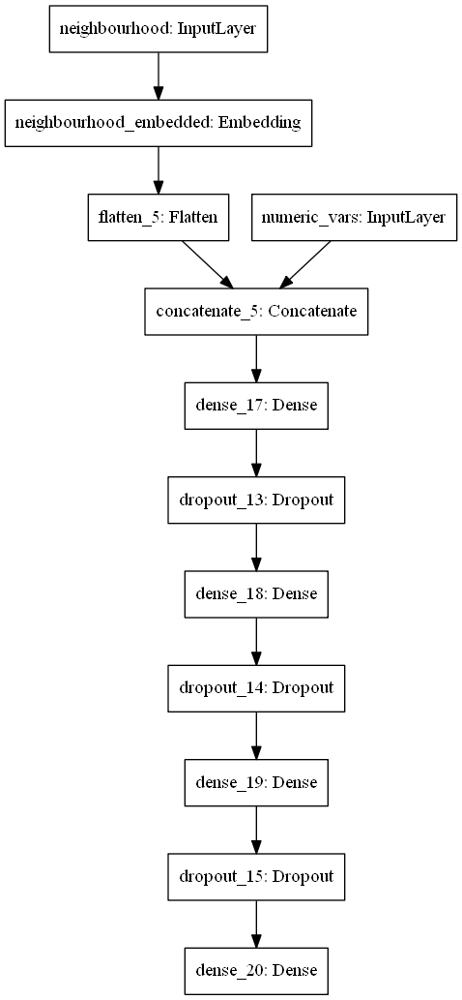

In [ ]:
# Model Definition

# Input layers, one for categorical, and one for other numerical variables
inputCategoric = Input(shape=(1,), name='neighbourhood')
inputNumeric = Input(shape=(10,), name='numeric_vars')

# Embedding layer, with input_dim + 1 for unknowns and the layer flattened afterwards
embLayer = Embedding(output_dim= embeddingSize, input_dim= countCatg + 1,
                     input_length= 1, name= 'neighbourhood_embedded')(inputCategoric)
embLayer = Flatten()(embLayer)

# Concatenating the embedded and numerical input layers
conc = Concatenate()([inputNumeric, embLayer])

# Adding more layers
dense1 = Dense(units= 200, activation= 'relu')(conc)
drop1 = Dropout(rate= 0.3)(dense1)
dense2 = Dense(units= 100, activation= 'relu')(drop1)
drop2 = Dropout(rate= 0.1)(dense2)
dense3 = Dense(units= 50, activation= 'relu')(drop2)
drop3 = Dropout(rate= 0.1)(dense3)
denseOut = Dense(units= 1)(drop3)

# Instantiate model
model = Model(inputs= [inputNumeric, inputCategoric], outputs= [denseOut])

#model.summary()
plot_model(model, to_file= 'NN_Viz.png')

With the model been defined, we now need to define multiple hyperparameters and tune the model using the combination of them to find the hyperparameters that yield best results.*

In [ ]:
input_X_train = [X_train.drop('neighbourhood', axis= 1), X_train['neighbourhood']]
input_X_val = [X_val.drop('neighbourhood', axis= 1), X_val['neighbourhood']]
input_X_test = [X_test.drop('neighbourhood', axis= 1), X_test['neighbourhood']]

In [ ]:
def mlp_nn(X_train_nn, y_train_nn, X_val_nn, y_val_nn, params):

    # Model Definition

    # Input layers, one for categorical, and one for other numerical variables
    inputCategoric = Input(shape=(1,), name='neighbourhood')
    inputNumeric = Input(shape=(10,), name='numeric_vars')

    # Embedding layer, with input_dim + 1 for unknowns and the layer flattened afterwards
    embLayer = Embedding(output_dim= params['embedding_size'], input_dim= countCatg + 1,
                         input_length= 1, name= 'neighbourhood_embedded')(inputCategoric)
    embLayer = Flatten()(embLayer)

    # Concatenating the embedded and numerical input layers
    conc = Concatenate()([inputNumeric, embLayer])

    # Adding more layers
    dense1 = Dense(units= params['dense1_units'], activation= params['activation_func'])(conc)
    drop1 = Dropout(rate= params['drop1_rate'])(dense1)
    dense2 = Dense(units= params['dense2_units'], activation= params['activation_func'])(drop1)
    drop2 = Dropout(rate= params['drop2_rate'])(dense2)
    dense3 = Dense(units= params['dense3_units'], activation= params['activation_func'])(drop2)
    drop3 = Dropout(rate= params['drop3_rate'])(dense3)
    denseOut = Dense(units= 1)(drop3)

    # Instantiate model
    model = Model(inputs= [inputNumeric, inputCategoric], outputs= [denseOut])

    # Compile the model
    model.compile(loss='mse', optimizer= adam(learning_rate= params['learning_rate']))

    # Fit the data on the model
    history = model.fit(x= X_train_nn, y= y_train_nn,
                    epochs= params['epochs'], batch_size= params['batch_size'],
                   validation_data=[X_val_nn, y_val_nn])

    return history, model

In [ ]:
params = {'embedding_size' : [embeddingSize, embeddingSize+20, embeddingSize-20],
          'dense1_units' : [400, 300, 200],
          'dense2_units' : [200, 100, 50],
          'dense3_units' : [75, 50, 20],
          'drop1_rate' : [0.3, 0.4, 0.5],
          'drop2_rate' : [0.3, 0.4, 0.5],
          'drop3_rate' : [0.2, 0.1, 0.05],
          'activation_func' : ['relu', 'sigmoid', 'tanh'],
          'learning_rate' : [0.01, 0.05, 0.001, 0.0001],
          'batch_size' : [150, 300, 600],
          'epochs' : [50, 100, 200]
         }

Now we will execute tuning runs using the package talos with a random parameter sampling rate of 0.001.

In [ ]:
import talos

runs = talos.Scan(x= input_X_train,
                  y= y_train,
                  model= mlp_nn,
                  fraction_limit=0.001,
                  params= params,
                  x_val= input_X_val,
                  y_val= y_val,
                  seed = 123,
                  experiment_name= 'TuningRun'
                 )




  0%|                                                                                          | 0/236 [00:00<?, ?it/s]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 29us/step - loss: 9.3507 - val_loss: 1.4912
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.7681 - val_loss: 1.0241
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5134 - val_loss: 0.6543
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3645 - val_loss: 0.4099
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3093 - val_loss: 0.4579
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2553 - val_loss: 0.4779
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2267 - val_loss: 0.3449
Epoch 8/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2077 - val_loss: 0.3484
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.1970 - val_loss: 0.2909
Epoch 




  0%|▎                                                                               | 1/236 [00:28<1:53:18, 28.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 0.4097 - val_loss: 0.1451
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.1837 - val_loss: 0.1367
Epoch 3/50
33045/33045 [==============================] - 1s 32us/step - loss: 0.1734 - val_loss: 0.1338
Epoch 4/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.1684 - val_loss: 0.1349
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1678 - val_loss: 0.1359
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1657 - val_loss: 0.1335
Epoch 7/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1794 - val_loss: 0.1345
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1696 - val_loss: 0.1351
Epoch 9/50
33045/33045 [==============================] - 1s 33us/step - loss: 0.1687 - val_loss: 0.1463
Epoch 




  1%|▋                                                                               | 2/236 [01:22<2:21:48, 36.36s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 10.1856 - val_loss: 1.0800
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.1542 - val_loss: 0.6105
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.7789 - val_loss: 0.4470
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.6257 - val_loss: 0.3459
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.5353 - val_loss: 0.2695
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4736 - val_loss: 0.2484
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4356 - val_loss: 0.2156
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.4118 - val_loss: 0.2016
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3914 - val_loss: 0.1955
Epoch




  1%|█                                                                               | 3/236 [01:49<2:09:49, 33.43s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 19us/step - loss: 1.0316 - val_loss: 0.1483
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2297 - val_loss: 0.1444
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2138 - val_loss: 0.1419
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2045 - val_loss: 0.1475
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1936 - val_loss: 0.1389
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1861 - val_loss: 0.1363
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1787 - val_loss: 0.1355
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1765 - val_loss: 0.1351
Epoch 9/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1725 - val_loss: 0.1386
Ep

33045/33045 [==============================] - 0s 10us/step - loss: 0.1355 - val_loss: 0.1301
Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1350 - val_loss: 0.1284
Epoch 155/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1341 - val_loss: 0.1282
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1349 - val_loss: 0.1338
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1357 - val_loss: 0.1300
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1332 - val_loss: 0.1299
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1341 - val_loss: 0.1289
Epoch 160/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1341 - val_loss: 0.1315
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1343 - val_loss: 0.1302
Epoch 162/200
33045/33045 [======================




  2%|█▎                                                                              | 4/236 [02:54<2:45:48, 42.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 24us/step - loss: 1.5009 - val_loss: 0.2160
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4265 - val_loss: 0.1898
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3828 - val_loss: 0.1946
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3501 - val_loss: 0.1810
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3290 - val_loss: 0.1659
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3087 - val_loss: 0.1821
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2907 - val_loss: 0.1845
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.2726 - val_loss: 0.1593
Epoch 9/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.2613 - val_loss: 0.1406
Epoch 




  2%|█▋                                                                              | 5/236 [03:22<2:28:05, 38.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 27us/step - loss: 33.5798 - val_loss: 0.6366
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.2762 - val_loss: 0.4041
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.8485 - val_loss: 0.5309
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.6701 - val_loss: 0.3432
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6860 - val_loss: 0.7063
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4965 - val_loss: 0.5236
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4241 - val_loss: 0.3593
Epoch 8/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3447 - val_loss: 0.4698
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3047 - val_loss: 0.3823
Epoch




  3%|██                                                                              | 6/236 [03:49<2:14:35, 35.11s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 36us/step - loss: 0.7691 - val_loss: 0.3423
Epoch 2/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.5629 - val_loss: 0.3380
Epoch 3/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.5186 - val_loss: 0.3523
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4161 - val_loss: 0.1600
Epoch 5/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2906 - val_loss: 0.1580
Epoch 6/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2480 - val_loss: 0.1531
Epoch 7/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2149 - val_loss: 0.1450
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.1924 - val_loss: 0.1388
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1745 - val_loss: 0.13




  3%|██▎                                                                             | 7/236 [05:29<3:27:40, 54.41s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 2.9365 - val_loss: 0.3403
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5271 - val_loss: 0.2359
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4655 - val_loss: 0.1828
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4259 - val_loss: 0.1648
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4020 - val_loss: 0.1576
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3900 - val_loss: 0.1565
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3829 - val_loss: 0.1508
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3718 - val_loss: 0.1569
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3645 - val_loss: 0.1469
Epoc

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2258 - val_loss: 0.1311
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2257 - val_loss: 0.1317
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2204 - val_loss: 0.1306
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2231 - val_loss: 0.1324
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2227 - val_loss: 0.1316
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2217 - val_loss: 0.1304
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2172 - val_loss: 0.1324
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2163 - val_loss: 0.1310
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2170 - val_loss: 0.1302
Epoch 87/100
33045/33045 [====================




  3%|██▋                                                                             | 8/236 [05:59<2:59:55, 47.35s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 21us/step - loss: 7.3546 - val_loss: 0.6798
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.9024 - val_loss: 0.5117
Epoch 3/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.7099 - val_loss: 0.3805
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.6114 - val_loss: 0.3084
Epoch 5/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.5621 - val_loss: 0.2693
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.5096 - val_loss: 0.2510
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4921 - val_loss: 0.2280
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4733 - val_loss: 0.2291
Epoch 9/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.4512 - val_loss: 0.2036
Epoch 




  4%|███                                                                             | 9/236 [06:26<2:36:01, 41.24s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 39us/step - loss: 11.0794 - val_loss: 5.1455
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 3.6808 - val_loss: 1.4314
Epoch 3/100
33045/33045 [==============================] - 1s 32us/step - loss: 1.4519 - val_loss: 0.4654
Epoch 4/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.8478 - val_loss: 0.3325
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.7398 - val_loss: 0.3428
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.7159 - val_loss: 0.3526
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.7068 - val_loss: 0.3559
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6992 - val_loss: 0.3553
Epoch 9/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.6994 - val_loss: 0.3




  4%|███▎                                                                           | 10/236 [08:12<3:48:20, 60.62s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 20.3045 - val_loss: 17.2071
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 14.4312 - val_loss: 9.6123
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 7.7378 - val_loss: 3.0322
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 4.0504 - val_loss: 1.0076
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 3.2322 - val_loss: 0.7179
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.8659 - val_loss: 0.6288
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.6749 - val_loss: 0.5713
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.6397 - val_loss: 0.5259
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.4197 - val_loss: 0.4589
Ep

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.1407 - val_loss: 0.3571
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.1495 - val_loss: 0.4189
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.1267 - val_loss: 0.4158
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0979 - val_loss: 0.3749
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0993 - val_loss: 0.3972
Epoch 83/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.0964 - val_loss: 0.4092
Epoch 84/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.0874 - val_loss: 0.4076
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0820 - val_loss: 0.4294
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0617 - val_loss: 0.4480
Epoch 87/100
33045/33045 [==================




  5%|███▋                                                                           | 11/236 [08:44<3:14:40, 51.92s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 25.8556 - val_loss: 0.4179
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.8035 - val_loss: 0.7065
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.1344 - val_loss: 0.3381
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.7807 - val_loss: 0.3117
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5790 - val_loss: 0.2467
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4671 - val_loss: 0.2181
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3675 - val_loss: 0.2223
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3054 - val_loss: 0.1825
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2580 - val_loss: 0.1888
Epoch




  5%|████                                                                           | 12/236 [09:11<2:46:37, 44.63s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 1.1811 - val_loss: 0.3494
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6291 - val_loss: 0.3423
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4709 - val_loss: 0.3399
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3855 - val_loss: 0.3330
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3507 - val_loss: 0.3406
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3411 - val_loss: 0.3366
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.3392 - val_loss: 0.3335
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3381 - val_loss: 0.3332
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3366 - val_loss: 0.3381
Epoch 




  6%|████▎                                                                          | 13/236 [09:39<2:26:26, 39.40s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 25us/step - loss: 3.8885 - val_loss: 0.2672
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.6505 - val_loss: 0.1611
Epoch 3/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.5373 - val_loss: 0.1478
Epoch 4/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4714 - val_loss: 0.1568
Epoch 5/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4486 - val_loss: 0.1490
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4306 - val_loss: 0.1395
Epoch 7/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4070 - val_loss: 0.1757
Epoch 8/50
33045/33045 [==============================] - 1s 18us/step - loss: 0.3911 - val_loss: 0.2022
Epoch 9/50
33045/33045 [==============================] - 1s 18us/step - loss: 0.3737 - val_loss: 0.2812
Epoch 




  6%|████▋                                                                          | 14/236 [10:08<2:14:39, 36.39s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 6.1607 - val_loss: 0.5487
Epoch 2/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.8004 - val_loss: 0.4054
Epoch 3/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.6127 - val_loss: 0.2956
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5238 - val_loss: 0.2290
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4775 - val_loss: 0.2087
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4479 - val_loss: 0.1947
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4274 - val_loss: 0.1773
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4189 - val_loss: 0.1758
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4098 - val_loss: 0.17




  6%|█████                                                                          | 15/236 [11:02<2:33:14, 41.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 0.6528 - val_loss: 0.3510
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.4357 - val_loss: 0.3334
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3809 - val_loss: 0.3357
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3569 - val_loss: 0.3346
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3461 - val_loss: 0.3342
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3432 - val_loss: 0.3369
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3424 - val_loss: 0.3338
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3425 - val_loss: 0.3759
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3419 - val_loss: 0.34

33045/33045 [==============================] - 1s 29us/step - loss: 0.3422 - val_loss: 0.3360
Epoch 154/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3424 - val_loss: 0.3335
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3429 - val_loss: 0.3366
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3416 - val_loss: 0.3427
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3408 - val_loss: 0.3331
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3438 - val_loss: 0.3390
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3440 - val_loss: 0.3430
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3462 - val_loss: 0.3364
Epoch 161/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3437 - val_loss: 0.3540
Epoch 162/200
33045/33045 [===============




  7%|█████▎                                                                         | 16/236 [14:17<5:21:55, 87.80s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.0260 - val_loss: 0.3331
Epoch 2/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3854 - val_loss: 0.3330
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3834 - val_loss: 0.3330
Epoch 4/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3815 - val_loss: 0.3331
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3777 - val_loss: 0.3345
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3749 - val_loss: 0.3326
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3728 - val_loss: 0.3290
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3660 - val_loss: 0.3145
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3373 - val_loss: 0.2606
Epoch 10/5




  7%|█████▋                                                                         | 17/236 [14:35<4:03:04, 66.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 18us/step - loss: 9.2542 - val_loss: 1.5574
Epoch 2/50
33045/33045 [==============================] - 0s 11us/step - loss: 1.3266 - val_loss: 0.6887
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.8822 - val_loss: 0.4555
Epoch 4/50
33045/33045 [==============================] - 0s 11us/step - loss: 0.7186 - val_loss: 0.3379
Epoch 5/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.6235 - val_loss: 0.2615
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5714 - val_loss: 0.2329
Epoch 7/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5366 - val_loss: 0.2065
Epoch 8/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5145 - val_loss: 0.1916
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5023 - val_loss: 0.1927
Epoch 




  8%|██████                                                                         | 18/236 [14:53<3:09:27, 52.14s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 11.5065 - val_loss: 1.0170
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 2.0262 - val_loss: 0.4326
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.6673 - val_loss: 0.3394
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.4687 - val_loss: 0.2720
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.3817 - val_loss: 0.2516
Epoch 6/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.2402 - val_loss: 0.2226
Epoch 7/50
33045/33045 [==============================] - 1s 26us/step - loss: 1.1838 - val_loss: 0.2006
Epoch 8/50
33045/33045 [==============================] - 1s 27us/step - loss: 1.1189 - val_loss: 0.2027
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 1.0687 - val_loss: 0.2164
Epoch




  8%|██████▎                                                                        | 19/236 [15:41<3:04:18, 50.96s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 8.8432 - val_loss: 2.0281
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.9953 - val_loss: 1.0317
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6315 - val_loss: 1.0419
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4259 - val_loss: 0.2558
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3646 - val_loss: 0.5291
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3279 - val_loss: 0.3610
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2892 - val_loss: 0.2921
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2716 - val_loss: 0.2395
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2459 - val_loss: 0.2321
Epoch 10/50
33




  8%|██████▋                                                                        | 20/236 [15:56<2:24:31, 40.15s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 4.2636 - val_loss: 0.4934
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8458 - val_loss: 0.2632
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.6634 - val_loss: 0.1745
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5661 - val_loss: 0.1979
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5222 - val_loss: 0.1682
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4773 - val_loss: 0.1658
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4531 - val_loss: 0.1950
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4289 - val_loss: 0.1782
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4142 - val_loss: 0.2214
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1789 - val_loss: 0.1298
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1805 - val_loss: 0.1269
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1794 - val_loss: 0.1262
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1791 - val_loss: 0.1253
Epoch 82/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1802 - val_loss: 0.1336
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1792 - val_loss: 0.1295
Epoch 84/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1726 - val_loss: 0.1243
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1740 - val_loss: 0.1258
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1741 - val_loss: 0.1249
Epoch 87/200
33045/33045 [===================




  9%|███████                                                                        | 21/236 [16:56<2:44:56, 46.03s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 38us/step - loss: 0.6121 - val_loss: 0.3163
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3776 - val_loss: 0.3218
Epoch 3/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3233 - val_loss: 0.2904
Epoch 4/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3123 - val_loss: 0.3089
Epoch 5/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2945 - val_loss: 0.2173
Epoch 6/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2800 - val_loss: 0.2386
Epoch 7/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2856 - val_loss: 0.2819
Epoch 8/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2730 - val_loss: 0.2341
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2685 - val_loss: 0.23




  9%|███████▎                                                                       | 22/236 [18:40<3:46:45, 63.58s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 17us/step - loss: 2.3651 - val_loss: 0.5501
Epoch 2/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5554 - val_loss: 0.3608
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4568 - val_loss: 0.3346
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4493 - val_loss: 0.3329
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4457 - val_loss: 0.3328
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4440 - val_loss: 0.3328
Epoch 7/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4483 - val_loss: 0.3327
Epoch 8/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4449 - val_loss: 0.3326
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4498 - val_loss: 0.3323
Epoch 10




 10%|███████▋                                                                       | 23/236 [18:58<2:56:30, 49.72s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 3.2696 - val_loss: 0.4381
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.6594 - val_loss: 0.2723
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.5266 - val_loss: 0.2128
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.4877 - val_loss: 0.1962
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.4519 - val_loss: 0.1902
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.4210 - val_loss: 0.1702
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4047 - val_loss: 0.1831
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3847 - val_loss: 0.1724
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3687 - val_loss: 0.1779
Epoch 




 10%|████████                                                                       | 24/236 [19:48<2:56:29, 49.95s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 25us/step - loss: 1.1027 - val_loss: 0.5964
Epoch 2/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3555 - val_loss: 0.2105
Epoch 3/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2066 - val_loss: 0.1460
Epoch 4/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1822 - val_loss: 0.1277
Epoch 5/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1784 - val_loss: 0.1324
Epoch 6/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1738 - val_loss: 0.1357
Epoch 7/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1717 - val_loss: 0.1289
Epoch 8/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1718 - val_loss: 0.1393
Epoch 9/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1693 - val_loss: 0.13

33045/33045 [==============================] - 1s 18us/step - loss: 0.1458 - val_loss: 0.1362
Epoch 154/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1459 - val_loss: 0.1364
Epoch 155/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1469 - val_loss: 0.1373
Epoch 156/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1495 - val_loss: 0.1362
Epoch 157/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1491 - val_loss: 0.1467
Epoch 158/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1469 - val_loss: 0.1327
Epoch 159/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.1445 - val_loss: 0.1311
Epoch 160/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1488 - val_loss: 0.1387
Epoch 161/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1443 - val_loss: 0.1391
Epoch 162/200
33045/33045 [===============




 11%|████████▎                                                                      | 25/236 [21:45<4:06:30, 70.10s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 21.7968 - val_loss: 18.6067
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 17.0472 - val_loss: 13.9462
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 11.4516 - val_loss: 7.4538
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 5.8797 - val_loss: 2.1506
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 3.5628 - val_loss: 1.0082
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 3.0044 - val_loss: 0.7928
Epoch 7/100
33045/33045 [==============================] - 0s 7us/step - loss: 2.7752 - val_loss: 0.6939
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 2.6720 - val_loss: 0.5914
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.5295 - val_loss: 0.5745


Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2418 - val_loss: 0.2178
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2401 - val_loss: 0.2185
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2206 - val_loss: 0.2087
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2168 - val_loss: 0.1918
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2109 - val_loss: 0.2181
Epoch 83/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2153 - val_loss: 0.2101
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2210 - val_loss: 0.2265
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.1672 - val_loss: 0.1853
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.2018 - val_loss: 0.2085
Epoch 87/100
33045/33045 [====================




 11%|████████▋                                                                      | 26/236 [22:14<3:21:29, 57.57s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 35us/step - loss: 0.6026 - val_loss: 0.3687
Epoch 2/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.4221 - val_loss: 0.3303
Epoch 3/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3367 - val_loss: 0.2949
Epoch 4/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.2869 - val_loss: 0.2828
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2711 - val_loss: 0.2726
Epoch 6/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2692 - val_loss: 0.2733
Epoch 7/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2660 - val_loss: 0.2703
Epoch 8/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2686 - val_loss: 0.2528
Epoch 9/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2672 - val_loss: 0.25




 11%|█████████                                                                      | 27/236 [23:47<3:57:28, 68.17s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 5.8348 - val_loss: 0.9427
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.8482 - val_loss: 0.5672
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6030 - val_loss: 0.4128
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4622 - val_loss: 0.3311
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4002 - val_loss: 0.2785
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3534 - val_loss: 0.2546
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3190 - val_loss: 0.2353
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3065 - val_loss: 0.2180
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2824 - val_loss: 0.19




 12%|█████████▎                                                                     | 28/236 [24:41<3:42:20, 64.14s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 4.4598 - val_loss: 0.4405
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.5145 - val_loss: 0.2776
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3956 - val_loss: 0.2163
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3424 - val_loss: 0.1910
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3167 - val_loss: 0.1722
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3029 - val_loss: 0.1637
Epoch 7/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2896 - val_loss: 0.1605
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.2821 - val_loss: 0.1599
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.2763 - val_loss: 0.1548
Epoch 




 12%|█████████▋                                                                     | 29/236 [25:33<3:28:18, 60.38s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 38us/step - loss: 5.5008 - val_loss: 1.1035
Epoch 2/200
33045/33045 [==============================] - 1s 31us/step - loss: 1.0354 - val_loss: 0.5385
Epoch 3/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.7431 - val_loss: 0.3837
Epoch 4/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.6661 - val_loss: 0.3364
Epoch 5/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.6357 - val_loss: 0.3198
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.6219 - val_loss: 0.3025
Epoch 7/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.5895 - val_loss: 0.2666
Epoch 8/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.5398 - val_loss: 0.2065
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.5049 - val_loss: 0.17

33045/33045 [==============================] - 1s 31us/step - loss: 0.2233 - val_loss: 0.1268
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2213 - val_loss: 0.1261
Epoch 155/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2209 - val_loss: 0.1262
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2161 - val_loss: 0.1277
Epoch 157/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2183 - val_loss: 0.1259
Epoch 158/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2188 - val_loss: 0.1263
Epoch 159/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2172 - val_loss: 0.1284
Epoch 160/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.2145 - val_loss: 0.1274
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2134 - val_loss: 0.1264
Epoch 162/200
33045/33045 [===============




 13%|█████████▉                                                                    | 30/236 [28:59<5:57:33, 104.14s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 35us/step - loss: 2.1756 - val_loss: 0.1955
Epoch 2/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.7579 - val_loss: 0.1455
Epoch 3/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.6866 - val_loss: 0.1662
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.6495 - val_loss: 0.1429
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.6118 - val_loss: 0.1448
Epoch 6/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.5711 - val_loss: 0.1548
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5382 - val_loss: 0.1403
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5023 - val_loss: 0.1344
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4805 - val_loss: 0.15

Epoch 77/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1152 - val_loss: 0.1270
Epoch 78/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1146 - val_loss: 0.1272
Epoch 79/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1145 - val_loss: 0.1277
Epoch 80/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1148 - val_loss: 0.1268
Epoch 81/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1141 - val_loss: 0.1269
Epoch 82/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1139 - val_loss: 0.1282
Epoch 83/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1139 - val_loss: 0.1274
Epoch 84/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1141 - val_loss: 0.1283
Epoch 85/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1132 - val_loss: 0.1272
Epoch 86/200
33045/33045 [===========

33045/33045 [==============================] - 1s 29us/step - loss: 0.1052 - val_loss: 0.1306
Epoch 154/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1055 - val_loss: 0.1307
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1057 - val_loss: 0.1313
Epoch 156/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1055 - val_loss: 0.1307
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1054 - val_loss: 0.1307
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1048 - val_loss: 0.1306
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1054 - val_loss: 0.1301
Epoch 160/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1050 - val_loss: 0.1311
Epoch 161/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1049 - val_loss: 0.1306
Epoch 162/200
33045/33045 [===============




 13%|██████████▏                                                                   | 31/236 [32:11<7:25:12, 130.30s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 22us/step - loss: 1.1045 - val_loss: 0.3362
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4565 - val_loss: 0.3335
Epoch 3/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.4381 - val_loss: 0.3337
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4219 - val_loss: 0.3336
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.4065 - val_loss: 0.3374
Epoch 6/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3939 - val_loss: 0.3331
Epoch 7/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3776 - val_loss: 0.3338
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3698 - val_loss: 0.3341
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3576 - val_loss: 0.33

33045/33045 [==============================] - 1s 16us/step - loss: 0.3407 - val_loss: 0.3587
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3390 - val_loss: 0.3349
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3392 - val_loss: 0.3345
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3373 - val_loss: 0.3360
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3394 - val_loss: 0.3433
Epoch 158/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3379 - val_loss: 0.3333
Epoch 159/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3385 - val_loss: 0.3488
Epoch 160/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3391 - val_loss: 0.3342
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3387 - val_loss: 0.3331
Epoch 162/200
33045/33045 [===============




 14%|██████████▌                                                                   | 32/236 [33:55<6:57:06, 122.68s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 35us/step - loss: 0.7548 - val_loss: 0.3317
Epoch 2/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3669 - val_loss: 0.1550
Epoch 3/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2487 - val_loss: 0.1526
Epoch 4/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2305 - val_loss: 0.1446
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2203 - val_loss: 0.1421
Epoch 6/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.2100 - val_loss: 0.1376
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2014 - val_loss: 0.1345
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.1912 - val_loss: 0.1351
Epoch 9/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.1876 - val_loss: 0.13




 14%|██████████▉                                                                   | 33/236 [35:30<6:26:23, 114.20s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 1.8667 - val_loss: 0.2114
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4316 - val_loss: 0.1615
Epoch 3/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.3900 - val_loss: 0.1538
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3626 - val_loss: 0.1553
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3505 - val_loss: 0.1463
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3405 - val_loss: 0.1437
Epoch 7/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.3285 - val_loss: 0.1431
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3180 - val_loss: 0.1416
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3095 - val_loss: 0.1428
Epoch 




 14%|███████████▍                                                                   | 34/236 [35:56<4:55:08, 87.67s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 0.9234 - val_loss: 0.1509
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3830 - val_loss: 0.1834
Epoch 3/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3231 - val_loss: 0.1346
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2857 - val_loss: 0.1509
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2694 - val_loss: 0.1426
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2619 - val_loss: 0.1367
Epoch 7/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.2589 - val_loss: 0.1365
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2540 - val_loss: 0.1324
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2557 - val_loss: 0.13

33045/33045 [==============================] - 1s 29us/step - loss: 0.1243 - val_loss: 0.1269
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1244 - val_loss: 0.1272
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1247 - val_loss: 0.1270
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1240 - val_loss: 0.1262
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1245 - val_loss: 0.1283
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1245 - val_loss: 0.1259
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1243 - val_loss: 0.1263
Epoch 160/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1238 - val_loss: 0.1260
Epoch 161/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1236 - val_loss: 0.1266
Epoch 162/200
33045/33045 [===============




 15%|███████████▌                                                                  | 35/236 [39:13<6:43:33, 120.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 10.4264 - val_loss: 1.1080
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.4827 - val_loss: 0.4084
Epoch 3/200
33045/33045 [==============================] - 1s 27us/step - loss: 1.1575 - val_loss: 0.2935
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.9967 - val_loss: 0.2441
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.9032 - val_loss: 0.2180
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.8497 - val_loss: 0.2032
Epoch 7/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.7618 - val_loss: 0.1910
Epoch 8/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.7269 - val_loss: 0.1852
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.7138 - val_loss: 0.1

33045/33045 [==============================] - 1s 28us/step - loss: 0.1702 - val_loss: 0.1246
Epoch 154/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1711 - val_loss: 0.1247
Epoch 155/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1684 - val_loss: 0.1252
Epoch 156/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1682 - val_loss: 0.1250
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1686 - val_loss: 0.1251
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1698 - val_loss: 0.1250
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1682 - val_loss: 0.1250
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1675 - val_loss: 0.1244
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1678 - val_loss: 0.1244
Epoch 162/200
33045/33045 [===============




 15%|███████████▉                                                                  | 36/236 [42:20<7:48:28, 140.54s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 21us/step - loss: 0.7577 - val_loss: 0.1625
Epoch 2/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2593 - val_loss: 0.1402
Epoch 3/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.2328 - val_loss: 0.1392
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2256 - val_loss: 0.1426
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2221 - val_loss: 0.1366
Epoch 6/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2185 - val_loss: 0.1372
Epoch 7/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2172 - val_loss: 0.1348
Epoch 8/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2090 - val_loss: 0.1364
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2143 - val_loss: 0.13

33045/33045 [==============================] - 1s 16us/step - loss: 0.1378 - val_loss: 0.1338
Epoch 154/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1384 - val_loss: 0.1370
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1383 - val_loss: 0.1484
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1394 - val_loss: 0.1350
Epoch 157/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1394 - val_loss: 0.1313
Epoch 158/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1402 - val_loss: 0.1407
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1401 - val_loss: 0.1316
Epoch 160/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1405 - val_loss: 0.1340
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1394 - val_loss: 0.1317
Epoch 162/200
33045/33045 [===============




 16%|████████████▏                                                                 | 37/236 [44:01<7:07:03, 128.76s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 34us/step - loss: 5.3107 - val_loss: 1.5045
Epoch 2/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.4834 - val_loss: 0.4724
Epoch 3/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2180 - val_loss: 0.2424
Epoch 4/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.1826 - val_loss: 0.2375
Epoch 5/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.1778 - val_loss: 0.2352
Epoch 6/50
33045/33045 [==============================] - 1s 26us/step - loss: 0.1770 - val_loss: 0.2491
Epoch 7/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.1768 - val_loss: 0.2589
Epoch 8/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.1797 - val_loss: 0.2417
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1921 - val_loss: 0.2506
Epoch 




 16%|████████████▌                                                                 | 38/236 [44:49<5:44:20, 104.35s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 18.4251 - val_loss: 12.5157
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 8.9541 - val_loss: 3.2678
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 2.8426 - val_loss: 0.7281
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.3746 - val_loss: 0.7700
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.1444 - val_loss: 0.7369
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.0371 - val_loss: 0.6814
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.9662 - val_loss: 0.6364
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.9022 - val_loss: 0.5929
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8603 - val_loss: 0.5625
Epoch 10/50





 17%|█████████████                                                                  | 39/236 [45:04<4:14:59, 77.66s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 3.1138 - val_loss: 0.2785
Epoch 2/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.6892 - val_loss: 0.2371
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.5471 - val_loss: 0.2761
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.4545 - val_loss: 0.3528
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3873 - val_loss: 0.7174
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3459 - val_loss: 0.5479
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.3110 - val_loss: 0.6404
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.2843 - val_loss: 0.5743
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2685 - val_loss: 0.4187
Epoch 




 17%|█████████████▍                                                                 | 40/236 [45:31<3:23:45, 62.37s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 0s 15us/step - loss: 1.0053 - val_loss: 0.4441
Epoch 2/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4421 - val_loss: 0.4151
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4213 - val_loss: 0.4219
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3945 - val_loss: 0.3376
Epoch 5/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3755 - val_loss: 0.3755
Epoch 6/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3795 - val_loss: 0.3395
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3633 - val_loss: 0.3401
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3615 - val_loss: 0.3270
Epoch 9/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3592 - val_loss: 0.3404
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2038 - val_loss: 0.1722
Epoch 79/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2080 - val_loss: 0.1723
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2064 - val_loss: 0.1636
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2023 - val_loss: 0.1659
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2016 - val_loss: 0.1703
Epoch 83/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1928 - val_loss: 0.1601
Epoch 84/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1978 - val_loss: 0.1678
Epoch 85/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1965 - val_loss: 0.1658
Epoch 86/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1966 - val_loss: 0.1566
Epoch 87/200
33045/33045 [====================




 17%|█████████████▋                                                                 | 41/236 [46:26<3:15:56, 60.29s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 11.8914 - val_loss: 2.7427
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 2.0694 - val_loss: 0.9267
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 1.0735 - val_loss: 0.7827
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.9033 - val_loss: 0.6749
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7713 - val_loss: 0.5692
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6850 - val_loss: 0.4933
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6187 - val_loss: 0.4516
Epoch 8/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5723 - val_loss: 0.3976
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5325 - val_loss: 0.3689
Epoch 10/50




 18%|██████████████                                                                 | 42/236 [46:43<2:32:51, 47.28s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 11.2888 - val_loss: 7.1475
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 5.8356 - val_loss: 3.9991
Epoch 3/100
33045/33045 [==============================] - 1s 29us/step - loss: 3.4553 - val_loss: 2.3523
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 2.1402 - val_loss: 1.4691
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 1.4194 - val_loss: 0.9703
Epoch 6/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.9939 - val_loss: 0.6789
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.7476 - val_loss: 0.5093
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6014 - val_loss: 0.4157
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.5191 - val_loss: 0.3




 18%|██████████████▍                                                                | 43/236 [48:22<3:22:19, 62.90s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 4.0677 - val_loss: 0.3844
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.7978 - val_loss: 0.2849
Epoch 3/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.6254 - val_loss: 0.2654
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5589 - val_loss: 0.2651
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4963 - val_loss: 0.1990
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4728 - val_loss: 0.2584
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4436 - val_loss: 0.2799
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4246 - val_loss: 0.2233
Epoch 9/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4101 - val_loss: 0.2199
Ep

33045/33045 [==============================] - 0s 10us/step - loss: 0.1380 - val_loss: 0.1279
Epoch 154/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1362 - val_loss: 0.1253
Epoch 155/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1373 - val_loss: 0.1271
Epoch 156/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1375 - val_loss: 0.1265
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1359 - val_loss: 0.1274
Epoch 158/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1364 - val_loss: 0.1266
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1353 - val_loss: 0.1272
Epoch 160/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1349 - val_loss: 0.1296
Epoch 161/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1354 - val_loss: 0.1269
Epoch 162/200
33045/33045 [===================




 19%|██████████████▋                                                                | 44/236 [49:27<3:22:33, 63.30s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 15us/step - loss: 2.8318 - val_loss: 0.3447
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4022 - val_loss: 0.3035
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3643 - val_loss: 0.2380
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2972 - val_loss: 0.1604
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2662 - val_loss: 0.1501
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2525 - val_loss: 0.1484
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2481 - val_loss: 0.1428
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2411 - val_loss: 0.1391
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2362 - val_loss: 0.1389
Epoch 10/50
33




 19%|███████████████                                                                | 45/236 [49:42<2:36:03, 49.02s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 34us/step - loss: 9.0608 - val_loss: 0.7048
Epoch 2/100
33045/33045 [==============================] - 1s 28us/step - loss: 1.5118 - val_loss: 0.3666
Epoch 3/100
33045/33045 [==============================] - 1s 28us/step - loss: 1.0916 - val_loss: 0.2613
Epoch 4/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.9870 - val_loss: 0.2249
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.9035 - val_loss: 0.2049
Epoch 6/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.8129 - val_loss: 0.2237
Epoch 7/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.7563 - val_loss: 0.1866
Epoch 8/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.7060 - val_loss: 0.1788
Epoch 9/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.6899 - val_loss: 0.21




 19%|███████████████▍                                                               | 46/236 [51:16<3:17:47, 62.46s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 25us/step - loss: 11.5404 - val_loss: 2.2150
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 2.3360 - val_loss: 0.6576
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.5479 - val_loss: 0.4636
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 1.2818 - val_loss: 0.3562
Epoch 5/50
33045/33045 [==============================] - 1s 17us/step - loss: 1.1321 - val_loss: 0.3004
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.0400 - val_loss: 0.2625
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.9869 - val_loss: 0.2407
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.9092 - val_loss: 0.2276
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.8567 - val_loss: 0.2213
Epoch




 20%|███████████████▋                                                               | 47/236 [51:43<2:43:22, 51.86s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 25.2171 - val_loss: 16.2228
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 14.6029 - val_loss: 12.1392
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 11.6123 - val_loss: 10.2253
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 9.8728 - val_loss: 8.8263
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 8.5562 - val_loss: 7.6647
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 7.4205 - val_loss: 6.6635
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 6.4441 - val_loss: 5.7878
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 5.6472 - val_loss: 5.0166
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 4.9239 - val_loss: 4.3374

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4134 - val_loss: 0.1387
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4162 - val_loss: 0.1352
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4031 - val_loss: 0.1353
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3919 - val_loss: 0.1328
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3879 - val_loss: 0.1326
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3847 - val_loss: 0.1351
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3753 - val_loss: 0.1395
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3731 - val_loss: 0.1354
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3553 - val_loss: 0.1332
Epoch 87/100
33045/33045 [====================




 20%|████████████████                                                               | 48/236 [52:15<2:23:44, 45.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 8.4971 - val_loss: 0.9475
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.1286 - val_loss: 0.9281
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0274 - val_loss: 0.8485
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.9312 - val_loss: 0.7611
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.8122 - val_loss: 0.6879
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7206 - val_loss: 0.6261
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6302 - val_loss: 0.5537
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5337 - val_loss: 0.4313
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4113 - val_loss: 0.3398
Ep




 21%|████████████████▍                                                              | 49/236 [52:47<2:10:12, 41.78s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 34us/step - loss: 2.0817 - val_loss: 0.2777
Epoch 2/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.5630 - val_loss: 0.2809
Epoch 3/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.4519 - val_loss: 0.2374
Epoch 4/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.3865 - val_loss: 0.1563
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3395 - val_loss: 0.1897
Epoch 6/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.3010 - val_loss: 0.1513
Epoch 7/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2732 - val_loss: 0.1378
Epoch 8/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2509 - val_loss: 0.1360
Epoch 9/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2343 - val_loss: 0.1324
Epoch 




 21%|████████████████▋                                                              | 50/236 [53:35<2:14:47, 43.48s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 2.2006 - val_loss: 0.2145
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4759 - val_loss: 0.1484
Epoch 3/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3704 - val_loss: 0.1451
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3136 - val_loss: 0.1327
Epoch 5/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2785 - val_loss: 0.1544
Epoch 6/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2625 - val_loss: 0.1580
Epoch 7/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2516 - val_loss: 0.1373
Epoch 8/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2395 - val_loss: 0.1354
Epoch 9/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.2352 - val_loss: 0.1435
Epoch 




 22%|█████████████████                                                              | 51/236 [54:04<2:01:06, 39.28s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 0.8170 - val_loss: 0.3341
Epoch 2/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3554 - val_loss: 0.2950
Epoch 3/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3179 - val_loss: 0.3000
Epoch 4/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3069 - val_loss: 0.1825
Epoch 5/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2480 - val_loss: 0.1711
Epoch 6/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2174 - val_loss: 0.1771
Epoch 7/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2342 - val_loss: 0.1971
Epoch 8/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2455 - val_loss: 0.1939
Epoch 9/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2318 - val_loss: 0.19

Epoch 77/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2894 - val_loss: 0.2881
Epoch 78/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3017 - val_loss: 0.2786
Epoch 79/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2928 - val_loss: 0.3420
Epoch 80/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3024 - val_loss: 0.2789
Epoch 81/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3034 - val_loss: 0.3014
Epoch 82/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.2981 - val_loss: 0.3124
Epoch 83/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2948 - val_loss: 0.2802
Epoch 84/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3011 - val_loss: 0.3155
Epoch 85/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3002 - val_loss: 0.3082
Epoch 86/100
33045/33045 [===========




 22%|█████████████████▍                                                             | 52/236 [54:54<2:09:58, 42.38s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 1.1377 - val_loss: 0.3512
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4539 - val_loss: 0.3234
Epoch 3/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3911 - val_loss: 0.2484
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3509 - val_loss: 0.2226
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3044 - val_loss: 0.1619
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2585 - val_loss: 0.1431
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2483 - val_loss: 0.1396
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2413 - val_loss: 0.1384
Epoch 9/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2357 - val_loss: 0.13

33045/33045 [==============================] - 1s 16us/step - loss: 0.1282 - val_loss: 0.1258
Epoch 154/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1284 - val_loss: 0.1256
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1287 - val_loss: 0.1260
Epoch 156/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1275 - val_loss: 0.1267
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1282 - val_loss: 0.1262
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1281 - val_loss: 0.1259
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1278 - val_loss: 0.1256
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1276 - val_loss: 0.1260
Epoch 161/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1273 - val_loss: 0.1256
Epoch 162/200
33045/33045 [===============




 22%|█████████████████▋                                                             | 53/236 [56:38<3:06:02, 61.00s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 1.6619 - val_loss: 0.4903
Epoch 2/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.5328 - val_loss: 0.4695
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4836 - val_loss: 0.4984
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4477 - val_loss: 0.4282
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4227 - val_loss: 0.4090
Epoch 6/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4145 - val_loss: 0.4316
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3945 - val_loss: 0.3950
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3767 - val_loss: 0.3791
Epoch 9/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3655 - val_loss: 0.35

33045/33045 [==============================] - 1s 16us/step - loss: 0.3448 - val_loss: 0.3371
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3529 - val_loss: 0.3386
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3470 - val_loss: 0.3330
Epoch 156/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3552 - val_loss: 0.4811
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3560 - val_loss: 0.3344
Epoch 158/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3526 - val_loss: 0.3426
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3476 - val_loss: 0.5403
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3666 - val_loss: 0.4388
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3643 - val_loss: 0.3489
Epoch 162/200
33045/33045 [===============




 23%|██████████████████                                                             | 54/236 [58:25<3:46:43, 74.75s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.2062 - val_loss: 0.3481
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5875 - val_loss: 0.3357
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5618 - val_loss: 0.3365
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5402 - val_loss: 0.3352
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5270 - val_loss: 0.3330
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5229 - val_loss: 0.3338
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5214 - val_loss: 0.3330
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5173 - val_loss: 0.3343
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5025 - val_loss: 0.3349
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1316 - val_loss: 0.1265
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1315 - val_loss: 0.1282
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1307 - val_loss: 0.1268
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1306 - val_loss: 0.1260
Epoch 82/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1301 - val_loss: 0.1278
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1283 - val_loss: 0.1280
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1292 - val_loss: 0.1256
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1277 - val_loss: 0.1292
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1279 - val_loss: 0.1274
Epoch 87/200
33045/33045 [===================




 23%|██████████████████▍                                                            | 55/236 [59:27<3:33:47, 70.87s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 5.7631 - val_loss: 0.6255
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.0906 - val_loss: 0.3735
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8544 - val_loss: 0.3018
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.7461 - val_loss: 0.3721
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6517 - val_loss: 0.2493
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5891 - val_loss: 0.2633
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5507 - val_loss: 0.2919
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5147 - val_loss: 0.2890
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4920 - val_loss: 0.3498
Epoch 10/50
33




 24%|██████████████████▋                                                            | 56/236 [59:43<2:42:46, 54.26s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 27.5554 - val_loss: 2.4979
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 2.0461 - val_loss: 0.6460
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.0831 - val_loss: 0.5246
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.7597 - val_loss: 1.2388
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6748 - val_loss: 1.5969
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5615 - val_loss: 0.9601
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4848 - val_loss: 1.1629
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4258 - val_loss: 0.7829
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3787 - val_loss: 0.7807
Epoch 10/50
3




 24%|███████████████████                                                            | 57/236 [59:57<2:06:28, 42.39s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 10.4796 - val_loss: 3.1631
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 2.2600 - val_loss: 0.5497
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.0143 - val_loss: 0.3247
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.8078 - val_loss: 0.3131
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7685 - val_loss: 0.3021
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7330 - val_loss: 0.2823
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.7166 - val_loss: 0.2638
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6841 - val_loss: 0.2431
Epoch 9/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.6651 - val_loss: 0.2




 25%|██████████████████▉                                                          | 58/236 [1:00:51<2:15:43, 45.75s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 15.4497 - val_loss: 10.1703
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 8.5041 - val_loss: 5.8788
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 5.3623 - val_loss: 3.7194
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 3.6719 - val_loss: 2.4772
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 2.6500 - val_loss: 1.6939
Epoch 6/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.9869 - val_loss: 1.1943
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.5732 - val_loss: 0.8711
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.2949 - val_loss: 0.6624
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.1260 - val_loss: 0.5300
Epoc




 25%|███████████████████▎                                                         | 59/236 [1:01:41<2:18:44, 47.03s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 7.5677 - val_loss: 0.8268
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.1391 - val_loss: 0.6619
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.8549 - val_loss: 0.5152
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6718 - val_loss: 0.3921
Epoch 5/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.5693 - val_loss: 0.3289
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4923 - val_loss: 0.2872
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4413 - val_loss: 0.2565
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3942 - val_loss: 0.2429
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3661 - val_loss: 0.2267
Epoch 




 25%|███████████████████▌                                                         | 60/236 [1:02:08<2:00:05, 40.94s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 19.3024 - val_loss: 15.4524
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 11.0484 - val_loss: 5.5771
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 3.3660 - val_loss: 0.8171
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.6945 - val_loss: 0.5050
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.3699 - val_loss: 0.3975
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.2097 - val_loss: 0.3362
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.1090 - val_loss: 0.2951
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0473 - val_loss: 0.2672
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0102 - val_loss: 0.2377
E




 26%|███████████████████▉                                                         | 61/236 [1:02:40<1:51:59, 38.40s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 38us/step - loss: 0.5839 - val_loss: 0.1433
Epoch 2/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2474 - val_loss: 0.1402
Epoch 3/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2346 - val_loss: 0.1467
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2237 - val_loss: 0.1438
Epoch 5/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2229 - val_loss: 0.1392
Epoch 6/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2091 - val_loss: 0.1406
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2051 - val_loss: 0.1413
Epoch 8/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2048 - val_loss: 0.1750
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1950 - val_loss: 0.13

33045/33045 [==============================] - 1s 30us/step - loss: 0.1556 - val_loss: 0.1464
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1573 - val_loss: 0.1544
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1579 - val_loss: 0.1532
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1575 - val_loss: 0.1398
Epoch 157/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1562 - val_loss: 0.1433
Epoch 158/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1565 - val_loss: 0.1587
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1561 - val_loss: 0.1534
Epoch 160/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1574 - val_loss: 0.1430
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1584 - val_loss: 0.1378
Epoch 162/200
33045/33045 [===============




 26%|████████████████████▏                                                        | 62/236 [1:06:00<4:12:16, 86.99s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 0.6047 - val_loss: 0.3363
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3517 - val_loss: 0.2261
Epoch 3/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2875 - val_loss: 0.2353
Epoch 4/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2591 - val_loss: 0.1440
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1822 - val_loss: 0.1361
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1694 - val_loss: 0.1323
Epoch 7/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1634 - val_loss: 0.1359
Epoch 8/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.1608 - val_loss: 0.1305
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1593 - val_loss: 0.1310
Epoch 




 27%|████████████████████▌                                                        | 63/236 [1:06:49<3:37:25, 75.41s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 1.0088 - val_loss: 0.3347
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4412 - val_loss: 0.3376
Epoch 3/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4235 - val_loss: 0.3345
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4116 - val_loss: 0.3505
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4019 - val_loss: 0.3330
Epoch 6/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3941 - val_loss: 0.3335
Epoch 7/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3901 - val_loss: 0.3493
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3890 - val_loss: 0.3619
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3829 - val_loss: 0.33




 27%|████████████████████▉                                                        | 64/236 [1:08:29<3:57:08, 82.72s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.3155 - val_loss: 0.3332
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5057 - val_loss: 0.3365
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4857 - val_loss: 0.3332
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4671 - val_loss: 0.3371
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4516 - val_loss: 0.3337
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4423 - val_loss: 0.3332
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4292 - val_loss: 0.3496
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4179 - val_loss: 0.3359
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4020 - val_loss: 0.3368
Epoch 10/50
33




 28%|█████████████████████▏                                                       | 65/236 [1:08:44<2:57:50, 62.40s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 3.3340 - val_loss: 0.2106
Epoch 2/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.7362 - val_loss: 0.2470
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5436 - val_loss: 0.1449
Epoch 4/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4387 - val_loss: 0.1330
Epoch 5/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3620 - val_loss: 0.1553
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3083 - val_loss: 0.1384
Epoch 7/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.2853 - val_loss: 0.1861
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2717 - val_loss: 0.1371
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.2565 - val_loss: 0.1329
Epoch 1




 28%|█████████████████████▌                                                       | 66/236 [1:09:01<2:18:45, 48.98s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 1.0471 - val_loss: 0.3402
Epoch 2/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.4072 - val_loss: 0.3189
Epoch 3/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.3648 - val_loss: 0.2719
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3447 - val_loss: 0.2635
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3516 - val_loss: 0.2723
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3043 - val_loss: 0.2220
Epoch 7/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2635 - val_loss: 0.2556
Epoch 8/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.2423 - val_loss: 0.1659
Epoch 9/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.2334 - val_loss: 0.19




 28%|█████████████████████▊                                                       | 67/236 [1:09:52<2:19:05, 49.38s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 24us/step - loss: 5.3981 - val_loss: 1.8531
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.5658 - val_loss: 0.7793
Epoch 3/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.9208 - val_loss: 0.5194
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.7326 - val_loss: 0.4200
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6453 - val_loss: 0.3739
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6003 - val_loss: 0.3514
Epoch 7/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.5719 - val_loss: 0.3401
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5625 - val_loss: 0.3342
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5628 - val_loss: 0.3310
Epoch 




 29%|██████████████████████▏                                                      | 68/236 [1:10:19<1:59:46, 42.78s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 3.6349 - val_loss: 0.9205
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.7573 - val_loss: 0.9149
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.7039 - val_loss: 0.8680
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.6397 - val_loss: 0.8201
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5846 - val_loss: 0.7198
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5366 - val_loss: 0.6694
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4951 - val_loss: 0.6116
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4650 - val_loss: 0.5715
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4411 - val_loss: 0.5283
Epo

33045/33045 [==============================] - 0s 10us/step - loss: 0.2876 - val_loss: 0.2885
Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2892 - val_loss: 0.2649
Epoch 155/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2812 - val_loss: 0.2746
Epoch 156/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2847 - val_loss: 0.2799
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2818 - val_loss: 0.3023
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2983 - val_loss: 0.3219
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2884 - val_loss: 0.2906
Epoch 160/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2941 - val_loss: 0.2688
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2902 - val_loss: 0.2942
Epoch 162/200
33045/33045 [======================




 29%|██████████████████████▌                                                      | 69/236 [1:11:22<2:16:08, 48.91s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 20.3047 - val_loss: 16.7240
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 12.9018 - val_loss: 7.7709
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 4.6931 - val_loss: 1.2695
Epoch 4/100
33045/33045 [==============================] - 0s 10us/step - loss: 2.0504 - val_loss: 0.6763
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.6694 - val_loss: 0.4943
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.4836 - val_loss: 0.4071
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.3435 - val_loss: 0.3439
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.2259 - val_loss: 0.3067
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.1485 - val_loss: 0.27




 30%|██████████████████████▊                                                      | 70/236 [1:11:55<2:01:52, 44.05s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 0.6715 - val_loss: 0.3755
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4215 - val_loss: 0.3157
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3460 - val_loss: 0.3089
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3043 - val_loss: 0.2909
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2812 - val_loss: 0.2603
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2718 - val_loss: 0.2552
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2769 - val_loss: 0.2615
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2733 - val_loss: 0.2585
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.2693 - val_loss: 0.2588
Epoch 




 30%|███████████████████████▏                                                     | 71/236 [1:12:44<2:04:58, 45.45s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 2.5115 - val_loss: 0.2095
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3654 - val_loss: 0.1791
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3069 - val_loss: 0.1653
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2829 - val_loss: 0.1582
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2725 - val_loss: 0.1579
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2610 - val_loss: 0.1575
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2573 - val_loss: 0.1590
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2514 - val_loss: 0.1564
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2517 - val_loss: 0.1633
Epoc




 31%|███████████████████████▍                                                     | 72/236 [1:13:15<1:53:01, 41.35s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 12.6960 - val_loss: 4.2886
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.5452 - val_loss: 0.8205
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.9571 - val_loss: 0.7786
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.7488 - val_loss: 0.6410
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.6463 - val_loss: 0.5409
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5677 - val_loss: 0.4833
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5078 - val_loss: 0.4211
Epoch 8/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4638 - val_loss: 0.3900
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4256 - val_loss: 0.3592
Epo

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2051 - val_loss: 0.1551
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2058 - val_loss: 0.1575
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2035 - val_loss: 0.1569
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2036 - val_loss: 0.1541
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2008 - val_loss: 0.1527
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2029 - val_loss: 0.1576
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2003 - val_loss: 0.1556
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2003 - val_loss: 0.1494
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1991 - val_loss: 0.1529
Epoch 87/200
33045/33045 [====================




 31%|███████████████████████▊                                                     | 73/236 [1:14:17<2:09:08, 47.54s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 11.3363 - val_loss: 0.8355
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.9426 - val_loss: 0.4478
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.5603 - val_loss: 0.3474
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.3317 - val_loss: 0.2916
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.1877 - val_loss: 0.2685
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.0767 - val_loss: 0.2249
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.0145 - val_loss: 0.2410
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.9574 - val_loss: 0.2381
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.9172 - val_loss: 0.2372
Epoch




 31%|████████████████████████▏                                                    | 74/236 [1:15:08<2:11:06, 48.56s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 22us/step - loss: 3.9649 - val_loss: 0.2989
Epoch 2/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.9188 - val_loss: 0.3222
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.7371 - val_loss: 0.3719
Epoch 4/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.6134 - val_loss: 1.1334
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.5447 - val_loss: 1.9893
Epoch 6/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.5115 - val_loss: 2.1073
Epoch 7/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4640 - val_loss: 2.2022
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4367 - val_loss: 2.3316
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.4209 - val_loss: 1.94

33045/33045 [==============================] - 1s 16us/step - loss: 0.1150 - val_loss: 0.1308
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1161 - val_loss: 0.1309
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1146 - val_loss: 0.1308
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1148 - val_loss: 0.1291
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1155 - val_loss: 0.1277
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1147 - val_loss: 0.1282
Epoch 159/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1154 - val_loss: 0.1313
Epoch 160/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1147 - val_loss: 0.1281
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1141 - val_loss: 0.1292
Epoch 162/200
33045/33045 [===============




 32%|████████████████████████▍                                                    | 75/236 [1:16:53<2:55:19, 65.34s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 2.3500 - val_loss: 0.3692
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.5844 - val_loss: 0.5696
Epoch 3/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.5461 - val_loss: 0.4428
Epoch 4/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.4721 - val_loss: 0.4356
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4535 - val_loss: 0.4090
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4163 - val_loss: 0.3797
Epoch 7/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3907 - val_loss: 0.4001
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3731 - val_loss: 0.3519
Epoch 9/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3595 - val_loss: 0.34

33045/33045 [==============================] - 1s 16us/step - loss: 0.2823 - val_loss: 0.2724
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2765 - val_loss: 0.2881
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2829 - val_loss: 0.2653
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2760 - val_loss: 0.3074
Epoch 157/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2864 - val_loss: 0.2615
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2777 - val_loss: 0.3100
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2777 - val_loss: 0.3142
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2844 - val_loss: 0.2917
Epoch 161/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2743 - val_loss: 0.2946
Epoch 162/200
33045/33045 [===============




 32%|████████████████████████▊                                                    | 76/236 [1:18:37<3:25:29, 77.06s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 1.4392 - val_loss: 0.1999
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4005 - val_loss: 0.1666
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3626 - val_loss: 0.1512
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3381 - val_loss: 0.1489
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3228 - val_loss: 0.1426
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3119 - val_loss: 0.1428
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3057 - val_loss: 0.1422
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3033 - val_loss: 0.1409
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2929 - val_loss: 0.1392
Epoch 




 33%|█████████████████████████                                                    | 77/236 [1:19:04<2:44:06, 61.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 15us/step - loss: 5.7100 - val_loss: 0.4164
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.2409 - val_loss: 0.2689
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.9864 - val_loss: 0.2609
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8491 - val_loss: 0.1802
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7566 - val_loss: 0.2078
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6829 - val_loss: 0.2433
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6446 - val_loss: 0.2797
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6183 - val_loss: 0.3054
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5722 - val_loss: 0.2517
Epoch 10/50
33




 33%|█████████████████████████▍                                                   | 78/236 [1:19:19<2:06:28, 48.03s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 8.1674 - val_loss: 2.7487
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7284 - val_loss: 1.8335
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5294 - val_loss: 1.3411
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4369 - val_loss: 1.0686
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3794 - val_loss: 0.6430
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3130 - val_loss: 0.5055
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2826 - val_loss: 0.3863
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2605 - val_loss: 0.3982
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2521 - val_loss: 0.2841
Epoch 10/50
33




 33%|█████████████████████████▊                                                   | 79/236 [1:19:35<1:40:25, 38.38s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 17us/step - loss: 12.4454 - val_loss: 4.3567
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 2.7906 - val_loss: 1.0453
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.9955 - val_loss: 0.4989
Epoch 4/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.6110 - val_loss: 0.3622
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4818 - val_loss: 0.3169
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4291 - val_loss: 0.2981
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3968 - val_loss: 0.2893
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3812 - val_loss: 0.2823
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3706 - val_loss: 0.2




 34%|██████████████████████████                                                   | 80/236 [1:20:09<1:36:00, 36.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.5912 - val_loss: 0.3559
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4759 - val_loss: 0.3250
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4262 - val_loss: 0.3161
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4078 - val_loss: 0.3023
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3890 - val_loss: 0.2849
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3731 - val_loss: 0.2699
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3714 - val_loss: 0.2851
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3460 - val_loss: 0.2716
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3472 - val_loss: 0.2741
Epoch

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1931 - val_loss: 0.1624
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1887 - val_loss: 0.1842
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1992 - val_loss: 0.1975
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1885 - val_loss: 0.1580
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1935 - val_loss: 0.1614
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1920 - val_loss: 0.1565
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1873 - val_loss: 0.1923
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1961 - val_loss: 0.1663
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1980 - val_loss: 0.1808
Epoch 87/100
33045/33045 [====================




 34%|██████████████████████████▍                                                  | 81/236 [1:20:41<1:31:22, 35.37s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 5.4837 - val_loss: 0.4220
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.5137 - val_loss: 0.3175
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3907 - val_loss: 0.2318
Epoch 4/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3336 - val_loss: 0.1954
Epoch 5/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3025 - val_loss: 0.1771
Epoch 6/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2888 - val_loss: 0.1670
Epoch 7/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2803 - val_loss: 0.1648
Epoch 8/50
33045/33045 [==============================] - 1s 34us/step - loss: 0.2719 - val_loss: 0.1577
Epoch 9/50
33045/33045 [==============================] - 1s 33us/step - loss: 0.2647 - val_loss: 0.1560
Epoch 




 35%|██████████████████████████▊                                                  | 82/236 [1:21:33<1:44:02, 40.53s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 25us/step - loss: 9.5006 - val_loss: 2.1344
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.1190 - val_loss: 0.5528
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.3579 - val_loss: 0.3566
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.0957 - val_loss: 0.2730
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.9905 - val_loss: 0.2269
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.9307 - val_loss: 0.2124
Epoch 7/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.8495 - val_loss: 0.1932
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.8164 - val_loss: 0.1967
Epoch 9/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.8006 - val_loss: 0.19

33045/33045 [==============================] - 1s 16us/step - loss: 0.2437 - val_loss: 0.1257
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2449 - val_loss: 0.1245
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2413 - val_loss: 0.1272
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2399 - val_loss: 0.1244
Epoch 157/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2397 - val_loss: 0.1256
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2388 - val_loss: 0.1252
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2355 - val_loss: 0.1250
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2389 - val_loss: 0.1251
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2332 - val_loss: 0.1245
Epoch 162/200
33045/33045 [===============




 35%|███████████████████████████                                                  | 83/236 [1:23:21<2:34:32, 60.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 38us/step - loss: 0.5940 - val_loss: 0.3374
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3786 - val_loss: 0.3336
Epoch 3/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3761 - val_loss: 0.3410
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3729 - val_loss: 0.4744
Epoch 5/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3657 - val_loss: 0.3333
Epoch 6/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3725 - val_loss: 0.3363
Epoch 7/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3594 - val_loss: 0.3337
Epoch 8/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3564 - val_loss: 0.4277
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3622 - val_loss: 0.36




 36%|███████████████████████████▍                                                 | 84/236 [1:25:02<3:04:26, 72.80s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 0s 15us/step - loss: 6.0497 - val_loss: 0.4641
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.0600 - val_loss: 0.3560
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.7684 - val_loss: 0.3339
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.6445 - val_loss: 0.5193
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5671 - val_loss: 0.8040
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5149 - val_loss: 1.0724
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4560 - val_loss: 1.4988
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4235 - val_loss: 1.7053
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3884 - val_loss: 1.7932
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1634 - val_loss: 0.1624
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1630 - val_loss: 0.1692
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1607 - val_loss: 0.1706
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1611 - val_loss: 0.1594
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1622 - val_loss: 0.1782
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1592 - val_loss: 0.1530
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1593 - val_loss: 0.1625
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1593 - val_loss: 0.1652
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1586 - val_loss: 0.1683
Epoch 87/200
33045/33045 [====================




 36%|███████████████████████████▋                                                 | 85/236 [1:26:02<2:53:41, 69.01s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 21us/step - loss: 10.0185 - val_loss: 1.2545
Epoch 2/50
33045/33045 [==============================] - 1s 15us/step - loss: 1.1313 - val_loss: 0.6107
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7629 - val_loss: 0.4532
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.6199 - val_loss: 0.3474
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5302 - val_loss: 0.2866
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4648 - val_loss: 0.2549
Epoch 7/50
33045/33045 [==============================] - ETA: 0s - loss: 0.433 - 1s 15us/step - loss: 0.4315 - val_loss: 0.2271
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3973 - val_loss: 0.2014
Epoch 9/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.3856 




 36%|████████████████████████████                                                 | 86/236 [1:26:28<2:20:15, 56.10s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 0s 15us/step - loss: 1.1010 - val_loss: 0.3375
Epoch 2/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4290 - val_loss: 0.3339
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4204 - val_loss: 0.3333
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4167 - val_loss: 0.3330
Epoch 5/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4122 - val_loss: 0.3339
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4134 - val_loss: 0.3331
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4092 - val_loss: 0.3330
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4072 - val_loss: 0.3330
Epoch 9/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4039 - val_loss: 0.3330
Epoch

Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3377 - val_loss: 0.3338
Epoch 155/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3354 - val_loss: 0.3395
Epoch 156/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3362 - val_loss: 0.3379
Epoch 157/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3360 - val_loss: 0.3376
Epoch 158/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3356 - val_loss: 0.3335
Epoch 159/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3374 - val_loss: 0.3346
Epoch 160/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3357 - val_loss: 0.3432
Epoch 161/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3368 - val_loss: 0.3331
Epoch 162/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3355 - val_loss: 0.3348
Epoch 163/200
33045/33045 [==========




 37%|████████████████████████████▍                                                | 87/236 [1:27:23<2:18:53, 55.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.5059 - val_loss: 0.3355
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4543 - val_loss: 0.3329
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4460 - val_loss: 0.3328
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4370 - val_loss: 0.3322
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4299 - val_loss: 0.3305
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4125 - val_loss: 0.2922
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3614 - val_loss: 0.2462
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2910 - val_loss: 0.1480
Epoch 9/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2442 - val_loss: 0.1392
Epoch

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1314 - val_loss: 0.1308
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1311 - val_loss: 0.1331
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1315 - val_loss: 0.1264
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1303 - val_loss: 0.1266
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1307 - val_loss: 0.1267
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1305 - val_loss: 0.1262
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1299 - val_loss: 0.1263
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1300 - val_loss: 0.1294
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1295 - val_loss: 0.1265
Epoch 87/100
33045/33045 [====================




 37%|████████████████████████████▋                                                | 88/236 [1:27:53<1:58:09, 47.90s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 25us/step - loss: 22.6755 - val_loss: 0.5493
Epoch 2/200
33045/33045 [==============================] - 1s 17us/step - loss: 1.4906 - val_loss: 1.3908
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.8976 - val_loss: 0.8417
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.6284 - val_loss: 0.7293
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4500 - val_loss: 0.5778
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3241 - val_loss: 0.2932
Epoch 7/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2655 - val_loss: 0.3004
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2253 - val_loss: 0.2381
Epoch 9/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1935 - val_loss: 0.1

33045/33045 [==============================] - 1s 17us/step - loss: 0.3353 - val_loss: 0.3332
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3357 - val_loss: 0.3338
Epoch 155/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3357 - val_loss: 0.3336
Epoch 156/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3355 - val_loss: 0.3331
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3353 - val_loss: 0.3343
Epoch 158/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.3357 - val_loss: 0.3338
Epoch 159/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3355 - val_loss: 0.3381
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3355 - val_loss: 0.3330
Epoch 161/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3360 - val_loss: 0.3330
Epoch 162/200
33045/33045 [===============




 38%|█████████████████████████████                                                | 89/236 [1:29:43<2:43:13, 66.62s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 17us/step - loss: 2.1101 - val_loss: 0.2314
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4166 - val_loss: 0.1805
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3720 - val_loss: 0.1554
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3483 - val_loss: 0.1521
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3445 - val_loss: 0.1470
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3309 - val_loss: 0.1462
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3315 - val_loss: 0.1460
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3260 - val_loss: 0.1476
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3222 - val_loss: 0.1436
Epoc

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2152 - val_loss: 0.1291
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2146 - val_loss: 0.1334
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2137 - val_loss: 0.1290
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2132 - val_loss: 0.1290
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2113 - val_loss: 0.1301
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2102 - val_loss: 0.1282
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2108 - val_loss: 0.1304
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2087 - val_loss: 0.1288
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2066 - val_loss: 0.1286
Epoch 87/100
33045/33045 [====================




 38%|█████████████████████████████▎                                               | 90/236 [1:30:14<2:16:12, 55.97s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 39us/step - loss: 0.8894 - val_loss: 0.3052
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3841 - val_loss: 0.2116
Epoch 3/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.3046 - val_loss: 0.1438
Epoch 4/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2686 - val_loss: 0.1382
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2557 - val_loss: 0.1353
Epoch 6/100
33045/33045 [==============================] - 1s 33us/step - loss: 0.2469 - val_loss: 0.1336
Epoch 7/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2359 - val_loss: 0.1337
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2308 - val_loss: 0.1346
Epoch 9/100
33045/33045 [==============================] - 1s 33us/step - loss: 0.2282 - val_loss: 0.13




 39%|█████████████████████████████▋                                               | 91/236 [1:31:57<2:49:15, 70.04s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 0.6345 - val_loss: 0.3331
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3805 - val_loss: 0.3348
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3779 - val_loss: 0.3335
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3766 - val_loss: 0.3337
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3746 - val_loss: 0.3421
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3747 - val_loss: 0.3332
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3728 - val_loss: 0.3395
Epoch 8/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3677 - val_loss: 0.3420
Epoch 9/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.3678 - val_loss: 0.3337
Epoch 




 39%|██████████████████████████████                                               | 92/236 [1:32:45<2:32:19, 63.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 46.1582 - val_loss: 1.6766
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.7765 - val_loss: 0.4091
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.0910 - val_loss: 0.2524
Epoch 4/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.8943 - val_loss: 0.3628
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8478 - val_loss: 0.2142
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.6993 - val_loss: 0.2881
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6117 - val_loss: 0.1808
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5286 - val_loss: 0.2219
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.5034 - val_loss: 0.3940
Epoch 10/5




 39%|██████████████████████████████▎                                              | 93/236 [1:33:02<1:58:04, 49.54s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 15.8933 - val_loss: 9.9676
Epoch 2/200
33045/33045 [==============================] - 1s 28us/step - loss: 8.5373 - val_loss: 5.4875
Epoch 3/200
33045/33045 [==============================] - 1s 28us/step - loss: 5.3135 - val_loss: 3.2912
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 3.5410 - val_loss: 2.1050
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 2.5251 - val_loss: 1.4200
Epoch 6/200
33045/33045 [==============================] - 1s 28us/step - loss: 1.8908 - val_loss: 1.0001
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.5041 - val_loss: 0.7347
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.2512 - val_loss: 0.5670
Epoch 9/200
33045/33045 [==============================] - 1s 27us/step - loss: 1.0876 - val_loss: 0.4

33045/33045 [==============================] - 1s 27us/step - loss: 0.2246 - val_loss: 0.1320
Epoch 154/200
33045/33045 [==============================] - 1s 26us/step - loss: 0.2239 - val_loss: 0.1320
Epoch 155/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2252 - val_loss: 0.1320
Epoch 156/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2231 - val_loss: 0.1325
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2214 - val_loss: 0.1326
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2212 - val_loss: 0.1315
Epoch 159/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.2233 - val_loss: 0.1312
Epoch 160/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.2214 - val_loss: 0.1317
Epoch 161/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.2196 - val_loss: 0.1314
Epoch 162/200
33045/33045 [===============




 40%|██████████████████████████████▋                                              | 94/236 [1:36:06<3:32:34, 89.82s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.1194 - val_loss: 0.1721
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2244 - val_loss: 0.1424
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2010 - val_loss: 0.1394
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.1949 - val_loss: 0.1379
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1876 - val_loss: 0.1359
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1806 - val_loss: 0.1349
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1756 - val_loss: 0.1373
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.1762 - val_loss: 0.1337
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1744 - val_loss: 0.1390
Epoch 10/50
33




 40%|██████████████████████████████▉                                              | 95/236 [1:36:22<2:38:48, 67.58s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.6214 - val_loss: 2.9125
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4727 - val_loss: 1.7489
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3001 - val_loss: 0.7773
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2542 - val_loss: 0.3319
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2425 - val_loss: 0.2991
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2334 - val_loss: 0.2798
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2247 - val_loss: 0.2101
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2165 - val_loss: 0.2061
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2115 - val_loss: 0.2125
Epoc

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1446 - val_loss: 0.1508
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1416 - val_loss: 0.1558
Epoch 80/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1435 - val_loss: 0.1651
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1417 - val_loss: 0.1438
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1405 - val_loss: 0.1432
Epoch 83/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1416 - val_loss: 0.1555
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1403 - val_loss: 0.1798
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1481 - val_loss: 0.1684
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1442 - val_loss: 0.1472
Epoch 87/200
33045/33045 [==================




 41%|███████████████████████████████▎                                             | 96/236 [1:37:24<2:34:13, 66.10s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 1.4218 - val_loss: 3.7902
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3281 - val_loss: 0.6136
Epoch 3/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2392 - val_loss: 0.2260
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2191 - val_loss: 0.1748
Epoch 5/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2088 - val_loss: 0.1448
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2056 - val_loss: 0.1493
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2017 - val_loss: 0.1388
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1974 - val_loss: 0.1460
Epoch 9/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1955 - val_loss: 0.15

33045/33045 [==============================] - 1s 16us/step - loss: 0.1417 - val_loss: 0.1360
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1449 - val_loss: 0.1311
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1447 - val_loss: 0.1348
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1457 - val_loss: 0.1510
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1426 - val_loss: 0.1370
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1435 - val_loss: 0.1357
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1432 - val_loss: 0.1323
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1416 - val_loss: 0.1419
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1426 - val_loss: 0.1332
Epoch 162/200
33045/33045 [===============




 41%|███████████████████████████████▋                                             | 97/236 [1:39:09<3:00:18, 77.83s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 17us/step - loss: 1.1180 - val_loss: 0.3465
Epoch 2/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4446 - val_loss: 0.3344
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4296 - val_loss: 0.3332
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4218 - val_loss: 0.3330
Epoch 5/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4193 - val_loss: 0.3388
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4071 - val_loss: 0.3330
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4069 - val_loss: 0.3556
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4021 - val_loss: 0.3331
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3930 - val_loss: 0.3434
Epoch 10/50




 42%|███████████████████████████████▉                                             | 98/236 [1:39:26<2:16:47, 59.48s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 16.7994 - val_loss: 11.1991
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 8.4929 - val_loss: 4.7771
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 4.0927 - val_loss: 1.9791
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 2.1583 - val_loss: 0.9411
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.3775 - val_loss: 0.5485
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.0225 - val_loss: 0.3922
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.8660 - val_loss: 0.3311
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.7877 - val_loss: 0.3075
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.7479 - val_loss: 0.2996
Epoch 10/50





 42%|████████████████████████████████▎                                            | 99/236 [1:39:42<1:45:38, 46.27s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 0.3474 - val_loss: 0.1895
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1821 - val_loss: 0.1454
Epoch 3/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1878 - val_loss: 0.1425
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1846 - val_loss: 0.1395
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1716 - val_loss: 0.1612
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1711 - val_loss: 0.1379
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1699 - val_loss: 0.1386
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1690 - val_loss: 0.1392
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1646 - val_loss: 0.14

33045/33045 [==============================] - 1s 29us/step - loss: 0.1435 - val_loss: 0.1346
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1431 - val_loss: 0.1357
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1432 - val_loss: 0.1361
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1428 - val_loss: 0.1641
Epoch 157/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1444 - val_loss: 0.1384
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1444 - val_loss: 0.1485
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1438 - val_loss: 0.1355
Epoch 160/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1436 - val_loss: 0.1335
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1449 - val_loss: 0.1362
Epoch 162/200
33045/33045 [===============




 42%|████████████████████████████████▏                                           | 100/236 [1:42:59<3:27:20, 91.48s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 11.5247 - val_loss: 3.3810
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 2.4781 - val_loss: 0.4984
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.0345 - val_loss: 0.3488
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.8203 - val_loss: 0.3698
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7792 - val_loss: 0.3615
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7564 - val_loss: 0.3437
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7342 - val_loss: 0.3167
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7066 - val_loss: 0.2906
Epoch 9/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.6898 - val_loss: 0.2692
Epoch




 43%|████████████████████████████████▌                                           | 101/236 [1:43:25<2:41:39, 71.85s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 0s 15us/step - loss: 5.2878 - val_loss: 0.6376
Epoch 2/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.9186 - val_loss: 0.4343
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.6824 - val_loss: 0.3554
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.5806 - val_loss: 0.3808
Epoch 5/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.5143 - val_loss: 0.4085
Epoch 6/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4810 - val_loss: 0.5800
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4381 - val_loss: 0.5083
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4169 - val_loss: 0.6409
Epoch 9/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3939 - val_loss: 0.4621
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1722 - val_loss: 0.1262
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1703 - val_loss: 0.1258
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1691 - val_loss: 0.1298
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1706 - val_loss: 0.1266
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1698 - val_loss: 0.1249
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1703 - val_loss: 0.1247
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1685 - val_loss: 0.1269
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1695 - val_loss: 0.1254
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1712 - val_loss: 0.1244
Epoch 87/200
33045/33045 [====================




 43%|████████████████████████████████▊                                           | 102/236 [1:44:20<2:29:37, 67.00s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 7.5029 - val_loss: 4.3755
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 3.0662 - val_loss: 1.5397
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.2437 - val_loss: 0.6030
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6580 - val_loss: 0.3705
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5030 - val_loss: 0.3329
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4642 - val_loss: 0.3348
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4570 - val_loss: 0.3383
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4578 - val_loss: 0.3395
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4532 - val_loss: 0.3388
Epoch 10/50
3




 44%|█████████████████████████████████▏                                          | 103/236 [1:44:37<1:54:53, 51.83s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 18.8603 - val_loss: 14.2554
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 9.0807 - val_loss: 3.2154
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 2.8432 - val_loss: 0.8075
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 2.1878 - val_loss: 0.6021
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.8981 - val_loss: 0.4737
Epoch 6/50
33045/33045 [==============================] - 0s 14us/step - loss: 1.7207 - val_loss: 0.4307
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.5963 - val_loss: 0.3516
Epoch 8/50
33045/33045 [==============================] - 0s 14us/step - loss: 1.5141 - val_loss: 0.3319
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.4056 - val_loss: 0.2900
Epoc




 44%|█████████████████████████████████▍                                          | 104/236 [1:45:03<1:36:55, 44.06s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 34us/step - loss: 0.8271 - val_loss: 0.3694
Epoch 2/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.4689 - val_loss: 0.3346
Epoch 3/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3970 - val_loss: 0.3339
Epoch 4/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3698 - val_loss: 0.3458
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3515 - val_loss: 0.3362
Epoch 6/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.3463 - val_loss: 0.3575
Epoch 7/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3432 - val_loss: 0.3343
Epoch 8/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.3436 - val_loss: 0.3343
Epoch 9/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3453 - val_loss: 0.35




 44%|█████████████████████████████████▊                                          | 105/236 [1:46:35<2:07:56, 58.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 13.9330 - val_loss: 6.0755
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 4.3560 - val_loss: 1.1051
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.4604 - val_loss: 0.5459
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.9056 - val_loss: 0.5690
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7634 - val_loss: 0.5516
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7162 - val_loss: 0.5073
Epoch 7/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.6601 - val_loss: 0.4681
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6222 - val_loss: 0.4353
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5827 - val_loss: 0.4054
Epoc

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3205 - val_loss: 0.1561
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3112 - val_loss: 0.1521
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3082 - val_loss: 0.1552
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3094 - val_loss: 0.1529
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3105 - val_loss: 0.1537
Epoch 83/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3056 - val_loss: 0.1482
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3076 - val_loss: 0.1520
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3082 - val_loss: 0.1510
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3079 - val_loss: 0.1493
Epoch 87/100
33045/33045 [===================




 45%|██████████████████████████████████▏                                         | 106/236 [1:47:06<1:49:06, 50.36s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 40us/step - loss: 0.5384 - val_loss: 0.1420
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2837 - val_loss: 0.1977
Epoch 3/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2653 - val_loss: 0.1435
Epoch 4/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2475 - val_loss: 0.1410
Epoch 5/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2332 - val_loss: 0.1368
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2205 - val_loss: 0.1396
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2077 - val_loss: 0.1631
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2047 - val_loss: 0.1363
Epoch 9/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1892 - val_loss: 0.13

33045/33045 [==============================] - 1s 30us/step - loss: 0.1492 - val_loss: 0.1401
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1479 - val_loss: 0.1462
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1502 - val_loss: 0.1383
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1482 - val_loss: 0.1364
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1489 - val_loss: 0.1419
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1495 - val_loss: 0.1428
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1495 - val_loss: 0.1399
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1494 - val_loss: 0.1411
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1506 - val_loss: 0.1406
Epoch 162/200
33045/33045 [===============




 45%|██████████████████████████████████▍                                         | 107/236 [1:50:24<3:23:17, 94.55s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 25us/step - loss: 7.6625 - val_loss: 0.6770
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7529 - val_loss: 0.4470
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5168 - val_loss: 0.3022
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4087 - val_loss: 0.2341
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3491 - val_loss: 0.1948
Epoch 6/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3147 - val_loss: 0.1846
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2919 - val_loss: 0.1756
Epoch 8/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2766 - val_loss: 0.1661
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2671 - val_loss: 0.16




 46%|██████████████████████████████████▊                                         | 108/236 [1:51:20<2:56:51, 82.90s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 15us/step - loss: 3.4895 - val_loss: 0.3411
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.8545 - val_loss: 0.3699
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7499 - val_loss: 0.3197
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.7083 - val_loss: 0.2518
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.6430 - val_loss: 0.2147
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.6072 - val_loss: 0.2000
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5821 - val_loss: 0.1949
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.5548 - val_loss: 0.1815
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5418 - val_loss: 0.1881
Epoch

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2751 - val_loss: 0.1325
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2720 - val_loss: 0.1352
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2697 - val_loss: 0.1343
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2646 - val_loss: 0.1313
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2634 - val_loss: 0.1327
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2637 - val_loss: 0.1339
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2627 - val_loss: 0.1319
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2569 - val_loss: 0.1330
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2536 - val_loss: 0.1311
Epoch 87/100
33045/33045 [====================




 46%|███████████████████████████████████                                         | 109/236 [1:51:50<2:21:55, 67.05s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 6.2328 - val_loss: 0.7032
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.8709 - val_loss: 0.5082
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.6449 - val_loss: 0.3764
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5262 - val_loss: 0.2943
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4524 - val_loss: 0.2507
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4052 - val_loss: 0.2142
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3734 - val_loss: 0.2067
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3469 - val_loss: 0.1912
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3275 - val_loss: 0.17

33045/33045 [==============================] - 1s 29us/step - loss: 0.1595 - val_loss: 0.1281
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1589 - val_loss: 0.1276
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1604 - val_loss: 0.1292
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1592 - val_loss: 0.1275
Epoch 157/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1607 - val_loss: 0.1275
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1579 - val_loss: 0.1285
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1589 - val_loss: 0.1279
Epoch 160/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1595 - val_loss: 0.1282
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1587 - val_loss: 0.1283
Epoch 162/200
33045/33045 [===============




 47%|██████████████████████████████████▉                                        | 110/236 [1:55:08<3:43:18, 106.34s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 16.9027 - val_loss: 9.0555
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 6.6198 - val_loss: 3.2535
Epoch 3/200
33045/33045 [==============================] - 1s 28us/step - loss: 2.7159 - val_loss: 1.1337
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.2141 - val_loss: 0.4847
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.6994 - val_loss: 0.3405
Epoch 6/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.5489 - val_loss: 0.3378
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5078 - val_loss: 0.3556
Epoch 8/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.5006 - val_loss: 0.3648
Epoch 9/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.4996 - val_loss: 0.3

33045/33045 [==============================] - 1s 28us/step - loss: 0.1558 - val_loss: 0.1293
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1548 - val_loss: 0.1291
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1553 - val_loss: 0.1292
Epoch 156/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1541 - val_loss: 0.1290
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1552 - val_loss: 0.1290
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1547 - val_loss: 0.1291
Epoch 159/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1545 - val_loss: 0.1290
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1548 - val_loss: 0.1292
Epoch 161/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1553 - val_loss: 0.1298
Epoch 162/200
33045/33045 [===============




 47%|███████████████████████████████████▎                                       | 111/236 [1:58:19<4:34:19, 131.67s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 1.7314 - val_loss: 0.2279
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4384 - val_loss: 0.1546
Epoch 3/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.3426 - val_loss: 0.1411
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3146 - val_loss: 0.1389
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2960 - val_loss: 0.1688
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2849 - val_loss: 0.1416
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2688 - val_loss: 0.1410
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.2603 - val_loss: 0.1323
Epoch 9/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.2546 - val_loss: 0.1304
Epoch 




 47%|████████████████████████████████████                                        | 112/236 [1:58:45<3:26:38, 99.99s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 38us/step - loss: 0.5935 - val_loss: 0.3332
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.4084 - val_loss: 0.3316
Epoch 3/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3257 - val_loss: 0.1572
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2299 - val_loss: 0.1444
Epoch 5/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2130 - val_loss: 0.1402
Epoch 6/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2036 - val_loss: 0.1348
Epoch 7/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1969 - val_loss: 0.1404
Epoch 8/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1883 - val_loss: 0.1333
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1801 - val_loss: 0.14




 48%|███████████████████████████████████▉                                       | 113/236 [2:00:27<3:26:30, 100.74s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 0s 15us/step - loss: 11.0359 - val_loss: 4.1040
Epoch 2/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.9242 - val_loss: 2.5714
Epoch 3/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4992 - val_loss: 1.3104
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4555 - val_loss: 0.6260
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4216 - val_loss: 0.4628
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3917 - val_loss: 0.4323
Epoch 7/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3503 - val_loss: 0.3749
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3255 - val_loss: 0.4187
Epoch 9/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3030 - val_loss: 0.3466
Epoc

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1670 - val_loss: 0.1566
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1694 - val_loss: 0.1603
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1684 - val_loss: 0.1606
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1710 - val_loss: 0.1571
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1680 - val_loss: 0.1727
Epoch 83/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1693 - val_loss: 0.1643
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1672 - val_loss: 0.1579
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1681 - val_loss: 0.1689
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1702 - val_loss: 0.1680
Epoch 87/100
33045/33045 [====================




 48%|████████████████████████████████████▋                                       | 114/236 [2:00:55<2:40:09, 78.77s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 7.6685 - val_loss: 1.3201
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.5328 - val_loss: 0.3700
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3243 - val_loss: 0.3538
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2431 - val_loss: 0.2860
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1946 - val_loss: 0.2331
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1767 - val_loss: 0.1679
Epoch 7/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1658 - val_loss: 0.1715
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1645 - val_loss: 0.1777
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1633 - val_loss: 0.1619
Epoch 




 49%|█████████████████████████████████████                                       | 115/236 [2:01:44<2:21:07, 69.98s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.0638 - val_loss: 0.1779
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2921 - val_loss: 0.1618
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2547 - val_loss: 0.1444
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2403 - val_loss: 0.1414
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2308 - val_loss: 0.1435
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2211 - val_loss: 0.1369
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2184 - val_loss: 0.1339
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2125 - val_loss: 0.1343
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2075 - val_loss: 0.1355
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1539 - val_loss: 0.1294
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1544 - val_loss: 0.1276
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1532 - val_loss: 0.1263
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1524 - val_loss: 0.1304
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1547 - val_loss: 0.1281
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1524 - val_loss: 0.1264
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1513 - val_loss: 0.1269
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1507 - val_loss: 0.1263
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1521 - val_loss: 0.1266
Epoch 87/200
33045/33045 [====================




 49%|█████████████████████████████████████▎                                      | 116/236 [2:02:46<2:15:01, 67.52s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 14.8641 - val_loss: 7.3574
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 4.5542 - val_loss: 0.9670
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.4048 - val_loss: 0.8886
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.0845 - val_loss: 0.7897
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.9572 - val_loss: 0.7065
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8546 - val_loss: 0.6433
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7845 - val_loss: 0.5972
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.7248 - val_loss: 0.5738
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6840 - val_loss: 0.5303
Epoch 10/50
3




 50%|█████████████████████████████████████▋                                      | 117/236 [2:03:02<1:43:10, 52.02s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 11.2117 - val_loss: 2.9142
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 2.0417 - val_loss: 0.6081
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.0042 - val_loss: 0.4279
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.8534 - val_loss: 0.3688
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.7800 - val_loss: 0.3201
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.7354 - val_loss: 0.2788
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6981 - val_loss: 0.2484
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6734 - val_loss: 0.2240
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6312 - val_loss: 0.2034





 50%|██████████████████████████████████████                                      | 118/236 [2:03:34<1:30:54, 46.23s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 5.5247 - val_loss: 0.7020
Epoch 2/100
33045/33045 [==============================] - 1s 15us/step - loss: 1.4006 - val_loss: 0.4761
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.0659 - val_loss: 0.7786
Epoch 4/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.9060 - val_loss: 0.8924
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7955 - val_loss: 1.3804
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6991 - val_loss: 1.6960
Epoch 7/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.6452 - val_loss: 1.8182
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6125 - val_loss: 1.7323
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5569 - val_loss: 1.38




 50%|██████████████████████████████████████▎                                     | 119/236 [2:04:27<1:33:59, 48.20s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 12.9234 - val_loss: 4.1295
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 2.7482 - val_loss: 1.0420
Epoch 3/100
33045/33045 [==============================] - 1s 29us/step - loss: 1.1152 - val_loss: 0.4596
Epoch 4/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.7571 - val_loss: 0.3459
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6774 - val_loss: 0.3318
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6649 - val_loss: 0.3326
Epoch 7/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.6502 - val_loss: 0.3337
Epoch 8/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.6393 - val_loss: 0.3332
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.6479 - val_loss: 0.3




 51%|██████████████████████████████████████▋                                     | 120/236 [2:06:08<2:03:45, 64.01s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 2.2364 - val_loss: 0.8215
Epoch 2/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.7164 - val_loss: 0.5346
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5462 - val_loss: 0.4488
Epoch 4/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.4544 - val_loss: 0.3875
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3975 - val_loss: 0.3504
Epoch 6/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3630 - val_loss: 0.3683
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3527 - val_loss: 0.5394
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3581 - val_loss: 0.4287
Epoch 9/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3693 - val_loss: 0.35

Epoch 77/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.3499 - val_loss: 0.4664
Epoch 78/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.3547 - val_loss: 0.4086
Epoch 79/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3402 - val_loss: 0.3215
Epoch 80/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3475 - val_loss: 0.3513
Epoch 81/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3480 - val_loss: 0.3442
Epoch 82/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3403 - val_loss: 0.3188
Epoch 83/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3565 - val_loss: 0.3567
Epoch 84/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3342 - val_loss: 0.3487
Epoch 85/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.3439 - val_loss: 0.6602
Epoch 86/100
33045/33045 [===========




 51%|██████████████████████████████████████▉                                     | 121/236 [2:07:00<1:55:51, 60.45s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.1736 - val_loss: 0.3493
Epoch 2/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4367 - val_loss: 0.3334
Epoch 3/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4253 - val_loss: 0.3348
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4158 - val_loss: 0.3349
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4168 - val_loss: 0.3499
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.4081 - val_loss: 0.3332
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4029 - val_loss: 0.3366
Epoch 8/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3987 - val_loss: 0.3587
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3953 - val_loss: 0.3338
Epoch 10/5




 52%|███████████████████████████████████████▎                                    | 122/236 [2:07:17<1:30:10, 47.46s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 0.5742 - val_loss: 0.3345
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3807 - val_loss: 0.3330
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3776 - val_loss: 0.3330
Epoch 4/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3793 - val_loss: 0.3333
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3742 - val_loss: 0.3334
Epoch 6/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2971 - val_loss: 0.1572
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2018 - val_loss: 0.1545
Epoch 8/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1971 - val_loss: 0.1576
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1835 - val_loss: 0.14

Epoch 153/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1223 - val_loss: 0.1240
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1227 - val_loss: 0.1247
Epoch 155/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1223 - val_loss: 0.1256
Epoch 156/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1230 - val_loss: 0.1260
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1244 - val_loss: 0.1257
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1229 - val_loss: 0.1270
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1222 - val_loss: 0.1269
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1228 - val_loss: 0.1262
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1221 - val_loss: 0.1254
Epoch 162/200
33045/33045 [=




 52%|███████████████████████████████████████▌                                    | 123/236 [2:10:27<2:49:52, 90.20s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 0.9677 - val_loss: 0.1596
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.4065 - val_loss: 0.1593
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3397 - val_loss: 0.1541
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.2974 - val_loss: 0.1587
Epoch 5/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2756 - val_loss: 0.1447
Epoch 6/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2667 - val_loss: 0.1438
Epoch 7/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2581 - val_loss: 0.1357
Epoch 8/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2562 - val_loss: 0.1491
Epoch 9/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2548 - val_loss: 0.1339
Epoch 




 53%|███████████████████████████████████████▉                                    | 124/236 [2:11:20<2:27:12, 78.86s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 7.3661 - val_loss: 0.5062
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.9137 - val_loss: 0.2666
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.6990 - val_loss: 0.1938
Epoch 4/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.6132 - val_loss: 0.1679
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.5541 - val_loss: 0.1610
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.5173 - val_loss: 0.1561
Epoch 7/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.5054 - val_loss: 0.1598
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4788 - val_loss: 0.1624
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4664 - val_loss: 0.1433
Epoch 




 53%|████████████████████████████████████████▎                                   | 125/236 [2:12:11<2:10:20, 70.45s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 15us/step - loss: 11.7275 - val_loss: 2.1586
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.3819 - val_loss: 1.7492
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.6795 - val_loss: 0.3927
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4361 - val_loss: 0.1813
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3935 - val_loss: 0.1943
Epoch 6/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.3527 - val_loss: 0.2057
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3278 - val_loss: 0.2127
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3058 - val_loss: 0.2243
Epoch 9/50
33045/33045 [==============================] - 0s 10us/step - loss: 0.2828 - val_loss: 0.2413
Epoch 10/50




 53%|████████████████████████████████████████▌                                   | 126/236 [2:12:27<1:39:23, 54.21s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.9739 - val_loss: 0.3330
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4360 - val_loss: 0.3330
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4299 - val_loss: 0.3331
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4208 - val_loss: 0.3335
Epoch 5/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4138 - val_loss: 0.3330
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4059 - val_loss: 0.3348
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4018 - val_loss: 0.3343
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3930 - val_loss: 0.3346
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3904 - val_loss: 0.3335
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3483 - val_loss: 0.3568
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3430 - val_loss: 0.3455
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3403 - val_loss: 0.3368
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3417 - val_loss: 0.3338
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3370 - val_loss: 0.3359
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3369 - val_loss: 0.3375
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3393 - val_loss: 0.3336
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3365 - val_loss: 0.3399
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3382 - val_loss: 0.3339
Epoch 87/200
33045/33045 [====================




 54%|████████████████████████████████████████▉                                   | 127/236 [2:13:27<1:41:34, 55.91s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 38us/step - loss: 3.1873 - val_loss: 0.4405
Epoch 2/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.4885 - val_loss: 0.2309
Epoch 3/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3452 - val_loss: 0.1792
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2947 - val_loss: 0.1728
Epoch 5/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2690 - val_loss: 0.1629
Epoch 6/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2524 - val_loss: 0.1525
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2437 - val_loss: 0.1559
Epoch 8/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2360 - val_loss: 0.1447
Epoch 9/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2270 - val_loss: 0.14

33045/33045 [==============================] - 1s 31us/step - loss: 0.1419 - val_loss: 0.1262
Epoch 154/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1429 - val_loss: 0.1256
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1433 - val_loss: 0.1256
Epoch 156/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1423 - val_loss: 0.1253
Epoch 157/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1425 - val_loss: 0.1257
Epoch 158/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1433 - val_loss: 0.1265
Epoch 159/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1424 - val_loss: 0.1255
Epoch 160/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1420 - val_loss: 0.1265
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1418 - val_loss: 0.1263
Epoch 162/200
33045/33045 [===============




 54%|████████████████████████████████████████▋                                  | 128/236 [2:16:52<3:01:20, 100.75s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 25.2460 - val_loss: 15.3684
Epoch 2/100
33045/33045 [==============================] - 0s 14us/step - loss: 11.9864 - val_loss: 6.8937
Epoch 3/100
33045/33045 [==============================] - 0s 14us/step - loss: 6.3521 - val_loss: 3.6501
Epoch 4/100
33045/33045 [==============================] - 1s 15us/step - loss: 3.8290 - val_loss: 2.2452
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 2.5470 - val_loss: 1.5203
Epoch 6/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.8210 - val_loss: 1.0940
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.3555 - val_loss: 0.8231
Epoch 8/100
33045/33045 [==============================] - 1s 15us/step - loss: 1.0486 - val_loss: 0.6457
Epoch 9/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.8405 - val_loss: 0




 55%|█████████████████████████████████████████▌                                  | 129/236 [2:17:43<2:33:01, 85.80s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 6.4725 - val_loss: 1.9149
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.5247 - val_loss: 0.5674
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7502 - val_loss: 0.3501
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5933 - val_loss: 0.3324
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5825 - val_loss: 0.3351
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5679 - val_loss: 0.3358
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5756 - val_loss: 0.3358
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5694 - val_loss: 0.3344
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5670 - val_loss: 0.3320
Epoch 10/50
33




 55%|█████████████████████████████████████████▊                                  | 130/236 [2:17:59<1:54:22, 64.74s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 1.0606 - val_loss: 0.1388
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2987 - val_loss: 0.1400
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2437 - val_loss: 0.1339
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2338 - val_loss: 0.1406
Epoch 5/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2204 - val_loss: 0.1338
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2072 - val_loss: 0.1340
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1988 - val_loss: 0.1347
Epoch 8/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1897 - val_loss: 0.1331
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1783 - val_loss: 0.13

33045/33045 [==============================] - 1s 31us/step - loss: 0.3272 - val_loss: 0.1360
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1662 - val_loss: 0.1453
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1655 - val_loss: 0.1404
Epoch 156/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1651 - val_loss: 0.1403
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1638 - val_loss: 0.1392
Epoch 158/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1651 - val_loss: 0.1387
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1684 - val_loss: 0.1410
Epoch 160/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1700 - val_loss: 0.1396
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1756 - val_loss: 0.1543
Epoch 162/200
33045/33045 [===============




 56%|█████████████████████████████████████████▋                                 | 131/236 [2:21:20<3:05:12, 105.83s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 15us/step - loss: 1.7924 - val_loss: 0.3351
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5654 - val_loss: 0.3354
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5554 - val_loss: 0.3351
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5444 - val_loss: 0.3340
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5424 - val_loss: 0.3352
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5371 - val_loss: 0.3353
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5331 - val_loss: 0.3337
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5227 - val_loss: 0.3341
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5153 - val_loss: 0.3351
Epoch 10/50
33




 56%|██████████████████████████████████████████▌                                 | 132/236 [2:21:36<2:16:37, 78.82s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 5.6954 - val_loss: 0.9875
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3742 - val_loss: 0.6591
Epoch 3/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3028 - val_loss: 0.5480
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.2047 - val_loss: 0.3997
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1847 - val_loss: 0.3480
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1716 - val_loss: 0.2420
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1704 - val_loss: 0.2399
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1626 - val_loss: 0.2303
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1613 - val_loss: 0.2121
Epoch 




 56%|██████████████████████████████████████████▊                                 | 133/236 [2:22:27<2:00:50, 70.39s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 1.7801 - val_loss: 0.1824
Epoch 2/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.6731 - val_loss: 0.1401
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.4857 - val_loss: 0.1350
Epoch 4/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.4158 - val_loss: 0.1399
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3761 - val_loss: 0.1405
Epoch 6/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.3455 - val_loss: 0.1410
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3178 - val_loss: 0.1438
Epoch 8/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.2907 - val_loss: 0.1309
Epoch 9/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.2713 - val_loss: 0.13




 57%|███████████████████████████████████████████▏                                | 134/236 [2:23:18<1:49:37, 64.49s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 13.7266 - val_loss: 4.3296
Epoch 2/100
33045/33045 [==============================] - 0s 15us/step - loss: 2.9765 - val_loss: 0.6778
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.8980 - val_loss: 0.4504
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.6536 - val_loss: 0.4147
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.5099 - val_loss: 0.3392
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.3440 - val_loss: 0.3081
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.2880 - val_loss: 0.3031
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.2142 - val_loss: 0.3069
Epoch 9/100
33045/33045 [==============================] - 0s 14us/step - loss: 1.1553 - val_loss: 0.2




 57%|███████████████████████████████████████████▍                                | 135/236 [2:24:10<1:42:34, 60.94s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 24us/step - loss: 2.2945 - val_loss: 0.2975
Epoch 2/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.5402 - val_loss: 0.3001
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4443 - val_loss: 0.3870
Epoch 4/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3828 - val_loss: 0.5503
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3395 - val_loss: 0.4533
Epoch 6/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3073 - val_loss: 0.6895
Epoch 7/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2861 - val_loss: 0.7022
Epoch 8/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2626 - val_loss: 0.4763
Epoch 9/100
33045/33045 [==============================] - 1s 18us/step - loss: 0.2429 - val_loss: 0.33




 58%|███████████████████████████████████████████▊                                | 136/236 [2:25:06<1:39:02, 59.42s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 35us/step - loss: 1.9463 - val_loss: 0.2301
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.6868 - val_loss: 0.2364
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.5830 - val_loss: 0.3684
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.5032 - val_loss: 0.1461
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.4427 - val_loss: 0.1964
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3765 - val_loss: 0.1928
Epoch 7/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.3291 - val_loss: 0.2665
Epoch 8/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2927 - val_loss: 0.1579
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2723 - val_loss: 0.1685
Epoch 




 58%|████████████████████████████████████████████                                | 137/236 [2:25:54<1:32:24, 56.00s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 0.8179 - val_loss: 0.1575
Epoch 2/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3127 - val_loss: 0.1506
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2856 - val_loss: 0.1481
Epoch 4/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2751 - val_loss: 0.1538
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2771 - val_loss: 0.1435
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2622 - val_loss: 0.1846
Epoch 7/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2624 - val_loss: 0.1578
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2468 - val_loss: 0.1434
Epoch 9/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.2405 - val_loss: 0.13

Epoch 153/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1407 - val_loss: 0.1366
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1398 - val_loss: 0.1411
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1409 - val_loss: 0.1347
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1396 - val_loss: 0.1309
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1393 - val_loss: 0.1315
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1388 - val_loss: 0.1326
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1380 - val_loss: 0.1293
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1387 - val_loss: 0.1332
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1393 - val_loss: 0.1405
Epoch 162/200
33045/33045 [=




 58%|████████████████████████████████████████████▍                               | 138/236 [2:27:40<1:55:40, 70.82s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 24us/step - loss: 5.6641 - val_loss: 0.4173
Epoch 2/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.4619 - val_loss: 0.6271
Epoch 3/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.3771 - val_loss: 0.5439
Epoch 4/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3334 - val_loss: 0.5048
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3134 - val_loss: 0.3966
Epoch 6/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3438 - val_loss: 0.2383
Epoch 7/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.2824 - val_loss: 0.2713
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3891 - val_loss: 0.2638
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3120 - val_loss: 0.24

33045/33045 [==============================] - 0s 15us/step - loss: 0.3320 - val_loss: 0.3326
Epoch 154/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3318 - val_loss: 0.3333
Epoch 155/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3313 - val_loss: 0.3330
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3309 - val_loss: 0.3324
Epoch 157/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3312 - val_loss: 0.3331
Epoch 158/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3315 - val_loss: 0.3343
Epoch 159/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3312 - val_loss: 0.3353
Epoch 160/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3309 - val_loss: 0.3348
Epoch 161/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3319 - val_loss: 0.3350
Epoch 162/200
33045/33045 [===============




 59%|████████████████████████████████████████████▊                               | 139/236 [2:29:21<2:09:26, 80.07s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 4.3365 - val_loss: 0.6855
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4376 - val_loss: 0.2181
Epoch 3/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2430 - val_loss: 0.1756
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1907 - val_loss: 0.2152
Epoch 5/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1839 - val_loss: 0.2064
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1828 - val_loss: 0.1930
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1834 - val_loss: 0.2100
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1781 - val_loss: 0.2086
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1823 - val_loss: 0.18

33045/33045 [==============================] - 1s 30us/step - loss: 0.3360 - val_loss: 0.3334
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3359 - val_loss: 0.3339
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3363 - val_loss: 0.3330
Epoch 156/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3359 - val_loss: 0.3330
Epoch 157/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3355 - val_loss: 0.3330
Epoch 158/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3364 - val_loss: 0.3331
Epoch 159/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3356 - val_loss: 0.3337
Epoch 160/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3358 - val_loss: 0.3337
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3359 - val_loss: 0.3340
Epoch 162/200
33045/33045 [===============




 59%|████████████████████████████████████████████▍                              | 140/236 [2:32:40<3:05:05, 115.68s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 3.4860 - val_loss: 0.4953
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4690 - val_loss: 0.3035
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3979 - val_loss: 0.2477
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3581 - val_loss: 0.2052
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3266 - val_loss: 0.1836
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3099 - val_loss: 0.1748
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2965 - val_loss: 0.1681
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2859 - val_loss: 0.1592
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2813 - val_loss: 0.1527
Epoch 10/50
33




 60%|█████████████████████████████████████████████▍                              | 141/236 [2:32:55<2:15:16, 85.43s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 38us/step - loss: 1.1031 - val_loss: 0.3386
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.6965 - val_loss: 0.3343
Epoch 3/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.5870 - val_loss: 0.3432
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5088 - val_loss: 0.3095
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.4419 - val_loss: 0.3032
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3972 - val_loss: 0.2992
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3616 - val_loss: 0.2870
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3364 - val_loss: 0.2800
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3237 - val_loss: 0.27

Epoch 77/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1347 - val_loss: 0.1282
Epoch 78/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1348 - val_loss: 0.1282
Epoch 79/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1354 - val_loss: 0.1291
Epoch 80/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1340 - val_loss: 0.1310
Epoch 81/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1335 - val_loss: 0.1278
Epoch 82/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1338 - val_loss: 0.1279
Epoch 83/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1351 - val_loss: 0.1296
Epoch 84/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1346 - val_loss: 0.1320
Epoch 85/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1347 - val_loss: 0.1282
Epoch 86/200
33045/33045 [===========

33045/33045 [==============================] - 1s 29us/step - loss: 0.1317 - val_loss: 0.1288
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1320 - val_loss: 0.1293
Epoch 155/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1315 - val_loss: 0.1270
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1311 - val_loss: 0.1260
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1309 - val_loss: 0.1279
Epoch 158/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1322 - val_loss: 0.1283
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1314 - val_loss: 0.1289
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1336 - val_loss: 0.1263
Epoch 161/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1318 - val_loss: 0.1259
Epoch 162/200
33045/33045 [===============




 60%|█████████████████████████████████████████████▏                             | 142/236 [2:36:08<3:04:24, 117.71s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 22us/step - loss: 1.0876 - val_loss: 0.3332
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4555 - val_loss: 0.3337
Epoch 3/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.4475 - val_loss: 0.3331
Epoch 4/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4428 - val_loss: 0.3332
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.4358 - val_loss: 0.3363
Epoch 6/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4224 - val_loss: 0.3216
Epoch 7/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3900 - val_loss: 0.2454
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2888 - val_loss: 0.1706
Epoch 9/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2657 - val_loss: 0.15

Epoch 153/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1148 - val_loss: 0.1278
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1139 - val_loss: 0.1310
Epoch 155/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.1147 - val_loss: 0.1318
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1142 - val_loss: 0.1316
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1140 - val_loss: 0.1297
Epoch 158/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1148 - val_loss: 0.1270
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1137 - val_loss: 0.1293
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1138 - val_loss: 0.1299
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1145 - val_loss: 0.1291
Epoch 162/200
33045/33045 [=




 61%|█████████████████████████████████████████████▍                             | 143/236 [2:37:50<2:55:24, 113.17s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.8939 - val_loss: 0.6990
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.6764 - val_loss: 0.6576
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5952 - val_loss: 0.6618
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5355 - val_loss: 0.5452
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4897 - val_loss: 0.5043
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4550 - val_loss: 0.4547
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4244 - val_loss: 0.4919
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4176 - val_loss: 0.4200
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3928 - val_loss: 0.4221
Epoch 10/50
33




 61%|██████████████████████████████████████████████▎                             | 144/236 [2:38:05<2:08:15, 83.65s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 35us/step - loss: 1.3754 - val_loss: 0.3026
Epoch 2/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2886 - val_loss: 0.3557
Epoch 3/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2503 - val_loss: 0.2248
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2452 - val_loss: 0.1980
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3516 - val_loss: 0.3241
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3397 - val_loss: 0.3210
Epoch 7/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.3249 - val_loss: 0.3179
Epoch 8/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3227 - val_loss: 0.3155
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3201 - val_loss: 0.3233
Epoch 




 61%|██████████████████████████████████████████████▋                             | 145/236 [2:38:53<1:50:29, 72.85s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 0s 15us/step - loss: 17.6816 - val_loss: 13.0437
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 10.7107 - val_loss: 6.7865
Epoch 3/100
33045/33045 [==============================] - 0s 8us/step - loss: 5.7427 - val_loss: 3.0662
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 2.9573 - val_loss: 1.3784
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.6098 - val_loss: 0.7063
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.9953 - val_loss: 0.4494
Epoch 7/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.7131 - val_loss: 0.3550
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.5751 - val_loss: 0.3235
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5034 - val_loss: 0.3161
Ep

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2406 - val_loss: 0.1500
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2402 - val_loss: 0.1497
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2400 - val_loss: 0.1493
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2357 - val_loss: 0.1484
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2385 - val_loss: 0.1485
Epoch 83/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2387 - val_loss: 0.1482
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2411 - val_loss: 0.1479
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2376 - val_loss: 0.1470
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2352 - val_loss: 0.1470
Epoch 87/100
33045/33045 [====================




 62%|███████████████████████████████████████████████                             | 146/236 [2:39:22<1:29:24, 59.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 40us/step - loss: 1.8872 - val_loss: 0.2229
Epoch 2/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.5170 - val_loss: 0.1853
Epoch 3/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.4248 - val_loss: 0.1429
Epoch 4/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.3825 - val_loss: 0.1408
Epoch 5/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.3461 - val_loss: 0.1430
Epoch 6/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.3192 - val_loss: 0.1424
Epoch 7/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.2967 - val_loss: 0.1330
Epoch 8/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.2772 - val_loss: 0.1357
Epoch 9/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2620 - val_loss: 0.13

33045/33045 [==============================] - 1s 31us/step - loss: 0.1100 - val_loss: 0.1289
Epoch 154/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.1103 - val_loss: 0.1298
Epoch 155/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.1104 - val_loss: 0.1295
Epoch 156/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.1097 - val_loss: 0.1295
Epoch 157/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.1108 - val_loss: 0.1289
Epoch 158/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.1101 - val_loss: 0.1289
Epoch 159/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.1096 - val_loss: 0.1303
Epoch 160/200
33045/33045 [==============================] - 1s 33us/step - loss: 0.1103 - val_loss: 0.1302
Epoch 161/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.1095 - val_loss: 0.1326
Epoch 162/200
33045/33045 [===============




 62%|██████████████████████████████████████████████▋                            | 147/236 [2:42:59<2:38:36, 106.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 2.2352 - val_loss: 0.7968
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5801 - val_loss: 3.3158
Epoch 3/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.4159 - val_loss: 3.8012
Epoch 4/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3461 - val_loss: 2.7655
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3017 - val_loss: 1.5409
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2673 - val_loss: 0.6818
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2364 - val_loss: 0.3117
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2251 - val_loss: 0.1892
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2180 - val_loss: 0.19

33045/33045 [==============================] - 1s 30us/step - loss: 0.1110 - val_loss: 0.1317
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1106 - val_loss: 0.1314
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1100 - val_loss: 0.1303
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1100 - val_loss: 0.1318
Epoch 157/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1099 - val_loss: 0.1347
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1094 - val_loss: 0.1312
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1093 - val_loss: 0.1321
Epoch 160/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1094 - val_loss: 0.1313
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1101 - val_loss: 0.1302
Epoch 162/200
33045/33045 [===============




 63%|███████████████████████████████████████████████                            | 148/236 [2:46:15<3:16:12, 133.78s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 3.3983 - val_loss: 1.1624
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2888 - val_loss: 0.2965
Epoch 3/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2317 - val_loss: 0.2290
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2088 - val_loss: 0.2080
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1951 - val_loss: 0.2368
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2442 - val_loss: 0.1871
Epoch 7/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.5620 - val_loss: 0.3370
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3102 - val_loss: 0.3357
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3009 - val_loss: 0.33




 63%|███████████████████████████████████████████████▎                           | 149/236 [2:47:56<2:59:25, 123.74s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 4.9050 - val_loss: 0.2959
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.9709 - val_loss: 0.3081
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.6881 - val_loss: 0.2957
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.4362 - val_loss: 0.2815
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.1514 - val_loss: 0.2507
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.9664 - val_loss: 0.2309
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.8237 - val_loss: 0.1821
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.7039 - val_loss: 0.1463
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.6373 - val_loss: 0.14

33045/33045 [==============================] - 1s 30us/step - loss: 0.1164 - val_loss: 0.1279
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1158 - val_loss: 0.1287
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1168 - val_loss: 0.1279
Epoch 156/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1159 - val_loss: 0.1284
Epoch 157/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1163 - val_loss: 0.1274
Epoch 158/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1160 - val_loss: 0.1295
Epoch 159/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1158 - val_loss: 0.1287
Epoch 160/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1154 - val_loss: 0.1287
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1153 - val_loss: 0.1289
Epoch 162/200
33045/33045 [===============




 64%|███████████████████████████████████████████████▋                           | 150/236 [2:51:14<3:29:17, 146.02s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 2.3881 - val_loss: 0.1973
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.5473 - val_loss: 0.1864
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4681 - val_loss: 0.1413
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4289 - val_loss: 0.1461
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3976 - val_loss: 0.1363
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3791 - val_loss: 0.1377
Epoch 7/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3720 - val_loss: 0.1511
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3594 - val_loss: 0.1320
Epoch 9/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3418 - val_loss: 0.1483
Epoch 




 64%|███████████████████████████████████████████████▉                           | 151/236 [2:51:42<2:36:56, 110.78s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 12.0471 - val_loss: 1.4762
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 2.8304 - val_loss: 0.5792
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 2.2846 - val_loss: 0.4580
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 2.0296 - val_loss: 0.3360
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.8014 - val_loss: 0.3053
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.6804 - val_loss: 0.2735
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.5705 - val_loss: 0.2540
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 1.5249 - val_loss: 0.2377
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 1.4518 - val_loss: 0.2562
Epoch




 64%|████████████████████████████████████████████████▉                           | 152/236 [2:52:33<2:09:42, 92.65s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.0103 - val_loss: 0.3310
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3815 - val_loss: 0.1594
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3121 - val_loss: 0.1561
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3001 - val_loss: 0.1517
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2877 - val_loss: 0.1552
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2826 - val_loss: 0.1543
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2825 - val_loss: 0.1538
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2763 - val_loss: 0.1473
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2709 - val_loss: 0.1511
Epoch




 65%|█████████████████████████████████████████████████▎                          | 153/236 [2:53:04<1:42:46, 74.29s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 36us/step - loss: 1.2660 - val_loss: 0.1816
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3633 - val_loss: 0.1524
Epoch 3/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3421 - val_loss: 0.1476
Epoch 4/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3171 - val_loss: 0.1531
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3075 - val_loss: 0.1460
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2983 - val_loss: 0.1405
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2853 - val_loss: 0.1456
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2849 - val_loss: 0.1376
Epoch 9/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2768 - val_loss: 0.13




 65%|█████████████████████████████████████████████████▌                          | 154/236 [2:54:42<1:51:07, 81.31s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 38us/step - loss: 1.2326 - val_loss: 0.3227
Epoch 2/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.3215 - val_loss: 0.1615
Epoch 3/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2467 - val_loss: 0.1469
Epoch 4/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2387 - val_loss: 0.1458
Epoch 5/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2337 - val_loss: 0.1396
Epoch 6/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2282 - val_loss: 0.1373
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2239 - val_loss: 0.1365
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2179 - val_loss: 0.1342
Epoch 9/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2162 - val_loss: 0.13

33045/33045 [==============================] - 1s 30us/step - loss: 0.1282 - val_loss: 0.1264
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1279 - val_loss: 0.1273
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1275 - val_loss: 0.1271
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1277 - val_loss: 0.1273
Epoch 157/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1288 - val_loss: 0.1271
Epoch 158/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1280 - val_loss: 0.1274
Epoch 159/200
33045/33045 [==============================] - 1s 32us/step - loss: 0.1275 - val_loss: 0.1267
Epoch 160/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1278 - val_loss: 0.1264
Epoch 161/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.1279 - val_loss: 0.1272
Epoch 162/200
33045/33045 [===============




 66%|█████████████████████████████████████████████████▎                         | 155/236 [2:58:05<2:39:07, 117.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 5.7627 - val_loss: 0.3696
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.6081 - val_loss: 0.2952
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.2943 - val_loss: 0.1809
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.1740 - val_loss: 0.1685
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.0824 - val_loss: 0.1565
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 1.0322 - val_loss: 0.1743
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.9826 - val_loss: 0.1543
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.9416 - val_loss: 0.1712
Epoch 9/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.9084 - val_loss: 0.17




 66%|██████████████████████████████████████████████████▏                         | 156/236 [2:59:00<2:12:02, 99.04s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.0340 - val_loss: 0.1517
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2102 - val_loss: 0.1399
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1917 - val_loss: 0.1408
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1872 - val_loss: 0.1382
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1802 - val_loss: 0.1351
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1753 - val_loss: 0.1335
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1705 - val_loss: 0.1349
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1680 - val_loss: 0.1393
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.1655 - val_loss: 0.1356
Epoch 10/50
33




 67%|██████████████████████████████████████████████████▌                         | 157/236 [2:59:17<1:37:54, 74.37s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 1.7316 - val_loss: 0.3369
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5961 - val_loss: 0.3377
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5941 - val_loss: 0.3376
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5705 - val_loss: 0.3366
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5569 - val_loss: 0.3359
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5447 - val_loss: 0.3392
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.5221 - val_loss: 0.3402
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.5056 - val_loss: 0.3335
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4953 - val_loss: 0.3333
Epoch 




 67%|██████████████████████████████████████████████████▉                         | 158/236 [2:59:44<1:18:13, 60.18s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 17us/step - loss: 2.3457 - val_loss: 0.3095
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4217 - val_loss: 0.1984
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3650 - val_loss: 0.1864
Epoch 4/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3388 - val_loss: 0.1701
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3214 - val_loss: 0.1547
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3101 - val_loss: 0.1548
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2955 - val_loss: 0.1566
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2887 - val_loss: 0.1531
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2807 - val_loss: 0.1412
E




 67%|███████████████████████████████████████████████████▏                        | 159/236 [3:00:17<1:06:40, 51.96s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 5.3407 - val_loss: 1.9479
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8209 - val_loss: 1.4333
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5934 - val_loss: 1.0127
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4570 - val_loss: 1.1468
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3750 - val_loss: 0.6950
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3008 - val_loss: 0.2620
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2565 - val_loss: 0.4828
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2230 - val_loss: 0.3785
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2068 - val_loss: 0.2410
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1492 - val_loss: 0.1424
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1484 - val_loss: 0.1530
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1507 - val_loss: 0.1563
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1522 - val_loss: 0.1498
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1507 - val_loss: 0.1670
Epoch 83/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1531 - val_loss: 0.1628
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1516 - val_loss: 0.1558
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1525 - val_loss: 0.1564
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1527 - val_loss: 0.1597
Epoch 87/200
33045/33045 [====================




 68%|███████████████████████████████████████████████████▌                        | 160/236 [3:01:17<1:09:00, 54.49s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.9105 - val_loss: 0.1441
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2203 - val_loss: 0.1403
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2027 - val_loss: 0.1360
Epoch 4/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1899 - val_loss: 0.1339
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1832 - val_loss: 0.1323
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1765 - val_loss: 0.1323
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1712 - val_loss: 0.1327
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1702 - val_loss: 0.1309
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1664 - val_loss: 0.1314
Epoch

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1360 - val_loss: 0.1277
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1377 - val_loss: 0.1285
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1378 - val_loss: 0.1389
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1391 - val_loss: 0.1350
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1408 - val_loss: 0.1320
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1375 - val_loss: 0.1338
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1389 - val_loss: 0.1313
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.1374 - val_loss: 0.1415
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.1386 - val_loss: 0.1360
Epoch 87/100
33045/33045 [====================




 68%|█████████████████████████████████████████████████████▏                        | 161/236 [3:01:47<58:56, 47.15s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 13.0300 - val_loss: 7.7574
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 6.6744 - val_loss: 5.1116
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 4.9670 - val_loss: 4.1299
Epoch 4/50
33045/33045 [==============================] - 1s 17us/step - loss: 4.1901 - val_loss: 3.5357
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 3.6431 - val_loss: 3.0910
Epoch 6/50
33045/33045 [==============================] - 1s 17us/step - loss: 3.2415 - val_loss: 2.7238
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 2.8890 - val_loss: 2.4089
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 2.6043 - val_loss: 2.1329
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 2.3561 - val_loss: 1.8895
Epoch




 69%|█████████████████████████████████████████████████████▌                        | 162/236 [3:02:15<51:04, 41.41s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 2.9286 - val_loss: 0.5366
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7739 - val_loss: 0.9133
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.5211 - val_loss: 0.1907
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3920 - val_loss: 0.1648
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3566 - val_loss: 0.1382
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3381 - val_loss: 0.1669
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3200 - val_loss: 0.1347
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3127 - val_loss: 0.1312
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3083 - val_loss: 0.1320
E




 69%|█████████████████████████████████████████████████████▊                        | 163/236 [3:02:48<47:15, 38.84s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 2.3424 - val_loss: 0.4552
Epoch 2/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.4376 - val_loss: 0.3378
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3807 - val_loss: 0.3321
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3601 - val_loss: 0.3311
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3522 - val_loss: 0.3711
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3140 - val_loss: 0.3131
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2991 - val_loss: 0.2555
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2781 - val_loss: 0.2924
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2441 - val_loss: 0.1898
Epoch 




 69%|██████████████████████████████████████████████████████▏                       | 164/236 [3:03:15<42:23, 35.33s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 20.8543 - val_loss: 0.2348
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.5787 - val_loss: 0.2186
Epoch 3/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.8812 - val_loss: 0.3804
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.6021 - val_loss: 0.2608
Epoch 5/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.4571 - val_loss: 0.2089
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3160 - val_loss: 0.2236
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2675 - val_loss: 0.1864
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2265 - val_loss: 0.1669
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2055 - val_loss: 0.1

33045/33045 [==============================] - 1s 28us/step - loss: 0.3361 - val_loss: 0.3331
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3358 - val_loss: 0.3339
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3355 - val_loss: 0.3340
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.3359 - val_loss: 0.3343
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3358 - val_loss: 0.3332
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3356 - val_loss: 0.3330
Epoch 159/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3362 - val_loss: 0.3330
Epoch 160/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3358 - val_loss: 0.3330
Epoch 161/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.3360 - val_loss: 0.3340
Epoch 162/200
33045/33045 [===============




 70%|█████████████████████████████████████████████████████▏                      | 165/236 [3:06:27<1:37:34, 82.46s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 1.7960 - val_loss: 0.3679
Epoch 2/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.6553 - val_loss: 0.3435
Epoch 3/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.5979 - val_loss: 0.2724
Epoch 4/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.5243 - val_loss: 0.2369
Epoch 5/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.4777 - val_loss: 0.2050
Epoch 6/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.4291 - val_loss: 0.1641
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3969 - val_loss: 0.1477
Epoch 8/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.3686 - val_loss: 0.1408
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3590 - val_loss: 0.13




 70%|█████████████████████████████████████████████████████▍                      | 166/236 [3:07:17<1:24:46, 72.66s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 15.8243 - val_loss: 9.0639
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 4.9806 - val_loss: 0.9599
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 2.1477 - val_loss: 0.5584
Epoch 4/100
33045/33045 [==============================] - 1s 15us/step - loss: 1.7710 - val_loss: 0.4479
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.5360 - val_loss: 0.3647
Epoch 6/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.4425 - val_loss: 0.3109
Epoch 7/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.3506 - val_loss: 0.2817
Epoch 8/100
33045/33045 [==============================] - 0s 14us/step - loss: 1.2397 - val_loss: 0.2715
Epoch 9/100
33045/33045 [==============================] - 0s 15us/step - loss: 1.1944 - val_loss: 0.2




 71%|█████████████████████████████████████████████████████▊                      | 167/236 [3:08:09<1:16:16, 66.32s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 17.1311 - val_loss: 12.3084
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 10.9446 - val_loss: 8.3169
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 8.1107 - val_loss: 6.4384
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 6.6317 - val_loss: 5.3157
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 5.6393 - val_loss: 4.5502
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 4.9068 - val_loss: 3.9863
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 4.3646 - val_loss: 3.5478
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 3.9103 - val_loss: 3.1924
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 3.6140 - val_loss: 2.8942
Ep

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8418 - val_loss: 0.3382
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8232 - val_loss: 0.3383
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8244 - val_loss: 0.3380
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8247 - val_loss: 0.3380
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8229 - val_loss: 0.3381
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8257 - val_loss: 0.3379
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8245 - val_loss: 0.3378
Epoch 85/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8302 - val_loss: 0.3381
Epoch 86/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8133 - val_loss: 0.3381
Epoch 87/200
33045/33045 [====================




 71%|██████████████████████████████████████████████████████                      | 168/236 [3:09:07<1:12:32, 64.01s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 24us/step - loss: 3.2196 - val_loss: 0.2917
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.8928 - val_loss: 0.2424
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7239 - val_loss: 0.2391
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6312 - val_loss: 0.2514
Epoch 5/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.5561 - val_loss: 0.2262
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5067 - val_loss: 0.1982
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4710 - val_loss: 0.2239
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4203 - val_loss: 0.1725
Epoch 9/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3875 - val_loss: 0.18




 72%|██████████████████████████████████████████████████████▍                     | 169/236 [3:10:00<1:07:33, 60.50s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 14.3870 - val_loss: 5.6764
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 4.1773 - val_loss: 0.6993
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.2737 - val_loss: 0.3969
Epoch 4/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.7468 - val_loss: 0.5041
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6284 - val_loss: 0.5430
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.5851 - val_loss: 0.5356
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5406 - val_loss: 0.5109
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.5138 - val_loss: 0.4807
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4999 - val_loss: 0.4512
Epoch




 72%|████████████████████████████████████████████████████████▏                     | 170/236 [3:10:27<55:27, 50.42s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 36us/step - loss: 2.2404 - val_loss: 0.2666
Epoch 2/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.6329 - val_loss: 0.1912
Epoch 3/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.5422 - val_loss: 0.3493
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4644 - val_loss: 0.2766
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4031 - val_loss: 0.1732
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3516 - val_loss: 0.2350
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3079 - val_loss: 0.1542
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2694 - val_loss: 0.1670
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2394 - val_loss: 0.13

33045/33045 [==============================] - 1s 29us/step - loss: 0.1111 - val_loss: 0.1326
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1108 - val_loss: 0.1334
Epoch 155/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1110 - val_loss: 0.1326
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1108 - val_loss: 0.1344
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1106 - val_loss: 0.1322
Epoch 158/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1109 - val_loss: 0.1343
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1105 - val_loss: 0.1345
Epoch 160/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.1104 - val_loss: 0.1336
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1097 - val_loss: 0.1323
Epoch 162/200
33045/33045 [===============




 72%|███████████████████████████████████████████████████████                     | 171/236 [3:13:44<1:42:32, 94.65s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 15us/step - loss: 4.0353 - val_loss: 0.3835
Epoch 2/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4683 - val_loss: 0.4232
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4495 - val_loss: 0.4228
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4348 - val_loss: 0.4351
Epoch 5/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4140 - val_loss: 0.3405
Epoch 6/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3713 - val_loss: 0.3325
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3593 - val_loss: 0.3405
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3461 - val_loss: 0.3213
Epoch 9/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3296 - val_loss: 0.3045
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1631 - val_loss: 0.1628
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1643 - val_loss: 0.1977
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1640 - val_loss: 0.1513
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1585 - val_loss: 0.1469
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1618 - val_loss: 0.1730
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1641 - val_loss: 0.1456
Epoch 84/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1572 - val_loss: 0.1493
Epoch 85/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1621 - val_loss: 0.1484
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1705 - val_loss: 0.1453
Epoch 87/200
33045/33045 [====================




 73%|███████████████████████████████████████████████████████▍                    | 172/236 [3:14:41<1:28:48, 83.25s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 0.6701 - val_loss: 0.3417
Epoch 2/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3896 - val_loss: 0.3357
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3835 - val_loss: 0.3461
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3794 - val_loss: 0.3360
Epoch 5/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3712 - val_loss: 0.3402
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3741 - val_loss: 0.3506
Epoch 7/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3633 - val_loss: 0.3461
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3648 - val_loss: 0.4063
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3635 - val_loss: 0.34

33045/33045 [==============================] - 1s 15us/step - loss: 0.3361 - val_loss: 0.3330
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3354 - val_loss: 0.3330
Epoch 155/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3356 - val_loss: 0.3362
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3361 - val_loss: 0.3343
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3358 - val_loss: 0.3330
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3357 - val_loss: 0.3330
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3353 - val_loss: 0.3335
Epoch 160/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3356 - val_loss: 0.3370
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3366 - val_loss: 0.3333
Epoch 162/200
33045/33045 [===============




 73%|███████████████████████████████████████████████████████▋                    | 173/236 [3:16:26<1:34:05, 89.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 12.3228 - val_loss: 5.2744
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 3.3397 - val_loss: 1.2415
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.0942 - val_loss: 0.4628
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5991 - val_loss: 0.3389
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4886 - val_loss: 0.3343
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4669 - val_loss: 0.3436
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4590 - val_loss: 0.3488
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4539 - val_loss: 0.3515
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4590 - val_loss: 0.350




 74%|████████████████████████████████████████████████████████                    | 174/236 [3:16:59<1:15:06, 72.68s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 1.6798 - val_loss: 0.2522
Epoch 2/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3311 - val_loss: 0.1867
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2874 - val_loss: 0.1641
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2655 - val_loss: 0.1502
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2555 - val_loss: 0.1444
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2444 - val_loss: 0.1448
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2369 - val_loss: 0.1455
Epoch 8/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2346 - val_loss: 0.1364
Epoch 9/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2310 - val_loss: 0.14

33045/33045 [==============================] - 1s 17us/step - loss: 0.1365 - val_loss: 0.1252
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1359 - val_loss: 0.1258
Epoch 155/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1355 - val_loss: 0.1249
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1355 - val_loss: 0.1249
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1352 - val_loss: 0.1247
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1363 - val_loss: 0.1281
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1344 - val_loss: 0.1261
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1350 - val_loss: 0.1253
Epoch 161/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1347 - val_loss: 0.1252
Epoch 162/200
33045/33045 [===============




 74%|████████████████████████████████████████████████████████▎                   | 175/236 [3:18:48<1:24:57, 83.57s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 35us/step - loss: 1.3777 - val_loss: 0.1878
Epoch 2/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2585 - val_loss: 0.1529
Epoch 3/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1891 - val_loss: 0.1445
Epoch 4/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1729 - val_loss: 0.1424
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1709 - val_loss: 0.1448
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1737 - val_loss: 0.1458
Epoch 7/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1780 - val_loss: 0.1516
Epoch 8/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.1868 - val_loss: 0.1612
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2325 - val_loss: 0.2299
Epoch 




 75%|████████████████████████████████████████████████████████▋                   | 176/236 [3:19:35<1:12:42, 72.70s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 1.1948 - val_loss: 0.3364
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6010 - val_loss: 0.3414
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5635 - val_loss: 0.3369
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5363 - val_loss: 0.3335
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5134 - val_loss: 0.3338
Epoch 6/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.4942 - val_loss: 0.3479
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4827 - val_loss: 0.3342
Epoch 8/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4720 - val_loss: 0.3334
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.4553 - val_loss: 0.3401
Epoch 




 75%|██████████████████████████████████████████████████████████▌                   | 177/236 [3:20:02<58:06, 59.10s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 17us/step - loss: 16.5962 - val_loss: 12.9751
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 8.5016 - val_loss: 4.0043
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.9794 - val_loss: 0.9703
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.7550 - val_loss: 0.6462
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.5157 - val_loss: 0.5517
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.2822 - val_loss: 0.4656
Epoch 7/200
33045/33045 [==============================] - 0s 10us/step - loss: 1.2318 - val_loss: 0.4169
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.1173 - val_loss: 0.3759
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.0502 - val_loss: 0.3254
Ep

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3239 - val_loss: 0.2802
Epoch 79/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3236 - val_loss: 0.2775
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3150 - val_loss: 0.2881
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.3162 - val_loss: 0.2635
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3124 - val_loss: 0.2630
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3101 - val_loss: 0.2725
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3125 - val_loss: 0.2470
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3052 - val_loss: 0.2566
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3028 - val_loss: 0.2775
Epoch 87/200
33045/33045 [====================




 75%|██████████████████████████████████████████████████████████▊                   | 178/236 [3:21:03<57:34, 59.56s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 0.9505 - val_loss: 0.7213
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.2212 - val_loss: 0.1533
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1983 - val_loss: 0.1656
Epoch 4/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.1862 - val_loss: 0.1728
Epoch 5/50
33045/33045 [==============================] - 1s 32us/step - loss: 0.1794 - val_loss: 0.1632
Epoch 6/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.1763 - val_loss: 0.1869
Epoch 7/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.1771 - val_loss: 0.1552
Epoch 8/50
33045/33045 [==============================] - 1s 32us/step - loss: 0.1745 - val_loss: 0.1591
Epoch 9/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.1741 - val_loss: 0.1879
Epoch 




 76%|███████████████████████████████████████████████████████████▏                  | 179/236 [3:21:54<54:00, 56.85s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 0.7334 - val_loss: 0.3603
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.4483 - val_loss: 0.3456
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.3438 - val_loss: 0.2538
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2555 - val_loss: 0.1700
Epoch 5/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1835 - val_loss: 0.1571
Epoch 6/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1794 - val_loss: 0.1619
Epoch 7/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1729 - val_loss: 0.1617
Epoch 8/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1716 - val_loss: 0.1710
Epoch 9/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.1765 - val_loss: 0.15

33045/33045 [==============================] - 1s 29us/step - loss: 0.2837 - val_loss: 0.2597
Epoch 154/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2835 - val_loss: 0.2847
Epoch 155/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2866 - val_loss: 0.2820
Epoch 156/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2871 - val_loss: 0.2656
Epoch 157/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2849 - val_loss: 0.2776
Epoch 158/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2845 - val_loss: 0.2767
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2856 - val_loss: 0.2835
Epoch 160/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2849 - val_loss: 0.2871
Epoch 161/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2855 - val_loss: 0.2684
Epoch 162/200
33045/33045 [===============




 76%|█████████████████████████████████████████████████████████▉                  | 180/236 [3:25:09<1:31:48, 98.36s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 15.7860 - val_loss: 10.2380
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 8.4062 - val_loss: 3.5006
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 3.5247 - val_loss: 0.7900
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.5464 - val_loss: 0.5304
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 1.0471 - val_loss: 0.6794
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.9143 - val_loss: 0.7303
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.8342 - val_loss: 0.7080
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7823 - val_loss: 0.6724
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.7338 - val_loss: 0.6374
Epoch 10/50





 77%|██████████████████████████████████████████████████████████▎                 | 181/236 [3:25:24<1:07:16, 73.39s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 17us/step - loss: 2.1180 - val_loss: 0.3881
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.6170 - val_loss: 0.3416
Epoch 3/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.6082 - val_loss: 0.3382
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.5940 - val_loss: 0.3243
Epoch 5/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.5638 - val_loss: 0.2856
Epoch 6/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.5252 - val_loss: 0.2609
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4923 - val_loss: 0.2461
Epoch 8/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4735 - val_loss: 0.2350
Epoch 9/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4489 - val_loss: 0.216

33045/33045 [==============================] - 0s 10us/step - loss: 0.1458 - val_loss: 0.1283
Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1466 - val_loss: 0.1268
Epoch 155/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1444 - val_loss: 0.1264
Epoch 156/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1439 - val_loss: 0.1276
Epoch 157/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1438 - val_loss: 0.1290
Epoch 158/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1434 - val_loss: 0.1267
Epoch 159/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1436 - val_loss: 0.1268
Epoch 160/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1424 - val_loss: 0.1270
Epoch 161/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1428 - val_loss: 0.1275
Epoch 162/200
33045/33045 [=================




 77%|██████████████████████████████████████████████████████████▌                 | 182/236 [3:26:30<1:04:01, 71.13s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 39us/step - loss: 4.2769 - val_loss: 0.7391
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.7264 - val_loss: 0.4257
Epoch 3/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.5075 - val_loss: 0.2943
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.4222 - val_loss: 0.2778
Epoch 5/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3680 - val_loss: 0.2330
Epoch 6/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3372 - val_loss: 0.2126
Epoch 7/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.3195 - val_loss: 0.1850
Epoch 8/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3054 - val_loss: 0.1904
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2981 - val_loss: 0.17




 78%|██████████████████████████████████████████████████████████▉                 | 183/236 [3:28:10<1:10:30, 79.81s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 22us/step - loss: 30.4848 - val_loss: 4.4888
Epoch 2/200
33045/33045 [==============================] - 1s 15us/step - loss: 1.7412 - val_loss: 0.5125
Epoch 3/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3790 - val_loss: 0.3355
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3354 - val_loss: 0.3330
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3349 - val_loss: 0.3330
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3349 - val_loss: 0.3330
Epoch 7/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.3350 - val_loss: 0.3330
Epoch 8/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3349 - val_loss: 0.3330
Epoch 9/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3349 - val_loss: 0.3

33045/33045 [==============================] - 1s 15us/step - loss: 0.3356 - val_loss: 0.3332
Epoch 154/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3360 - val_loss: 0.3332
Epoch 155/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.3351 - val_loss: 0.3334
Epoch 156/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3355 - val_loss: 0.3330
Epoch 157/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3357 - val_loss: 0.3330
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3357 - val_loss: 0.3330
Epoch 159/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3362 - val_loss: 0.3331
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3363 - val_loss: 0.3336
Epoch 161/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.3356 - val_loss: 0.3331
Epoch 162/200
33045/33045 [===============




 78%|███████████████████████████████████████████████████████████▎                | 184/236 [3:29:53<1:15:16, 86.86s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 24us/step - loss: 2.9161 - val_loss: 0.2783
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.6976 - val_loss: 0.1960
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.5402 - val_loss: 0.2191
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.4598 - val_loss: 0.3173
Epoch 5/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.4092 - val_loss: 0.2726
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3695 - val_loss: 0.2511
Epoch 7/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3495 - val_loss: 0.2348
Epoch 8/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3328 - val_loss: 0.2909
Epoch 9/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3183 - val_loss: 0.19

33045/33045 [==============================] - 1s 16us/step - loss: 0.1201 - val_loss: 0.1266
Epoch 154/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1204 - val_loss: 0.1260
Epoch 155/200
33045/33045 [==============================] - 0s 13us/step - loss: 0.1203 - val_loss: 0.1260
Epoch 156/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1203 - val_loss: 0.1247
Epoch 157/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1203 - val_loss: 0.1249
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1192 - val_loss: 0.1255
Epoch 159/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1194 - val_loss: 0.1265
Epoch 160/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1198 - val_loss: 0.1274
Epoch 161/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1196 - val_loss: 0.1257
Epoch 162/200
33045/33045 [===============




 78%|███████████████████████████████████████████████████████████▌                | 185/236 [3:31:35<1:17:39, 91.37s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 0s 15us/step - loss: 14.0014 - val_loss: 6.9589
Epoch 2/100
33045/33045 [==============================] - 0s 8us/step - loss: 5.1403 - val_loss: 1.8201
Epoch 3/100
33045/33045 [==============================] - 0s 8us/step - loss: 2.0244 - val_loss: 0.6439
Epoch 4/100
33045/33045 [==============================] - 0s 7us/step - loss: 1.2107 - val_loss: 0.4653
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.0088 - val_loss: 0.4362
Epoch 6/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.9326 - val_loss: 0.4131
Epoch 7/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.8830 - val_loss: 0.3818
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.8396 - val_loss: 0.3522
Epoch 9/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.7958 - val_loss: 0.3228
Epoc

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4549 - val_loss: 0.1497
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4546 - val_loss: 0.1499
Epoch 80/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4492 - val_loss: 0.1493
Epoch 81/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4436 - val_loss: 0.1471
Epoch 82/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4441 - val_loss: 0.1500
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4457 - val_loss: 0.1491
Epoch 84/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4445 - val_loss: 0.1485
Epoch 85/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4456 - val_loss: 0.1473
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4386 - val_loss: 0.1466
Epoch 87/100
33045/33045 [====================




 79%|███████████████████████████████████████████████████████████▉                | 186/236 [3:32:03<1:00:22, 72.45s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 18.9128 - val_loss: 14.1732
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 10.4515 - val_loss: 5.5104
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 3.9789 - val_loss: 1.2423
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 1.9148 - val_loss: 0.5808
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.5526 - val_loss: 0.4386
Epoch 6/200
33045/33045 [==============================] - 0s 10us/step - loss: 1.3846 - val_loss: 0.3669
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.2999 - val_loss: 0.3245
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.2294 - val_loss: 0.2858
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.1693 - val_loss: 0.2700

Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4088 - val_loss: 0.1345
Epoch 155/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4107 - val_loss: 0.1321
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4110 - val_loss: 0.1355
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4098 - val_loss: 0.1347
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4028 - val_loss: 0.1390
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4022 - val_loss: 0.1314
Epoch 160/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4011 - val_loss: 0.1348
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4053 - val_loss: 0.1429
Epoch 162/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4058 - val_loss: 0.1343
Epoch 163/200
33045/33045 [=========




 79%|█████████████████████████████████████████████████████████████▊                | 187/236 [3:33:06<56:48, 69.55s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 2.8302 - val_loss: 0.3255
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.7028 - val_loss: 0.3033
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.5943 - val_loss: 0.3788
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5245 - val_loss: 0.4880
Epoch 5/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.4890 - val_loss: 0.5801
Epoch 6/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.4478 - val_loss: 0.5140
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4115 - val_loss: 0.3718
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3770 - val_loss: 0.5165
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3535 - val_loss: 0.49




 80%|██████████████████████████████████████████████████████████████▏               | 188/236 [3:33:59<51:40, 64.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 35us/step - loss: 4.1086 - val_loss: 0.5211
Epoch 2/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.7324 - val_loss: 0.2747
Epoch 3/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.5639 - val_loss: 0.2082
Epoch 4/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.5123 - val_loss: 0.1735
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.4748 - val_loss: 0.1642
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.4544 - val_loss: 0.1773
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4309 - val_loss: 0.1567
Epoch 8/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.4170 - val_loss: 0.1632
Epoch 9/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.3984 - val_loss: 0.1572
Epoch 




 80%|██████████████████████████████████████████████████████████████▍               | 189/236 [3:34:48<46:48, 59.75s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 1.9288 - val_loss: 0.2430
Epoch 2/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.6753 - val_loss: 0.2076
Epoch 3/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.6056 - val_loss: 0.2229
Epoch 4/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.5463 - val_loss: 0.1382
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.5038 - val_loss: 0.1514
Epoch 6/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.4650 - val_loss: 0.1414
Epoch 7/50
33045/33045 [==============================] - 1s 32us/step - loss: 0.4380 - val_loss: 0.1371
Epoch 8/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3961 - val_loss: 0.1323
Epoch 9/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.3829 - val_loss: 0.1404
Epoch 




 81%|██████████████████████████████████████████████████████████████▊               | 190/236 [3:35:40<44:03, 57.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 24us/step - loss: 7.6284 - val_loss: 0.7029
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.9836 - val_loss: 0.5109
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.7287 - val_loss: 0.3761
Epoch 4/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.6146 - val_loss: 0.2849
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5515 - val_loss: 0.2310
Epoch 6/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.5172 - val_loss: 0.2137
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4844 - val_loss: 0.2029
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.4650 - val_loss: 0.1813
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.4500 - val_loss: 0.1716
Epoch 




 81%|███████████████████████████████████████████████████████████████▏              | 191/236 [3:36:07<36:20, 48.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 37us/step - loss: 6.6356 - val_loss: 0.4937
Epoch 2/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.9691 - val_loss: 0.2647
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.7155 - val_loss: 0.2123
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.6137 - val_loss: 0.1835
Epoch 5/50
33045/33045 [==============================] - 1s 31us/step - loss: 0.5472 - val_loss: 0.1729
Epoch 6/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.5047 - val_loss: 0.1804
Epoch 7/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.4771 - val_loss: 0.1773
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.4590 - val_loss: 0.1738
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.4393 - val_loss: 0.1756
Epoch 




 81%|███████████████████████████████████████████████████████████████▍              | 192/236 [3:36:57<35:54, 48.97s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 35us/step - loss: 0.7661 - val_loss: 0.1831
Epoch 2/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2287 - val_loss: 0.1558
Epoch 3/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.2125 - val_loss: 0.1571
Epoch 4/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2015 - val_loss: 0.1400
Epoch 5/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.1954 - val_loss: 0.1361
Epoch 6/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1895 - val_loss: 0.1334
Epoch 7/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.1843 - val_loss: 0.1352
Epoch 8/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1814 - val_loss: 0.1308
Epoch 9/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1797 - val_loss: 0.15

33045/33045 [==============================] - 1s 28us/step - loss: 0.1540 - val_loss: 0.1356
Epoch 154/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1579 - val_loss: 0.1412
Epoch 155/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.1543 - val_loss: 0.1337
Epoch 156/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.1571 - val_loss: 0.1389
Epoch 157/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1590 - val_loss: 0.1532
Epoch 158/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1572 - val_loss: 0.1394
Epoch 159/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1569 - val_loss: 0.1493
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.1590 - val_loss: 0.1368
Epoch 161/200
33045/33045 [==============================] - 1s 27us/step - loss: 0.1610 - val_loss: 0.1356
Epoch 162/200
33045/33045 [===============




 82%|██████████████████████████████████████████████████████████████▏             | 193/236 [3:40:03<1:04:33, 90.08s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.8684 - val_loss: 0.4057
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5358 - val_loss: 0.2500
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4539 - val_loss: 0.1840
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4102 - val_loss: 0.1714
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3907 - val_loss: 0.1593
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3741 - val_loss: 0.1612
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3637 - val_loss: 0.1529
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3507 - val_loss: 0.1548
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.3479 - val_loss: 0.1549
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2240 - val_loss: 0.1299
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2182 - val_loss: 0.1294
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2192 - val_loss: 0.1312
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2191 - val_loss: 0.1299
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2170 - val_loss: 0.1298
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2151 - val_loss: 0.1292
Epoch 84/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2154 - val_loss: 0.1302
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2152 - val_loss: 0.1307
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2145 - val_loss: 0.1310
Epoch 87/200
33045/33045 [===================




 82%|████████████████████████████████████████████████████████████████              | 194/236 [3:41:05<57:07, 81.61s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 14.8652 - val_loss: 10.8752
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 8.9316 - val_loss: 6.2590
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 5.4840 - val_loss: 3.5927
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 3.4221 - val_loss: 2.0474
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.1719 - val_loss: 1.1492
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.4019 - val_loss: 0.6730
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.9900 - val_loss: 0.4488
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.7639 - val_loss: 0.3588
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6590 - val_loss: 0.3328
Ep




 83%|████████████████████████████████████████████████████████████████▍             | 195/236 [3:41:37<45:37, 66.77s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 23us/step - loss: 6.5993 - val_loss: 1.6005
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.9748 - val_loss: 0.4128
Epoch 3/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.4757 - val_loss: 0.3331
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4480 - val_loss: 0.3333
Epoch 5/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.4437 - val_loss: 0.3331
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4404 - val_loss: 0.3326
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4458 - val_loss: 0.3312
Epoch 8/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.4390 - val_loss: 0.3149
Epoch 9/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4031 - val_loss: 0.27




 83%|████████████████████████████████████████████████████████████████▊             | 196/236 [3:42:32<42:08, 63.20s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 16us/step - loss: 33.3729 - val_loss: 11.1053
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 6.6456 - val_loss: 3.2429
Epoch 3/50
33045/33045 [==============================] - 0s 9us/step - loss: 1.8093 - val_loss: 0.8662
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.5708 - val_loss: 0.4000
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3605 - val_loss: 0.3388
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3342 - val_loss: 0.3208
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3038 - val_loss: 0.2689
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.2751 - val_loss: 0.2204
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2511 - val_loss: 0.2168
Epoch 10/50





 83%|█████████████████████████████████████████████████████████████████             | 197/236 [3:42:48<31:48, 48.93s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 23us/step - loss: 11.7183 - val_loss: 2.7892
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.4574 - val_loss: 0.7052
Epoch 3/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.5674 - val_loss: 0.4500
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.3332 - val_loss: 0.3805
Epoch 5/200
33045/33045 [==============================] - 1s 17us/step - loss: 1.1967 - val_loss: 0.3077
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.1058 - val_loss: 0.2699
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.0280 - val_loss: 0.2490
Epoch 8/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.9757 - val_loss: 0.2457
Epoch 9/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.8990 - val_loss: 0.2

33045/33045 [==============================] - 1s 16us/step - loss: 0.2436 - val_loss: 0.1278
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2448 - val_loss: 0.1259
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2442 - val_loss: 0.1277
Epoch 156/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2416 - val_loss: 0.1266
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2420 - val_loss: 0.1273
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2401 - val_loss: 0.1260
Epoch 159/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2398 - val_loss: 0.1261
Epoch 160/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2401 - val_loss: 0.1273
Epoch 161/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2389 - val_loss: 0.1279
Epoch 162/200
33045/33045 [===============




 84%|█████████████████████████████████████████████████████████████████▍            | 198/236 [3:44:38<42:36, 67.27s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 2.9526 - val_loss: 0.4731
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.1686 - val_loss: 0.2922
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8806 - val_loss: 0.1400
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.6917 - val_loss: 0.1938
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5959 - val_loss: 0.1504
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5605 - val_loss: 0.1350
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5224 - val_loss: 0.1364
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4845 - val_loss: 0.1561
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4507 - val_loss: 0.1418
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1363 - val_loss: 0.1364
Epoch 79/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1364 - val_loss: 0.1313
Epoch 80/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1364 - val_loss: 0.1337
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1374 - val_loss: 0.1302
Epoch 82/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1367 - val_loss: 0.1320
Epoch 83/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1372 - val_loss: 0.1262
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1375 - val_loss: 0.1297
Epoch 85/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.1353 - val_loss: 0.1286
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1351 - val_loss: 0.1289
Epoch 87/200
33045/33045 [====================




 84%|█████████████████████████████████████████████████████████████████▊            | 199/236 [3:45:37<39:59, 64.86s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 11.4765 - val_loss: 3.4708
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 1.9201 - val_loss: 0.7453
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.8116 - val_loss: 0.6276
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6610 - val_loss: 0.4941
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5656 - val_loss: 0.4048
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4850 - val_loss: 0.3457
Epoch 7/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4373 - val_loss: 0.2969
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4008 - val_loss: 0.2645
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3742 - val_loss: 0.2374
E

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2065 - val_loss: 0.1408
Epoch 79/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2049 - val_loss: 0.1459
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2056 - val_loss: 0.1431
Epoch 81/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2043 - val_loss: 0.1417
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2031 - val_loss: 0.1422
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2026 - val_loss: 0.1454
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2024 - val_loss: 0.1428
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2041 - val_loss: 0.1491
Epoch 86/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2005 - val_loss: 0.1435
Epoch 87/100
33045/33045 [===================




 85%|██████████████████████████████████████████████████████████████████            | 200/236 [3:46:09<32:55, 54.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 24us/step - loss: 7.3960 - val_loss: 1.1180
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.8449 - val_loss: 0.7458
Epoch 3/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.4390 - val_loss: 0.5630
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3055 - val_loss: 0.1768
Epoch 5/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2513 - val_loss: 0.2301
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2148 - val_loss: 0.2544
Epoch 7/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.1995 - val_loss: 0.2023
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.1803 - val_loss: 0.2057
Epoch 9/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.1710 - val_loss: 0.18




 85%|██████████████████████████████████████████████████████████████████▍           | 201/236 [3:47:04<32:07, 55.07s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 24.1081 - val_loss: 19.6125
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 17.3706 - val_loss: 13.8706
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 12.7824 - val_loss: 10.0404
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 9.6045 - val_loss: 7.3400
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 7.2809 - val_loss: 5.4013
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 5.5856 - val_loss: 3.9960
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 4.3094 - val_loss: 2.9659
Epoch 8/100
33045/33045 [==============================] - 0s 8us/step - loss: 3.3416 - val_loss: 2.2090
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.6171 - val_loss: 1.6529

Epoch 78/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4343 - val_loss: 0.2518
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4256 - val_loss: 0.2470
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4249 - val_loss: 0.2421
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4183 - val_loss: 0.2391
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4128 - val_loss: 0.2327
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4092 - val_loss: 0.2306
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4008 - val_loss: 0.2253
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3963 - val_loss: 0.2202
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3967 - val_loss: 0.2157
Epoch 87/100
33045/33045 [====================




 86%|██████████████████████████████████████████████████████████████████▊           | 202/236 [3:47:35<27:04, 47.79s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 35us/step - loss: 0.9368 - val_loss: 0.1521
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3087 - val_loss: 0.1511
Epoch 3/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2790 - val_loss: 0.1482
Epoch 4/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2620 - val_loss: 0.1472
Epoch 5/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2427 - val_loss: 0.1546
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2298 - val_loss: 0.1357
Epoch 7/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2219 - val_loss: 0.1365
Epoch 8/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2126 - val_loss: 0.1340
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.2072 - val_loss: 0.1406
Epoch 




 86%|███████████████████████████████████████████████████████████████████           | 203/236 [3:48:24<26:28, 48.14s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 38us/step - loss: 0.5731 - val_loss: 0.3347
Epoch 2/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.4022 - val_loss: 0.3361
Epoch 3/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.4014 - val_loss: 0.3344
Epoch 4/100
33045/33045 [==============================] - 1s 33us/step - loss: 0.3962 - val_loss: 0.3444
Epoch 5/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.3929 - val_loss: 0.3581
Epoch 6/100
33045/33045 [==============================] - 1s 33us/step - loss: 0.3894 - val_loss: 0.3361
Epoch 7/100
33045/33045 [==============================] - 1s 33us/step - loss: 0.3828 - val_loss: 0.3375
Epoch 8/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.3798 - val_loss: 0.3414
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.3713 - val_loss: 0.33




 86%|███████████████████████████████████████████████████████████████████▍          | 204/236 [3:50:09<34:47, 65.23s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.0378 - val_loss: 0.1582
Epoch 2/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3497 - val_loss: 0.1443
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.3151 - val_loss: 0.1432
Epoch 4/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3000 - val_loss: 0.1426
Epoch 5/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2842 - val_loss: 0.1382
Epoch 6/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2791 - val_loss: 0.1392
Epoch 7/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2776 - val_loss: 0.1380
Epoch 8/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2689 - val_loss: 0.1365
Epoch 9/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.2649 - val_loss: 0.1381
Epoch 10/50
33




 87%|███████████████████████████████████████████████████████████████████▊          | 205/236 [3:50:24<25:51, 50.06s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 24us/step - loss: 6.6335 - val_loss: 0.6065
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.9509 - val_loss: 0.3745
Epoch 3/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.7877 - val_loss: 0.2925
Epoch 4/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.7030 - val_loss: 0.2344
Epoch 5/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.6526 - val_loss: 0.2075
Epoch 6/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.6231 - val_loss: 0.1880
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.6010 - val_loss: 0.1720
Epoch 8/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.5907 - val_loss: 0.1662
Epoch 9/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.5770 - val_loss: 0.16

33045/33045 [==============================] - 1s 17us/step - loss: 0.3071 - val_loss: 0.1295
Epoch 154/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3053 - val_loss: 0.1290
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3035 - val_loss: 0.1290
Epoch 156/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3006 - val_loss: 0.1296
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2979 - val_loss: 0.1291
Epoch 158/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.3014 - val_loss: 0.1290
Epoch 159/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.3006 - val_loss: 0.1294
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2999 - val_loss: 0.1291
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2980 - val_loss: 0.1301
Epoch 162/200
33045/33045 [===============




 87%|████████████████████████████████████████████████████████████████████          | 206/236 [3:52:14<34:02, 68.09s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 22us/step - loss: 3.0944 - val_loss: 0.2350
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.8861 - val_loss: 0.2149
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.7487 - val_loss: 0.1995
Epoch 4/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6694 - val_loss: 0.1814
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.6312 - val_loss: 0.1746
Epoch 6/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.5961 - val_loss: 0.1560
Epoch 7/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.5511 - val_loss: 0.1502
Epoch 8/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.5185 - val_loss: 0.1436
Epoch 9/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.4923 - val_loss: 0.14




 88%|████████████████████████████████████████████████████████████████████▍         | 207/236 [3:53:06<30:36, 63.32s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 35us/step - loss: 0.5938 - val_loss: 0.3353
Epoch 2/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.4269 - val_loss: 0.3473
Epoch 3/100
33045/33045 [==============================] - 1s 27us/step - loss: 0.3761 - val_loss: 0.3619
Epoch 4/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3513 - val_loss: 0.3407
Epoch 5/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3450 - val_loss: 0.3330
Epoch 6/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3430 - val_loss: 0.3761
Epoch 7/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3413 - val_loss: 0.3358
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3487 - val_loss: 0.3330
Epoch 9/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.3434 - val_loss: 0.34




 88%|████████████████████████████████████████████████████████████████████▋         | 208/236 [3:54:40<33:52, 72.58s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 36us/step - loss: 1.1055 - val_loss: 0.2095
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3263 - val_loss: 0.1358
Epoch 3/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2750 - val_loss: 0.1435
Epoch 4/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2578 - val_loss: 0.1380
Epoch 5/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2361 - val_loss: 0.1427
Epoch 6/50
33045/33045 [==============================] - 1s 28us/step - loss: 0.2169 - val_loss: 0.1400
Epoch 7/50
33045/33045 [==============================] - 1s 27us/step - loss: 0.2037 - val_loss: 0.1293
Epoch 8/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1880 - val_loss: 0.1372
Epoch 9/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.1764 - val_loss: 0.1302
Epoch 




 89%|█████████████████████████████████████████████████████████████████████         | 209/236 [3:55:29<29:28, 65.50s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 38us/step - loss: 0.5075 - val_loss: 0.3361
Epoch 2/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3958 - val_loss: 0.3424
Epoch 3/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3790 - val_loss: 0.3359
Epoch 4/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3656 - val_loss: 0.3578
Epoch 5/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3550 - val_loss: 0.3333
Epoch 6/50
33045/33045 [==============================] - 1s 29us/step - loss: 0.3500 - val_loss: 0.3337
Epoch 7/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3474 - val_loss: 0.3353
Epoch 8/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3455 - val_loss: 0.3457
Epoch 9/50
33045/33045 [==============================] - 1s 30us/step - loss: 0.3409 - val_loss: 0.3364
Epoch 




 89%|█████████████████████████████████████████████████████████████████████▍        | 210/236 [3:56:20<26:30, 61.17s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 1.4709 - val_loss: 0.3465
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.6168 - val_loss: 0.3056
Epoch 3/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.5036 - val_loss: 0.2323
Epoch 4/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.4175 - val_loss: 0.1656
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.3497 - val_loss: 0.1415
Epoch 6/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.3205 - val_loss: 0.1381
Epoch 7/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.3033 - val_loss: 0.1360
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2957 - val_loss: 0.1361
Epoch 9/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2854 - val_loss: 0.1348
Epoch 




 89%|█████████████████████████████████████████████████████████████████████▋        | 211/236 [3:56:46<21:05, 50.60s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 24us/step - loss: 4.7084 - val_loss: 0.3560
Epoch 2/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.4898 - val_loss: 0.3997
Epoch 3/100
33045/33045 [==============================] - 1s 18us/step - loss: 0.4054 - val_loss: 0.3526
Epoch 4/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3901 - val_loss: 0.3393
Epoch 5/100
33045/33045 [==============================] - 1s 18us/step - loss: 0.3869 - val_loss: 0.3539
Epoch 6/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.3884 - val_loss: 0.3416
Epoch 7/100
33045/33045 [==============================] - ETA: 0s - loss: 0.384 - 1s 18us/step - loss: 0.3845 - val_loss: 0.3353
Epoch 8/100
33045/33045 [==============================] - 1s 18us/step - loss: 0.3829 - val_loss: 0.3672
Epoch 9/100
33045/33045 [==============================] - 1s 17us/step - loss:

Epoch 77/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2785 - val_loss: 0.2304
Epoch 78/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2809 - val_loss: 0.2285
Epoch 79/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2957 - val_loss: 0.2994
Epoch 80/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2811 - val_loss: 0.2508
Epoch 81/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2853 - val_loss: 0.2661
Epoch 82/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2908 - val_loss: 0.2874
Epoch 83/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2782 - val_loss: 0.3003
Epoch 84/100
33045/33045 [==============================] - 1s 17us/step - loss: 0.2754 - val_loss: 0.2817
Epoch 85/100
33045/33045 [==============================] - 1s 18us/step - loss: 0.2784 - val_loss: 0.2393
Epoch 86/100
33045/33045 [===========




 90%|██████████████████████████████████████████████████████████████████████        | 212/236 [3:57:45<21:13, 53.06s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 38us/step - loss: 0.4682 - val_loss: 0.1406
Epoch 2/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1913 - val_loss: 0.1350
Epoch 3/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1760 - val_loss: 0.1534
Epoch 4/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1685 - val_loss: 0.1386
Epoch 5/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1618 - val_loss: 0.1319
Epoch 6/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1583 - val_loss: 0.1311
Epoch 7/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.1567 - val_loss: 0.1295
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1555 - val_loss: 0.1322
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.1512 - val_loss: 0.12




 90%|██████████████████████████████████████████████████████████████████████▍       | 213/236 [3:59:28<26:01, 67.91s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 24us/step - loss: 1.6824 - val_loss: 0.2732
Epoch 2/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.5927 - val_loss: 0.1534
Epoch 3/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3678 - val_loss: 0.1324
Epoch 4/100
33045/33045 [==============================] - 0s 15us/step - loss: 0.3211 - val_loss: 0.1292
Epoch 5/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.3008 - val_loss: 0.1431
Epoch 6/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2808 - val_loss: 0.1294
Epoch 7/100
33045/33045 [==============================] - 0s 14us/step - loss: 0.2667 - val_loss: 0.1350
Epoch 8/100
33045/33045 [==============================] - 1s 16us/step - loss: 0.2507 - val_loss: 0.1329
Epoch 9/100
33045/33045 [==============================] - 1s 15us/step - loss: 0.2379 - val_loss: 0.13




 91%|██████████████████████████████████████████████████████████████████████▋       | 214/236 [4:00:21<23:15, 63.44s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 24us/step - loss: 0.7484 - val_loss: 0.1476
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2845 - val_loss: 0.1438
Epoch 3/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.2661 - val_loss: 0.1390
Epoch 4/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2628 - val_loss: 0.1396
Epoch 5/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2542 - val_loss: 0.1433
Epoch 6/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.2570 - val_loss: 0.1505
Epoch 7/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2500 - val_loss: 0.1431
Epoch 8/200
33045/33045 [==============================] - 1s 18us/step - loss: 0.2428 - val_loss: 0.1459
Epoch 9/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.2327 - val_loss: 0.14

33045/33045 [==============================] - 1s 17us/step - loss: 0.1407 - val_loss: 0.1310
Epoch 154/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1419 - val_loss: 0.1386
Epoch 155/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1414 - val_loss: 0.1355
Epoch 156/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1401 - val_loss: 0.1309
Epoch 157/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1396 - val_loss: 0.1320
Epoch 158/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1400 - val_loss: 0.1304
Epoch 159/200
33045/33045 [==============================] - 1s 17us/step - loss: 0.1399 - val_loss: 0.1317
Epoch 160/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1402 - val_loss: 0.1348
Epoch 161/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1408 - val_loss: 0.1511
Epoch 162/200
33045/33045 [===============




 91%|███████████████████████████████████████████████████████████████████████       | 215/236 [4:02:14<27:27, 78.44s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 22us/step - loss: 14.8080 - val_loss: 7.4807
Epoch 2/50
33045/33045 [==============================] - 0s 15us/step - loss: 3.7223 - val_loss: 0.9153
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.7879 - val_loss: 0.5676
Epoch 4/50
33045/33045 [==============================] - 0s 14us/step - loss: 1.5584 - val_loss: 0.4469
Epoch 5/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.3340 - val_loss: 0.3515
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.2414 - val_loss: 0.3062
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.2168 - val_loss: 0.2716
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 1.0845 - val_loss: 0.2423
Epoch 9/50
33045/33045 [==============================] - 0s 14us/step - loss: 1.0407 - val_loss: 0.2267
Epoch




 92%|███████████████████████████████████████████████████████████████████████▍      | 216/236 [4:02:40<20:53, 62.65s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 22us/step - loss: 2.2912 - val_loss: 0.3663
Epoch 2/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.5038 - val_loss: 0.3326
Epoch 3/200
33045/33045 [==============================] - 0s 14us/step - loss: 0.4199 - val_loss: 0.2686
Epoch 4/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.3641 - val_loss: 0.2401
Epoch 5/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.3280 - val_loss: 0.1964
Epoch 6/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2771 - val_loss: 0.1566
Epoch 7/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.2485 - val_loss: 0.1467
Epoch 8/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.2324 - val_loss: 0.1409
Epoch 9/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.2182 - val_loss: 0.13

33045/33045 [==============================] - 1s 16us/step - loss: 0.1351 - val_loss: 0.1261
Epoch 154/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1363 - val_loss: 0.1286
Epoch 155/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1363 - val_loss: 0.1258
Epoch 156/200
33045/33045 [==============================] - 1s 15us/step - loss: 0.1354 - val_loss: 0.1260
Epoch 157/200
33045/33045 [==============================] - 1s 16us/step - loss: 0.1356 - val_loss: 0.1286
Epoch 158/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1348 - val_loss: 0.1276
Epoch 159/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1351 - val_loss: 0.1259
Epoch 160/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1352 - val_loss: 0.1293
Epoch 161/200
33045/33045 [==============================] - 0s 15us/step - loss: 0.1353 - val_loss: 0.1263
Epoch 162/200
33045/33045 [===============




 92%|███████████████████████████████████████████████████████████████████████▋      | 217/236 [4:04:19<23:19, 73.68s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 36us/step - loss: 16.8660 - val_loss: 7.5630
Epoch 2/100
33045/33045 [==============================] - 1s 28us/step - loss: 5.5590 - val_loss: 3.2372
Epoch 3/100
33045/33045 [==============================] - 1s 29us/step - loss: 2.8186 - val_loss: 1.7313
Epoch 4/100
33045/33045 [==============================] - 1s 30us/step - loss: 1.7048 - val_loss: 1.0151
Epoch 5/100
33045/33045 [==============================] - 1s 29us/step - loss: 1.1342 - val_loss: 0.6405
Epoch 6/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.8475 - val_loss: 0.4565
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.7181 - val_loss: 0.3736
Epoch 8/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6601 - val_loss: 0.3435
Epoch 9/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.6522 - val_loss: 0.3




 92%|████████████████████████████████████████████████████████████████████████      | 218/236 [4:05:58<24:22, 81.23s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 9.4318 - val_loss: 1.3307
Epoch 2/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8718 - val_loss: 0.3330
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5266 - val_loss: 0.3478
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.5154 - val_loss: 0.3481
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5085 - val_loss: 0.3476
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5047 - val_loss: 0.3446
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5046 - val_loss: 0.3426
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5006 - val_loss: 0.3356
Epoch 9/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.4885 - val_loss: 0.3217
Epoch

Epoch 78/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2036 - val_loss: 0.1290
Epoch 79/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2036 - val_loss: 0.1291
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2015 - val_loss: 0.1286
Epoch 81/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.2006 - val_loss: 0.1293
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1986 - val_loss: 0.1291
Epoch 83/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2007 - val_loss: 0.1289
Epoch 84/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1982 - val_loss: 0.1287
Epoch 85/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1995 - val_loss: 0.1287
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1965 - val_loss: 0.1288
Epoch 87/200
33045/33045 [====================




 93%|████████████████████████████████████████████████████████████████████████▍     | 219/236 [4:06:56<21:00, 74.17s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 11.3569 - val_loss: 3.6208
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 2.6842 - val_loss: 1.1113
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 1.2382 - val_loss: 0.5739
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.8213 - val_loss: 0.4080
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6775 - val_loss: 0.3523
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.6292 - val_loss: 0.3353
Epoch 7/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.5993 - val_loss: 0.3320
Epoch 8/50
33045/33045 [==============================] - 1s 15us/step - loss: 0.5963 - val_loss: 0.3323
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.5867 - val_loss: 0.3330
Epoch




 93%|████████████████████████████████████████████████████████████████████████▋     | 220/236 [4:07:24<16:06, 60.42s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 1.2956 - val_loss: 0.2833
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.3516 - val_loss: 0.1505
Epoch 3/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2635 - val_loss: 0.1439
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2435 - val_loss: 0.1416
Epoch 5/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2353 - val_loss: 0.1430
Epoch 6/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.2290 - val_loss: 0.1430
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2291 - val_loss: 0.1584
Epoch 8/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2276 - val_loss: 0.1384
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.2244 - val_loss: 0.1364


33045/33045 [==============================] - 0s 10us/step - loss: 0.1333 - val_loss: 0.1299
Epoch 154/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1331 - val_loss: 0.1278
Epoch 155/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1335 - val_loss: 0.1277
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1340 - val_loss: 0.1299
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1332 - val_loss: 0.1464
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1342 - val_loss: 0.1268
Epoch 159/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1341 - val_loss: 0.1329
Epoch 160/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1350 - val_loss: 0.1384
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1349 - val_loss: 0.1277
Epoch 162/200
33045/33045 [===================




 94%|█████████████████████████████████████████████████████████████████████████     | 221/236 [4:08:29<15:25, 61.72s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 2.2578 - val_loss: 0.1816
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3826 - val_loss: 0.1638
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3380 - val_loss: 0.1589
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3201 - val_loss: 0.1558
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3047 - val_loss: 0.1464
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2904 - val_loss: 0.1435
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2843 - val_loss: 0.1472
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2786 - val_loss: 0.1494
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2682 - val_loss: 0.1448
Epo




 94%|█████████████████████████████████████████████████████████████████████████▎    | 222/236 [4:09:01<12:20, 52.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 17us/step - loss: 4.9137 - val_loss: 0.7364
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.9607 - val_loss: 0.4746
Epoch 3/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.7517 - val_loss: 0.4793
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.6481 - val_loss: 0.5305
Epoch 5/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.5860 - val_loss: 0.5057
Epoch 6/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.5371 - val_loss: 0.8063
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4985 - val_loss: 1.1042
Epoch 8/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4728 - val_loss: 1.2475
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.4389 - val_loss: 1.1859

33045/33045 [==============================] - 0s 9us/step - loss: 0.1352 - val_loss: 0.1258
Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1361 - val_loss: 0.1255
Epoch 155/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1350 - val_loss: 0.1265
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1347 - val_loss: 0.1254
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1355 - val_loss: 0.1250
Epoch 158/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1343 - val_loss: 0.1255
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1344 - val_loss: 0.1268
Epoch 160/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1346 - val_loss: 0.1249
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1349 - val_loss: 0.1265
Epoch 162/200
33045/33045 [=====================




 94%|█████████████████████████████████████████████████████████████████████████▋    | 223/236 [4:10:06<12:15, 56.58s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 37us/step - loss: 8.8728 - val_loss: 3.3437
Epoch 2/200
33045/33045 [==============================] - 1s 29us/step - loss: 2.8721 - val_loss: 1.7983
Epoch 3/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.8888 - val_loss: 1.2070
Epoch 4/200
33045/33045 [==============================] - 1s 29us/step - loss: 1.4303 - val_loss: 0.8669
Epoch 5/200
33045/33045 [==============================] - 1s 31us/step - loss: 1.1717 - val_loss: 0.6521
Epoch 6/200
33045/33045 [==============================] - 1s 30us/step - loss: 1.0129 - val_loss: 0.5175
Epoch 7/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.9171 - val_loss: 0.4375
Epoch 8/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.8696 - val_loss: 0.3912
Epoch 9/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.8407 - val_loss: 0.36

33045/33045 [==============================] - 1s 31us/step - loss: 0.2122 - val_loss: 0.1304
Epoch 154/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2114 - val_loss: 0.1306
Epoch 155/200
33045/33045 [==============================] - 1s 31us/step - loss: 0.2104 - val_loss: 0.1307
Epoch 156/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2101 - val_loss: 0.1306
Epoch 157/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2101 - val_loss: 0.1314
Epoch 158/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2084 - val_loss: 0.1308
Epoch 159/200
33045/33045 [==============================] - 1s 30us/step - loss: 0.2090 - val_loss: 0.1308
Epoch 160/200
33045/33045 [==============================] - 1s 28us/step - loss: 0.2055 - val_loss: 0.1302
Epoch 161/200
33045/33045 [==============================] - 1s 29us/step - loss: 0.2066 - val_loss: 0.1305
Epoch 162/200
33045/33045 [===============




 95%|██████████████████████████████████████████████████████████████████████████    | 224/236 [4:13:27<19:58, 99.88s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 17us/step - loss: 2.8704 - val_loss: 0.3508
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.4302 - val_loss: 0.2047
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3688 - val_loss: 0.1881
Epoch 4/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3370 - val_loss: 0.1531
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3248 - val_loss: 0.1540
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3124 - val_loss: 0.1578
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3065 - val_loss: 0.1602
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2973 - val_loss: 0.1476
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.2923 - val_loss: 0.1424




 95%|██████████████████████████████████████████████████████████████████████████▎   | 225/236 [4:14:00<14:37, 79.80s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 7.8634 - val_loss: 4.9635
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 3.7090 - val_loss: 2.1960
Epoch 3/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.8304 - val_loss: 1.0147
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.0016 - val_loss: 0.5353
Epoch 5/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.6546 - val_loss: 0.3740
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.5259 - val_loss: 0.3353
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4887 - val_loss: 0.3330
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.4756 - val_loss: 0.3371
Epoch 9/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.4689 - val_loss: 0.3405
Epoch




 96%|██████████████████████████████████████████████████████████████████████████▋   | 226/236 [4:14:30<10:47, 64.80s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 2.5153 - val_loss: 0.4056
Epoch 2/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.6713 - val_loss: 0.5343
Epoch 3/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.5106 - val_loss: 0.9092
Epoch 4/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.4076 - val_loss: 0.6463
Epoch 5/100
33045/33045 [==============================] - 1s 28us/step - loss: 0.3457 - val_loss: 0.4944
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2996 - val_loss: 0.2666
Epoch 7/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2700 - val_loss: 0.2153
Epoch 8/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2541 - val_loss: 0.1740
Epoch 9/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2410 - val_loss: 0.16




 96%|███████████████████████████████████████████████████████████████████████████   | 227/236 [4:16:09<11:16, 75.11s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 15us/step - loss: 1.1918 - val_loss: 0.3353
Epoch 2/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.5385 - val_loss: 0.3028
Epoch 3/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4847 - val_loss: 0.2950
Epoch 4/50
33045/33045 [==============================] - 0s 8us/step - loss: 0.4585 - val_loss: 0.2851
Epoch 5/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.4181 - val_loss: 0.2882
Epoch 6/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3864 - val_loss: 0.3198
Epoch 7/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3673 - val_loss: 0.2747
Epoch 8/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3428 - val_loss: 0.2807
Epoch 9/50
33045/33045 [==============================] - 0s 9us/step - loss: 0.3286 - val_loss: 0.2869
Epoch 10/50
33




 97%|███████████████████████████████████████████████████████████████████████████▎  | 228/236 [4:16:25<07:38, 57.34s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 16us/step - loss: 8.5971 - val_loss: 0.8107
Epoch 2/100
33045/33045 [==============================] - 0s 9us/step - loss: 2.1158 - val_loss: 0.3058
Epoch 3/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.6295 - val_loss: 0.3531
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.4689 - val_loss: 0.2949
Epoch 5/100
33045/33045 [==============================] - 0s 8us/step - loss: 1.3816 - val_loss: 0.2549
Epoch 6/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.3092 - val_loss: 0.2036
Epoch 7/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.2632 - val_loss: 0.2462
Epoch 8/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.2046 - val_loss: 0.1816
Epoch 9/100
33045/33045 [==============================] - 0s 9us/step - loss: 1.1837 - val_loss: 0.2400
Epoch

Epoch 78/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3352 - val_loss: 0.1350
Epoch 79/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.3288 - val_loss: 0.1305
Epoch 80/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3228 - val_loss: 0.1307
Epoch 81/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3202 - val_loss: 0.1299
Epoch 82/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3192 - val_loss: 0.1281
Epoch 83/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3110 - val_loss: 0.1319
Epoch 84/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3059 - val_loss: 0.1339
Epoch 85/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3037 - val_loss: 0.1293
Epoch 86/100
33045/33045 [==============================] - 0s 8us/step - loss: 0.2978 - val_loss: 0.1293
Epoch 87/100
33045/33045 [====================




 97%|███████████████████████████████████████████████████████████████████████████▋  | 229/236 [4:16:56<05:46, 49.46s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 17us/step - loss: 8.9695 - val_loss: 6.2947
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 4.7432 - val_loss: 3.0606
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.4133 - val_loss: 1.4759
Epoch 4/200
33045/33045 [==============================] - 0s 10us/step - loss: 1.2694 - val_loss: 0.7398
Epoch 5/200
33045/33045 [==============================] - 0s 11us/step - loss: 0.7526 - val_loss: 0.4492
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.5380 - val_loss: 0.3555
Epoch 7/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4650 - val_loss: 0.3331
Epoch 8/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4418 - val_loss: 0.3316
Epoch 9/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.4354 - val_loss: 0.3339

33045/33045 [==============================] - 0s 10us/step - loss: 0.1688 - val_loss: 0.1316
Epoch 154/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1701 - val_loss: 0.1315
Epoch 155/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1676 - val_loss: 0.1315
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1694 - val_loss: 0.1315
Epoch 157/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1684 - val_loss: 0.1314
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1671 - val_loss: 0.1314
Epoch 159/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1680 - val_loss: 0.1313
Epoch 160/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1675 - val_loss: 0.1316
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1681 - val_loss: 0.1312
Epoch 162/200
33045/33045 [====================




 97%|████████████████████████████████████████████████████████████████████████████  | 230/236 [4:18:00<05:21, 53.63s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 17us/step - loss: 2.2647 - val_loss: 0.1820
Epoch 2/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.5000 - val_loss: 0.2148
Epoch 3/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.3876 - val_loss: 0.2381
Epoch 4/100
33045/33045 [==============================] - 0s 9us/step - loss: 0.3228 - val_loss: 0.1394
Epoch 5/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2711 - val_loss: 0.1335
Epoch 6/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2331 - val_loss: 0.1360
Epoch 7/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.2070 - val_loss: 0.1444
Epoch 8/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.1956 - val_loss: 0.1279
Epoch 9/100
33045/33045 [==============================] - 0s 10us/step - loss: 0.1893 - val_loss: 0.126




 98%|████████████████████████████████████████████████████████████████████████████▎ | 231/236 [4:18:33<03:57, 47.47s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/100
33045/33045 [==============================] - 1s 37us/step - loss: 1.1741 - val_loss: 0.3391
Epoch 2/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.4266 - val_loss: 0.3256
Epoch 3/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.3550 - val_loss: 0.3293
Epoch 4/100
33045/33045 [==============================] - 1s 32us/step - loss: 0.3188 - val_loss: 0.2678
Epoch 5/100
33045/33045 [==============================] - 1s 31us/step - loss: 0.2983 - val_loss: 0.2613
Epoch 6/100
33045/33045 [==============================] - 1s 30us/step - loss: 0.2734 - val_loss: 0.3121
Epoch 7/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2624 - val_loss: 0.2002
Epoch 8/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2468 - val_loss: 0.2107
Epoch 9/100
33045/33045 [==============================] - 1s 29us/step - loss: 0.2527 - val_loss: 0.18




 98%|████████████████████████████████████████████████████████████████████████████▋ | 232/236 [4:20:13<04:12, 63.21s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 24us/step - loss: 0.6791 - val_loss: 0.1986
Epoch 2/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.2816 - val_loss: 0.1351
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2422 - val_loss: 0.1323
Epoch 4/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.2289 - val_loss: 0.1328
Epoch 5/50
33045/33045 [==============================] - 0s 14us/step - loss: 0.2213 - val_loss: 0.1309
Epoch 6/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2074 - val_loss: 0.1325
Epoch 7/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.2040 - val_loss: 0.1320
Epoch 8/50
33045/33045 [==============================] - 0s 15us/step - loss: 0.1985 - val_loss: 0.1325
Epoch 9/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.1927 - val_loss: 0.1313
Epoch 




 99%|█████████████████████████████████████████████████████████████████████████████ | 233/236 [4:20:39<02:36, 52.06s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 12.1784 - val_loss: 5.6202
Epoch 2/200
33045/33045 [==============================] - 0s 10us/step - loss: 4.6827 - val_loss: 2.5284
Epoch 3/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.4105 - val_loss: 1.2740
Epoch 4/200
33045/33045 [==============================] - 0s 9us/step - loss: 1.4744 - val_loss: 0.7087
Epoch 5/200
33045/33045 [==============================] - 0s 10us/step - loss: 1.0835 - val_loss: 0.4652
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.9031 - val_loss: 0.3727
Epoch 7/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8565 - val_loss: 0.3443
Epoch 8/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.8364 - val_loss: 0.3361
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8274 - val_loss: 0.3343
E

33045/33045 [==============================] - 0s 9us/step - loss: 0.1629 - val_loss: 0.1276
Epoch 154/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1631 - val_loss: 0.1284
Epoch 155/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1614 - val_loss: 0.1282
Epoch 156/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1605 - val_loss: 0.1278
Epoch 157/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1579 - val_loss: 0.1278
Epoch 158/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1582 - val_loss: 0.1280
Epoch 159/200
33045/33045 [==============================] - 0s 10us/step - loss: 0.1575 - val_loss: 0.1275
Epoch 160/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1567 - val_loss: 0.1283
Epoch 161/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.1552 - val_loss: 0.1283
Epoch 162/200
33045/33045 [======================




 99%|█████████████████████████████████████████████████████████████████████████████▎| 234/236 [4:21:42<01:51, 55.57s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/50
33045/33045 [==============================] - 1s 23us/step - loss: 1.0869 - val_loss: 0.3407
Epoch 2/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3931 - val_loss: 0.3360
Epoch 3/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3875 - val_loss: 0.3415
Epoch 4/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3902 - val_loss: 0.3366
Epoch 5/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3846 - val_loss: 0.3330
Epoch 6/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3802 - val_loss: 0.3351
Epoch 7/50
33045/33045 [==============================] - 1s 16us/step - loss: 0.3761 - val_loss: 0.3331
Epoch 8/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3723 - val_loss: 0.3443
Epoch 9/50
33045/33045 [==============================] - 1s 17us/step - loss: 0.3762 - val_loss: 0.3828
Epoch 




100%|█████████████████████████████████████████████████████████████████████████████▋| 235/236 [4:22:11<00:47, 47.35s/it]

Train on 33045 samples, validate on 3672 samples
Epoch 1/200
33045/33045 [==============================] - 1s 16us/step - loss: 20.0030 - val_loss: 18.2164
Epoch 2/200
33045/33045 [==============================] - 0s 9us/step - loss: 16.2249 - val_loss: 13.5285
Epoch 3/200
33045/33045 [==============================] - 0s 8us/step - loss: 10.8848 - val_loss: 7.2133
Epoch 4/200
33045/33045 [==============================] - 0s 8us/step - loss: 5.3858 - val_loss: 2.1878
Epoch 5/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.9030 - val_loss: 0.8516
Epoch 6/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.3968 - val_loss: 0.6886
Epoch 7/200
33045/33045 [==============================] - 0s 8us/step - loss: 2.2587 - val_loss: 0.5970
Epoch 8/200
33045/33045 [==============================] - 0s 8us/step - loss: 2.1345 - val_loss: 0.5495
Epoch 9/200
33045/33045 [==============================] - 0s 9us/step - loss: 2.0157 - val_loss: 0.4976


Epoch 78/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8668 - val_loss: 0.1709
Epoch 79/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8707 - val_loss: 0.1640
Epoch 80/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8568 - val_loss: 0.1625
Epoch 81/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8588 - val_loss: 0.1691
Epoch 82/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8605 - val_loss: 0.1589
Epoch 83/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8591 - val_loss: 0.1719
Epoch 84/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8463 - val_loss: 0.1750
Epoch 85/200
33045/33045 [==============================] - 0s 8us/step - loss: 0.8590 - val_loss: 0.1690
Epoch 86/200
33045/33045 [==============================] - 0s 9us/step - loss: 0.8487 - val_loss: 0.1702
Epoch 87/200
33045/33045 [====================




100%|██████████████████████████████████████████████████████████████████████████████| 236/236 [4:23:10<00:00, 66.91s/it]


Let's analyze the iterations run using different combination of parameters.*

In [ ]:
report = talos.Reporting('TuningRun/042820012736.csv')

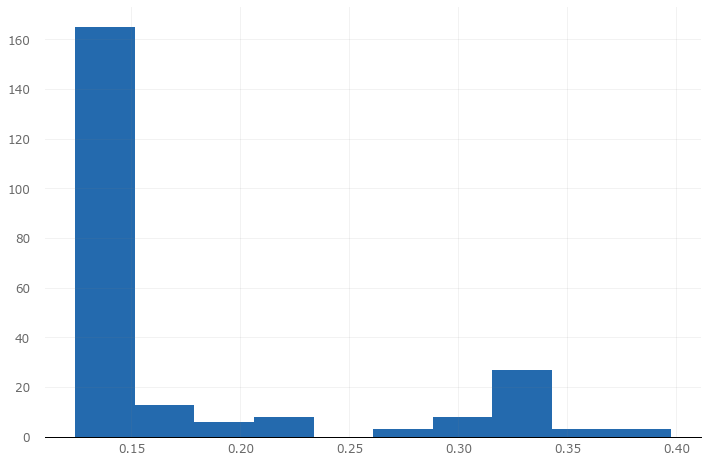

In [ ]:
report.plot_hist('val_loss')

As we can see, most of the results returned with a low validation error. And using the correlations, we can see that the learning_rate had the most affect on the validation loss. It is a positive correlation, which means the greater the learning rate is, the more the loss is.

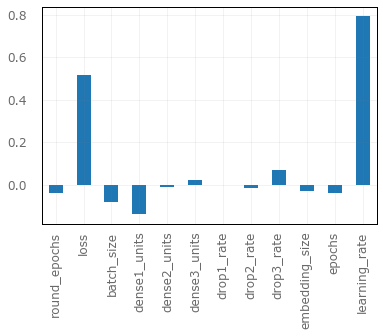

In [ ]:
report.correlate('val_loss', []).plot(kind= 'bar')

In [ ]:
report.table('val_loss').sort_values('val_loss', ascending= True)

,batch_size,dense1_units,dense2_units,learning_rate,round_epochs,epochs,loss,val_loss,embedding_size,drop1_rate,drop3_rate,drop2_rate,dense3_units,activation_func
82,300,300,100,0.0001,200,200,0.213470,0.124081,50,0.4,0.10,0.3,20,relu
150,300,400,200,0.0010,50,50,0.176169,0.124415,70,0.4,0.05,0.3,20,relu
197,300,200,200,0.0001,200,200,0.213700,0.124613,70,0.4,0.10,0.5,20,relu
115,600,300,200,0.0010,200,200,0.137832,0.124782,50,0.3,0.05,0.4,50,tanh
101,600,200,100,0.0010,200,200,0.131632,0.124817,30,0.5,0.10,0.3,75,relu
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209,150,200,200,0.0500,50,50,0.345242,0.355654,30,0.5,0.05,0.3,20,sigmoid
97,600,300,200,0.0500,50,50,0.346681,0.366692,30,0.4,0.10,0.4,50,sigmoid
143,600,300,50,0.0500,50,50,0.335190,0.373950,30,0.4,0.10,0.3,50,tanh
231,150,200,100,0.0500,100,100,0.361547,0.379118,50,0.4,0.20,0.5,75,tanh


The following are the best parameters with the minimum validation loss.*

In [ ]:
best_params = report.table('val_loss').sort_values(['val_loss'], ascending= True).head(1)
best_params = best_params.drop(['val_loss', 'loss', 'round_epochs'], axis= 1).to_dict('records')[0]
best_params

{'batch_size': 300,
 'dense1_units': 300,
 'dense2_units': 100,
 'learning_rate': 0.0001,
 'epochs': 200,
 'embedding_size': 50,
 'drop1_rate': 0.4,
 'drop3_rate': 0.1,
 'drop2_rate': 0.3,
 'dense3_units': 20,
 'activation_func': 'relu'}

Now we will use these paramaters, and train a neural network and evaluate it on the unseen data.

In [ ]:
# We will combine the previous training and validation data to use it as training data
input_X_train_all = [X_train.drop('neighbourhood', axis= 1).append(X_val.drop('neighbourhood', axis= 1)),
                     X_train['neighbourhood'].append(X_val['neighbourhood'])]
y_train_all = y_train.append(y_val)

In [ ]:
history, model = mlp_nn(input_X_train_all, y_train_all, input_X_test, y_test, best_params)

Train on 36717 samples, validate on 9180 samples
Epoch 1/200
36717/36717 [==============================] - 1s 28us/step - loss: 13.5478 - val_loss: 4.2519
Epoch 2/200
36717/36717 [==============================] - 1s 18us/step - loss: 2.3738 - val_loss: 0.8151
Epoch 3/200
36717/36717 [==============================] - 1s 18us/step - loss: 1.4081 - val_loss: 0.4864
Epoch 4/200
36717/36717 [==============================] - 1s 17us/step - loss: 1.1927 - val_loss: 0.3496
Epoch 5/200
36717/36717 [==============================] - 1s 18us/step - loss: 1.0740 - val_loss: 0.2802
Epoch 6/200
36717/36717 [==============================] - 1s 19us/step - loss: 1.0105 - val_loss: 0.2367
Epoch 7/200
36717/36717 [==============================] - 1s 19us/step - loss: 0.9437 - val_loss: 0.2163
Epoch 8/200
36717/36717 [==============================] - 1s 19us/step - loss: 0.8973 - val_loss: 0.2029
Epoch 9/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.8515 - val_loss: 0.1

36717/36717 [==============================] - 1s 19us/step - loss: 0.2545 - val_loss: 0.1261
Epoch 154/200
36717/36717 [==============================] - 1s 19us/step - loss: 0.2528 - val_loss: 0.1257
Epoch 155/200
36717/36717 [==============================] - 1s 17us/step - loss: 0.2497 - val_loss: 0.1269
Epoch 156/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.2518 - val_loss: 0.1253
Epoch 157/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.2509 - val_loss: 0.1253
Epoch 158/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.2483 - val_loss: 0.1251
Epoch 159/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.2473 - val_loss: 0.1270
Epoch 160/200
36717/36717 [==============================] - 1s 18us/step - loss: 0.2488 - val_loss: 0.1247
Epoch 161/200
36717/36717 [==============================] - 1s 19us/step - loss: 0.2489 - val_loss: 0.1267
Epoch 162/200
36717/36717 [===============

Let's see the performance of this model over epochs.*

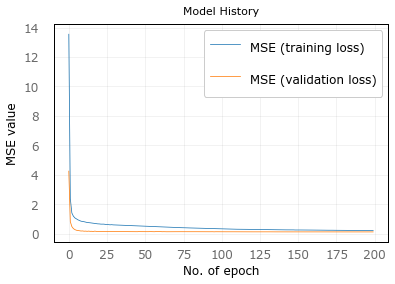

In [ ]:
# Plot history: MSE
plt.plot(history.history['loss'], label='MSE (training loss)')
plt.plot(history.history['val_loss'], label='MSE (validation loss)')
plt.title('Model History')
plt.ylabel('MSE value')
plt.xlabel('No. of epoch')
plt.legend(loc="upper right")
plt.show()

The model is not overfitting and the losses stabilises at 100 epochs. Let's calculate the RMSE for the model.

In [ ]:
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())

In [ ]:
predictions = model.predict(input_X_test)
nn_rmse = rmse(predictions, y_test.values)
print('RMSE:', nn_rmse)

RMSE: 0.7271955765037139


In [ ]:
layer_output = pd.DataFrame(model.get_layer('neighbourhood_embedded').get_weights()[0])

In [ ]:
layer_output

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.041793,0.023818,-0.011770,-0.058246,0.017627,0.000879,0.074680,0.015390,-0.010905,0.046329,...,0.010070,-0.058358,-0.027128,0.047460,0.008963,-0.018379,-0.011897,-0.018361,0.007698,0.002733
1,-0.021168,-0.020759,-0.011627,0.021879,0.072406,-0.019431,0.012989,-0.059050,-0.052588,-0.020341,...,0.081937,-0.027343,-0.031548,0.034186,-0.017132,-0.023863,0.062434,0.053043,-0.014531,0.033464
2,-0.004041,-0.001430,-0.055145,-0.038108,0.061026,0.041387,-0.017554,0.010768,-0.023111,0.039941,...,-0.001916,0.005132,0.003548,0.071321,0.047567,-0.015156,0.017917,0.057843,0.014873,-0.030384
3,0.051600,-0.015206,-0.048202,-0.106186,0.015277,0.038477,-0.040925,-0.023800,0.009798,-0.028938,...,0.023718,-0.000519,0.057438,0.012772,0.021401,-0.088736,-0.003790,0.008320,0.011692,-0.016174
4,0.005090,-0.008392,0.040783,-0.038881,0.024395,0.030821,-0.078560,-0.015086,0.015605,0.011075,...,-0.018946,0.062696,0.003595,0.021125,-0.015631,0.019483,0.028039,-0.019237,-0.003530,-0.016021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
215,-0.007802,-0.001580,-0.012989,-0.025267,-0.013564,-0.046106,-0.073934,0.056730,0.013038,0.003386,...,0.002323,-0.020133,0.056156,0.014954,-0.007573,-0.001552,0.015231,-0.023180,0.011674,-0.021109
216,-0.004471,0.064700,-0.026172,-0.001163,0.039995,-0.036256,0.035114,-0.037328,0.017942,0.065772,...,0.010738,-0.018768,0.040905,-0.002463,-0.057215,0.008312,0.032470,-0.013872,-0.059181,-0.035603
217,0.007583,0.041557,0.141286,0.122362,0.075133,-0.120771,-0.049857,-0.016794,0.010396,-0.008924,...,-0.030742,-0.053169,-0.074948,0.042346,0.006205,0.015226,0.103009,-0.012938,-0.100455,-0.026928
218,-0.007585,0.020492,0.035518,-0.027705,0.003501,-0.006641,0.002438,-0.015104,0.002812,0.037275,...,0.021817,-0.021776,0.067680,0.027985,0.023404,0.043063,0.048614,-0.025379,0.044432,0.003953


Now we are going to use these embedded vectors to map on to the data instead of the neighbourhood column.

In [ ]:
# We are going to remove the 0th row, which is reserved for unknowns
# Then we will reset the index and join with original data, removing the neighbourhood column

layer_output = layer_output.drop(0).reset_index(drop= True)
layer_output = layer_output.add_prefix('neighbourhood_')

X_train = X_train.append(X_val)
y_train = y_train.append(y_val)

X_train = X_train.merge(layer_output, how= 'left', left_on= 'neighbourhood', right_index= True).drop('neighbourhood', axis= 1)
X_test = X_test.merge(layer_output, how= 'left', left_on= 'neighbourhood', right_index= True).drop('neighbourhood', axis= 1)

In [ ]:
X_train.sample(5)

,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,adjectives_used,review_recency,room_type_Entire home/apt,room_type_Private room,room_type_Shared room,...,neighbourhood_40,neighbourhood_41,neighbourhood_42,neighbourhood_43,neighbourhood_44,neighbourhood_45,neighbourhood_46,neighbourhood_47,neighbourhood_48,neighbourhood_49
13142,-0.243902,-0.199587,2.773705,-0.118578,0.424658,1,1.0,0,1,0,...,-0.098787,0.027699,0.013644,0.007299,0.003448,-0.025081,-0.103794,-0.072876,0.043553,-0.038666
11431,-0.292250,0.916143,0.393101,-0.150599,0.791781,0,1.0,0,1,0,...,0.060950,0.062141,-0.026436,0.029265,-0.015845,0.068474,-0.011135,0.033297,-0.016798,0.095499
16581,-0.243902,-0.374604,-0.566522,-0.182621,0.000000,0,0.3,0,1,0,...,-0.019569,-0.005610,0.004767,-0.010900,0.028631,0.031826,0.051732,0.015473,0.068267,0.060919
23032,-0.292250,0.959897,0.959033,-0.182621,0.887671,1,1.0,1,0,0,...,0.025909,-0.035059,-0.026267,0.051129,0.002807,0.090021,-0.031767,0.010194,0.047525,0.048949
17289,-0.195554,-0.505866,-0.664945,-0.182621,0.008219,1,0.1,1,0,0,...,-0.039937,-0.018128,0.060925,0.020607,0.018344,-0.010926,-0.022008,-0.018903,-0.001923,-0.032536


The data is now ready to be used with other models.

## Random Forest Regressor

We will now use the Random Forest regressor using the Grid Search cross validation to tune the hyperparameters.*

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# Create a base model
rf = RandomForestRegressor()

# Create the parameter grid based on the results of random search
param_grid = {
    'max_depth': [80, 90, 100, 110],
    'max_features': ['auto', 'sqrt', 'log2'],
    'min_samples_split': [10, 15, 20],
    'n_estimators': [100,1000]
}

In [ ]:
from sklearn.model_selection import GridSearchCV

# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid,
                          cv = 5, n_jobs = -1, verbose = 3)


In [ ]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed: 14.5min
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed: 48.8min
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed: 123.4min
[Parallel(n_jobs=-1)]: Done 360 out of 360 | elapsed: 190.0min finished


GridSearchCV(cv=5, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=None,
                                             verbose=0, warm_start=False),
             iid='deprecated', n_jo

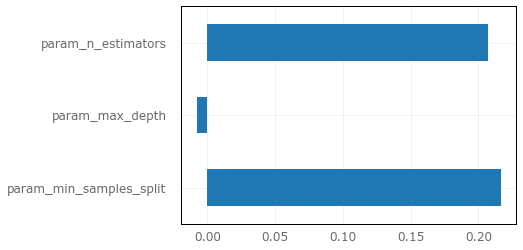

In [ ]:
corrs = pd.DataFrame(grid_search.cv_results_)[['param_min_samples_split', 'param_max_depth', 'param_n_estimators', 'mean_test_score']].apply(pd.to_numeric).corr()
corrs[['mean_test_score']].drop('mean_test_score').plot(kind= 'barh', legend= False)

The correlation plot shows how a larger value of parameter learning rate and number of estimators resulted in a larger loss. But the greater value of maximum depth resulted in a lower loss.

#### Feature Importances and Model Evaluation*

In [ ]:
best_model = grid_search.best_estimator_
best_model.feature_importances_

array([0.03887794, 0.03193904, 0.04602182, 0.03257877, 0.05582114,
       0.00572545, 0.01575426, 0.54450633, 0.00657657, 0.00668246,
       0.00471858, 0.00293288, 0.00594972, 0.00572591, 0.00214032,
       0.00507409, 0.00308467, 0.00315924, 0.00613928, 0.0047943 ,
       0.00562838, 0.00210545, 0.0022443 , 0.002848  , 0.00238046,
       0.00224597, 0.01212133, 0.00978707, 0.00383545, 0.00237038,
       0.00252205, 0.002158  , 0.00273903, 0.00246793, 0.00377555,
       0.00231555, 0.0117254 , 0.00251746, 0.00846677, 0.00144533,
       0.01175314, 0.00405647, 0.00500152, 0.00268876, 0.00244416,
       0.00258411, 0.00444788, 0.00414459, 0.00223667, 0.0033049 ,
       0.00924766, 0.00433573, 0.00285303, 0.00293889, 0.0115078 ,
       0.00281252, 0.00285718, 0.0022822 , 0.00169102, 0.00290912])

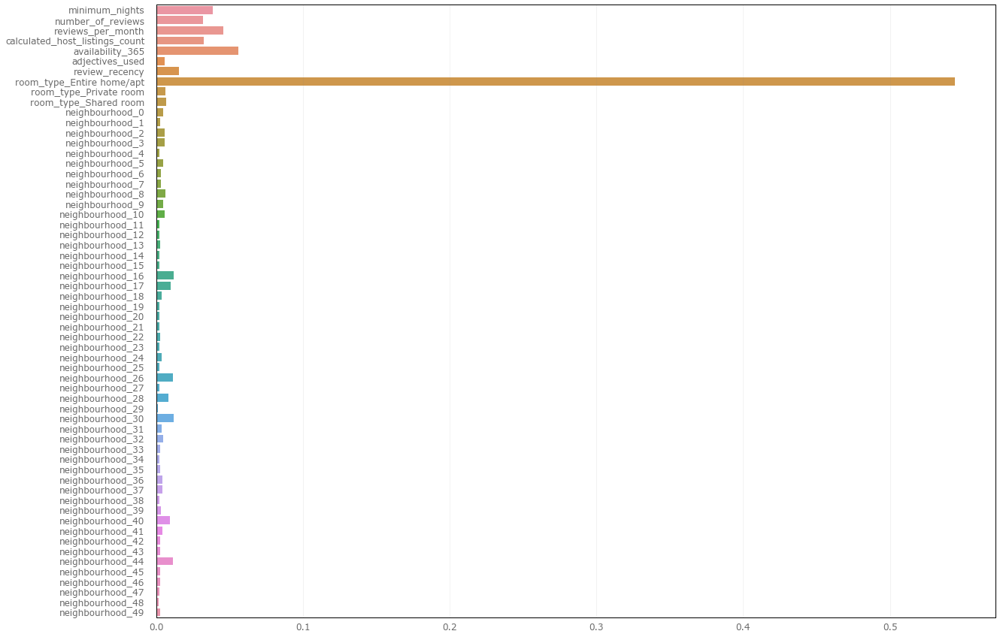

In [ ]:
plt.figure(figsize= (20,15))
sns.barplot(x= best_model.feature_importances_, y= X_train.columns)

Clearly, the random forest identifies the binary feature 'room_type_Entire home\apt' as a powerful predictor compared to others. The second best is 'availability_365' and after that 'reviews_per_month'.

Calculating the model's RMSE on test data.

In [ ]:
predictions = best_model.predict(X_test)
rf_rmse = rmse(predictions, y_test.values)
print('RMSE:', rf_rmse)

RMSE: 0.3446158423790647


## Gradient Boosted Regressor

We will now use the eXtreme Gradient Boosted regressor using the Grid Search cross validation to tune the hyperparameters.*

In [ ]:
from xgboost import XGBRegressor

# Create a base model
xgb = XGBRegressor(objective ='reg:squarederror')

# Create the parameter grid based on the results of random search
param_grid = {
    'max_depth': [80, 90, 100, 110],
    'learning_rate': [0.1, 0.01, 0.05],
    'n_estimators': [100,500]
}

In [ ]:
from sklearn.model_selection import GridSearchCV

# Instantiate the grid search model
grid_search = GridSearchCV(estimator = xgb, param_grid = param_grid,
                          cv = 5, n_jobs = -1, verbose = 2)

In [ ]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed: 11.7min
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed: 68.4min finished


GridSearchCV(cv=5, error_score=nan,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, gamma=None,
                                    gpu_id=None, importance_type='gain',
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n_estima...
                                    random_state=None, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                                    subsample=None, tree_method=None,
                                    validate_parameters=False, verbosity=No

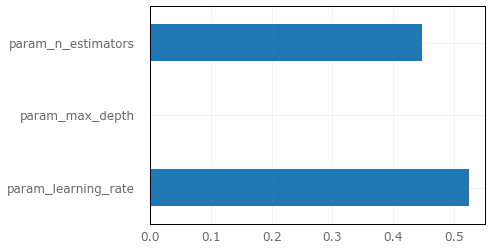

In [ ]:
corrs = pd.DataFrame(grid_search.cv_results_)[['param_learning_rate', 'param_max_depth', 'param_n_estimators', 'mean_test_score']].apply(pd.to_numeric).corr()
corrs[['mean_test_score']].drop('mean_test_score').plot(kind= 'barh', legend= False)

The correlation plot shows how a larger value of parameter learning rate and number of estimators resulted in a larger loss. The maximum depth parameter had a very minute effect on the loss.

In [ ]:
best_model = grid_search.best_estimator_

Calculating the model's RMSE on test data.

In [ ]:
predictions = best_model.predict(X_test)
gb_rmse = rmse(predictions, y_test.values)
print('RMSE:', gb_rmse)

RMSE: 0.36416449624919894


## Model Performance Comparison

Text(0.5, 1.0, 'Model Testing RMSE ')

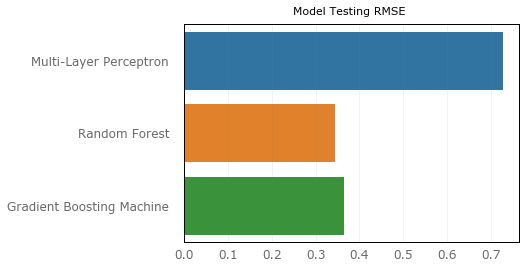

In [ ]:
sns.barplot(y= ['Multi-Layer Perceptron', 'Random Forest', 'Gradient Boosting Machine'],
            x= [nn_rmse, rf_rmse, gb_rmse]).set_title('Model Testing RMSE ')

Evidently, the Random Forest regressor outperforms Gradient Boosting Machine by a fine difference, but outperforms Multi-Layer Perceptron by a huge gap.

## Geo-Spatial Clustering

Now we will use unsupervised clustering method on geo-spatial data (Latitude and Longitude) to find out top 10 areas in New York City which have high amount of listings in the area.

### Density-based spatial clustering of applications with noise (DBSCAN) *

We will be loading the data again to extract the geo-location features from it.

In [ ]:
airdata_geo = pd.read_csv("AB_NYC_2019.csv")

In [ ]:
import folium # For plotting maps
from geopy.distance import great_circle
from shapely.geometry import MultiPoint
from sklearn.cluster import DBSCAN
import random

In [ ]:
def DBSCAN_Cluster(coords, epsilon, minSample, cols):
    coords = coords[cols].values
    db = DBSCAN(eps=epsilon, min_samples=minSample, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
    cluster_labels = db.labels_
    num_clusters = len(set(cluster_labels))
    clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
    centermost_points = clusters.map(get_centermost_point)
    centermost_points = centermost_points[~centermost_points.isnull()]
    lats, lons = zip(*centermost_points)
    rep_points = pd.DataFrame({'Lng':lons, 'Lat':lats})

    return db, rep_points, clusters

def get_centermost_point(cluster):
    if cluster.size <= 0:
        return
    centroid = (MultiPoint(cluster).centroid.x, MultiPoint(cluster).centroid.y)
    centermost_point = min(cluster, key=lambda point: great_circle(point, centroid).m)
    return tuple(centermost_point)

For clustering, we will only be needing latitude, longitude and the unique ID.

In [ ]:
geoData = airdata_geo[['id', 'latitude', 'longitude']].copy()
geoData = geoData.set_index('id')

In [ ]:
eps = 0.1/6371.0088   # KMs divided by Radius of Earth
model, centroids, clusters = DBSCAN_Cluster(geoData, eps, minSample= 15, cols= ['latitude', 'longitude'])

In [ ]:
geoData = geoData.reset_index()
geoData['Cluster'] = model.labels_

### Plotting the map

In [ ]:
def plotMap(coordsDF, col_Lat, col_Lng, centroids= None):

    # Map PLot For Clustered Points
    mapPlot = folium.Map(location=[40.729283, -73.889619], zoom_start = 11.25, max_zoom= 25)

    for index, coord in coordsDF.iterrows():
        folium.Circle([coord[col_Lat], coord[col_Lng]], color = coord['ColorHex'], radius= 5).add_to(mapPlot)

    if (centroids is not None):
        for index, coord in centroids.iterrows():
            popup = folium.Popup(coord['Stats'], max_width= 200, min_width= 200)
            folium.Marker([coord.Lat, coord.Lng], popup= popup).add_to(mapPlot)

    return mapPlot

def colorMapping(df):
    # For generating random colors per cluster

    def randomColorGenerator():
        return "#{:06x}".format(random.randint(0, 0xFFFFFF))

    cMap = pd.DataFrame()
    for i in df['Cluster'].unique():
        cMap = cMap.append(pd.Series({'Cluster' : i, 'ColorHex' : randomColorGenerator()}), ignore_index= True)

    cMap['Cluster'] = cMap['Cluster'].astype(int)

    return df.merge(cMap, how= 'left', on= 'Cluster')

We will only plot top 10 dense areas.*

In [ ]:
top10 = geoData.groupby('Cluster').size().sort_values(ascending= False)[1:].index.tolist()[:10]

In [ ]:
geoData = geoData[geoData['Cluster'].isin(top10)].copy()
centroids = centroids[centroids.index.isin(top10)].copy()
geoData = colorMapping(geoData)

In [ ]:
plotMap(geoData, col_Lat= 'latitude', col_Lng= 'longitude')

We can tune the minimum samples which is the minimum number of samples to be identified as a cluster and epsilon which is basically the distance between points (we converted in to KMs since we assigned the distance metric to be haversine to calculate distance between points) and we can visually analyze the clusters. For now, the cluster configuration seems good because it seems to be capturing the main areas of New York City.

Now we will calculate the metrics that we need to observe for the clustered areas and plot the statistics on centroids using interactive markers.*

In [ ]:
geoData = geoData.merge(airdata_geo[['id', 'price', 'room_type', 'number_of_reviews', 'availability_365', 'minimum_nights']],
                       on= 'id')

In [ ]:
def mapStats(points, centroid):

    def stats2String(sdt, col):
        return '{' + str(int(sdt.loc['min'][col])) + ', ' + str(int(sdt.loc['max'][col])) + ', ' \
                   + str(int(sdt.loc['mean'][col])) + ', ' + str(int(sdt.loc['50%'][col])) + '}'


    for cluster_id in centroid.index:

        p = points[points['Cluster'].isin([cluster_id])].describe(include= 'all')

        base = 'Cluster_ID: ' + str(cluster_id) + '<br>'
        count = 'Number of Listings: ' + str(int(p.loc['count']['id'])) + '<br>'
        stats = 'Summary: {Min, Max, Mean, Median}<br>' \
                + 'Price: ' + stats2String(p, 'price') + '<br>' \
                + '# of Reviews: ' + stats2String(p, 'number_of_reviews') + '<br>' \
                + 'Min Nights: ' + stats2String(p, 'minimum_nights') + '<br>' \
                + 'Availabity 365: ' + stats2String(p, 'availability_365') + '<br>' \
                + 'Common Room Type: ' + p.loc['top']['room_type']

        centroid.loc[centroid.index == cluster_id, 'Stats'] = base + count + stats

    return centroid


In [ ]:
geoData.head()

,id,latitude,longitude,Cluster,ColorHex,price,room_type,number_of_reviews,availability_365,minimum_nights
0,3647,40.80902,-73.94190,0,#18fc3a,150,Private room,0,365,3
1,3831,40.68514,-73.95976,1,#f585b1,89,Entire home/apt,270,194,1
2,5022,40.79851,-73.94399,0,#18fc3a,80,Entire home/apt,9,0,10
3,5099,40.74767,-73.97500,2,#4fa2e6,200,Entire home/apt,74,129,3
4,5121,40.68688,-73.95596,1,#f585b1,60,Private room,49,0,45


We will create popup markers to display information about clusters. So we need to convert the information to a single string so that we can pass it to the popup object.

In [ ]:
centroids = mapStats(geoData, centroids)

Let's plot the map again. Try clicking on the markers to see the statistics!*

In [ ]:
plotMap(geoData, col_Lat= 'latitude', col_Lng= 'longitude', centroids= centroids)